# PUMP run analysis

In [ ]:
%matplotlib inline

import dask
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import seawater as sw
import xarray as xr
#import xmitgcm

import hvplot.xarray

import dcpy
import facetgrid
import pump

mpl.rcParams['savefig.dpi'] = 300
mpl.rcParams['savefig.bbox'] = 'tight'
mpl.rcParams['figure.dpi'] = 120

xr.set_options(keep_attrs=True)

In [ ]:
cluster, client = pump.utils.build_cluster()
cluster.adapt(minimum=2, maximum=24, wait_count=600)
cluster

In [ ]:
sst = pump.read_sst()

tao = pump.read_tao()

johnson = pump.read_johnson()

oscar = pump.read_oscar()

adcp = pump.read_tao_adcp().load()
adcp['shear'] = np.hypot(adcp.u.differentiate('depth'), 
                         adcp.v.differentiate('depth'))

/gpfs/u/home/dcherian/python/xarray/xarray/backends/api.py:783: FutureWarning: In xarray version 0.13 `auto_combine` will be deprecated.
  coords=coords)
/gpfs/u/home/dcherian/python/xarray/xarray/backends/api.py:783: FutureWarning: The datasets supplied have global dimension coordinates. You may want
to use the new `combine_by_coords` function (or the
`combine='by_coords'` option to `open_mfdataset` to order the datasets
before concatenation. Alternatively, to continue concatenating based
on the order the datasets are supplied in in future, please use the
new `combine_nested` function (or the `combine='nested'` option to
open_mfdataset).
  coords=coords)
/gpfs/u/home/dcherian/python/xarray/xarray/backends/api.py:783: FutureWarning: In xarray version 0.13 `auto_combine` will be deprecated.
  coords=coords)
/gpfs/u/home/dcherian/python/xarray/xarray/backends/api.py:783: FutureWarning: The datasets supplied have global dimension coordinates. You may want
to use the new `combine_by_coords

## Heat budget stuff

In [ ]:
cluster.scale(12)

## read data

In [ ]:
cluster.scale(9)

In [ ]:
hifreq = [gcm1, gcm10]

In [ ]:
gcm1 = pump.model('../glade/TPOS_MITgcm_1_hb/HOLD/', 
                  name='gcm1', full=True, budget=False)

/glade/u/home/dcherian/pump/pump/model/model.py:61: FutureWarning: In xarray version 0.13 the default behaviour of `open_mfdataset`
will change. To retain the existing behavior, pass
combine='nested'. To use future default behavior, pass
combine='by_coords'. See
http://xarray.pydata.org/en/stable/combining.html#combining-multi

  self.dirname + "/obs_subset/annual-mean*.nc"
/gpfs/u/home/dcherian/python/xarray/xarray/backends/api.py:931: FutureWarning: The datasets supplied have global dimension coordinates. You may want
to use the new `combine_by_coords` function (or the
`combine='by_coords'` option to `open_mfdataset`) to order the datasets
before concatenation. Alternatively, to continue concatenating based
on the order the datasets are supplied in future, please use the new
`combine_nested` function (or the `combine='nested'` option to
open_mfdataset).The datasets supplied require both concatenation and merging. From
xarray version 0.13 this will operation will require either using 

Reading all files took 57.3901789188385 seconds


/glade/u/home/dcherian/pump/pump/model/model.py:276: FutureWarning: In xarray version 0.13 the default behaviour of `open_mfdataset`
will change. To retain the existing behavior, pass
combine='nested'. To use future default behavior, pass
combine='by_coords'. See
http://xarray.pydata.org/en/stable/combining.html#combining-multi

  self.tao = xr.open_mfdataset(self.dirname + "/obs_subset/tao-*extract.nc")
/gpfs/u/home/dcherian/python/xarray/xarray/backends/api.py:931: FutureWarning: The datasets supplied have global dimension coordinates. You may want
to use the new `combine_by_coords` function (or the
`combine='by_coords'` option to `open_mfdataset`) to order the datasets
before concatenation. Alternatively, to continue concatenating based
on the order the datasets are supplied in future, please use the new
`combine_nested` function (or the `combine='nested'` option to
open_mfdataset).The datasets supplied require both concatenation and merging. From
xarray version 0.13 this will opera

In [ ]:
gcm10 = pump.model('../glade/TPOS_MITgcm_10_hb/HOLD/', 
                  name='gcm10', full=True, budget=False)

/gpfs/u/home/dcherian/python/xarray/xarray/backends/api.py:783: FutureWarning: In xarray version 0.13 `auto_combine` will be deprecated.
  coords=coords)
/gpfs/u/home/dcherian/python/xarray/xarray/backends/api.py:783: FutureWarning: The datasets supplied have global dimension coordinates. You may want
to use the new `combine_by_coords` function (or the
`combine='by_coords'` option to `open_mfdataset` to order the datasets
before concatenation. Alternatively, to continue concatenating based
on the order the datasets are supplied in in future, please use the
new `combine_nested` function (or the `combine='nested'` option to
open_mfdataset).
  coords=coords)


Reading all files took 89.59963274002075 seconds


/gpfs/u/home/dcherian/python/xarray/xarray/backends/api.py:783: FutureWarning: In xarray version 0.13 `auto_combine` will be deprecated.
  coords=coords)
/gpfs/u/home/dcherian/python/xarray/xarray/backends/api.py:783: FutureWarning: Also `open_mfdataset` will no longer accept a `concat_dim` argument.
To get equivalent behaviour from now on please use the new
`combine_nested` function instead (or the `combine='nested'` option to
`open_mfdataset`).The datasets supplied have global dimension coordinates. You may want
to use the new `combine_by_coords` function (or the
`combine='by_coords'` option to `open_mfdataset` to order the datasets
before concatenation. Alternatively, to continue concatenating based
on the order the datasets are supplied in in future, please use the
new `combine_nested` function (or the `combine='nested'` option to
open_mfdataset).
  coords=coords)


In [ ]:
gcm1.tao.load()

<xarray.Dataset>
Dimensions:          (depth: 284, latitude: 7, longitude: 6, time: 2947)
Coordinates:
  * latitude         (latitude) float64 -8.0 -5.0 -2.0 0.0 2.0 5.0 8.0
  * longitude        (longitude) float64 -170.0 -155.0 -140.0 ... -110.0 -95.0
  * depth            (depth) float32 -0.5 -1.5 -2.5 ... -458.8152 -479.7476
  * time             (time) datetime64[ns] 1995-09-01 ... 1997-01-04T12:00:00
Data variables:
    TOTTTEND         (time, depth, latitude, longitude) float32 -0.024368098 ... 0.0025818094
    ADVx_TH          (time, depth, latitude, longitude) float32 -30994.732 ... 50547.816
    ADVy_TH          (time, depth, latitude, longitude) float32 -10328.398 ... 10820.97
    ADVr_TH          (time, depth, latitude, longitude) float32 nan nan ... nan
    DFrI_TH          (time, depth, latitude, longitude) float32 nan ... -4.753581
    KPPg_TH          (time, depth, latitude, longitude) float32 nan nan ... nan
    WTHMASS          (time, depth, latitude, longitude) float32 

## seasonal median Ri [1m]

In [ ]:
gcm1.full = pump.calc_reduced_shear(gcm1.full)

In [ ]:
gcm1.full = gcm1.full.chunk({'depth': 1*50, 'latitude': 1*69, 'longitude': 1*215})

In [ ]:
subset = (gcm1.full.sel(latitude=slice(-5,5))
          .sel(depth=slice(20, -120))
         [['u', 'Ri']])
subset.nbytes/1e9

848.736030856

In [ ]:
mean_Ri = (subset.Ri
           .where(subset.u < 0.8)
           .groupby('time.season')
           .mean('time'))

In [ ]:
computed = mean_Ri.persist()

In [ ]:
persisted.nbytes/1e9

0.576

In [ ]:
gcm1.full.sel(longitude=-140, method='nearest')

<xarray.Dataset>
Dimensions:          (depth: 345, latitude: 480, time: 2947)
Coordinates:
  * latitude         (latitude) float32 -12.0 -11.949896 ... 11.949896 12.0
    longitude        float32 -139.97998
  * depth            (depth) float32 -0.5 -1.5 -2.5 ... -5665.922 -5765.922
  * time             (time) datetime64[ns] 1995-09-01 ... 1997-01-04T12:00:00
Data variables:
    theta            (time, depth, latitude) float32 dask.array<shape=(2947, 345, 480), chunksize=(1, 50, 69)>
    u                (time, depth, latitude) float32 dask.array<shape=(2947, 345, 480), chunksize=(1, 50, 69)>
    v                (time, depth, latitude) float32 dask.array<shape=(2947, 345, 480), chunksize=(1, 50, 69)>
    w                (time, depth, latitude) float32 dask.array<shape=(2947, 345, 480), chunksize=(1, 50, 69)>
    salt             (time, depth, latitude) float32 dask.array<shape=(2947, 345, 480), chunksize=(1, 50, 69)>
    KPP_diffusivity  (time, depth, latitude) float32 dask.array<shap

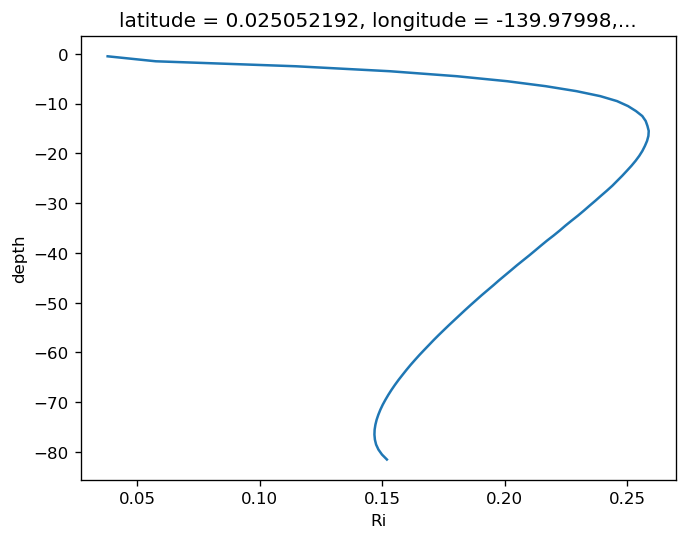

In [ ]:
subset = (gcm1.full
 .sel(depth=slice(0, -120))
 .sel(latitude=0, longitude=-140, method='nearest')
 .isel(time=1)).load()

(subset.Ri.where(subset.u < 0.8)
 .plot(y='depth'))

In [ ]:
def dask_median_wrapper(da, dim):
    axis = da.get_axis_num(dim)
    
    median = darray.apply_along_axis(func1d=dask.array.percentile, 
                                     axis=axis,
                                     arr=da.data,
                                     q=50,
                                     method='tdigest')
    
    return median

median = dask_median_wrapper(upper.Ri.isel(time=0), dim='depth')

In [ ]:
upper = upper.chunk({'depth': 120})
upper

<xarray.Dataset>
Dimensions:          (depth: 120, latitude: 480, longitude: 1500, time: 2947)
Coordinates:
  * latitude         (latitude) float32 -12.0 -11.949896 ... 11.949896 12.0
  * longitude        (longitude) float32 -170.0 -169.94997 ... -95.05003 -95.0
  * depth            (depth) float32 -0.5 -1.5 -2.5 ... -117.5 -118.5 -119.5
  * time             (time) datetime64[ns] 1995-09-01 ... 1997-01-04T12:00:00
Data variables:
    theta            (time, depth, latitude, longitude) float32 dask.array<shape=(2947, 120, 480, 1500), chunksize=(1, 120, 69, 215)>
    u                (time, depth, latitude, longitude) float32 dask.array<shape=(2947, 120, 480, 1500), chunksize=(1, 120, 69, 215)>
    v                (time, depth, latitude, longitude) float32 dask.array<shape=(2947, 120, 480, 1500), chunksize=(1, 120, 69, 215)>
    w                (time, depth, latitude, longitude) float32 dask.array<shape=(2947, 120, 480, 1500), chunksize=(1, 120, 69, 215)>
    salt             (time, de

In [ ]:
dask.array.map_blocks?

In [ ]:
subset = upper.Ri.isel(time=0).sel(latitude=0, method='nearest')
subset

<xarray.DataArray 'Ri' (depth: 120, longitude: 1500)>
dask.array<shape=(120, 1500), dtype=float32, chunksize=(120, 215)>
Coordinates:
    latitude   float32 0.025052192
  * longitude  (longitude) float32 -170.0 -169.94997 ... -95.05003 -95.0
  * depth      (depth) float32 -0.5 -1.5 -2.5 -3.5 ... -117.5 -118.5 -119.5
    time       datetime64[ns] 1995-09-01
Attributes:
    long_name:  Ri
    units:      s$^{-2}$

In [ ]:
import dask.array as dask_array

def dask_percentile(arr, dim, q=95):
    axis = arr.get_axis_num(dim)
    
    if len(arr.chunks[axis]) > 1:
        msg = ('Input array cannot be chunked along the percentile '
               'dimension.')
        raise ValueError(msg)
    prc = dask_array.map_blocks(np.percentile, arr, axis=axis, q=q,
                                drop_axis=axis)
    return prc

reduced = (upper.isel(latitude=slice(0,69*2), longitude=slice(0, 215*2))
           .Ri.isel(time=slice(0, 10))
           .groupby('time.month')
           .apply(dask_percentile, dim='depth', q=50, shortcut=True))

In [ ]:
subset = (upper.isel(latitude=slice(0,69*2), longitude=slice(0, 215*2))
           .Ri.isel(time=slice(0, 10)))
subset

<xarray.DataArray 'Ri' (time: 10, depth: 120, latitude: 138, longitude: 430)>
dask.array<shape=(10, 120, 138, 430), dtype=float32, chunksize=(1, 120, 69, 215)>
Coordinates:
  * latitude   (latitude) float32 -12.0 -11.949896 ... -5.185804 -5.1356993
  * longitude  (longitude) float32 -170.0 -169.94997 ... -148.58572 -148.53569
  * depth      (depth) float32 -0.5 -1.5 -2.5 -3.5 ... -117.5 -118.5 -119.5
  * time       (time) datetime64[ns] 1995-09-01 ... 1995-09-02T12:00:00
Attributes:
    long_name:  Ri
    units:      s$^{-2}$

In [ ]:
def xrmedian(da, dim):
    if type(dim) == str:
        in_dims = [dim]
    else:
        in_dims=dim
    applied = xr.apply_ufunc(np.nanmedian,
                             da,
                             input_core_dims=[in_dims],
                             output_dtypes=[float],
                             dask='parallelized',
                             vectorize=True)
    
    return applied
    
med2 = xrmedian(subset.isel(time=0),
                dim=['depth'])

In [ ]:
upper = pump.calc_reduced_shear(upper)

distributed.utils_perf - WARNING - full garbage collections took 15% CPU time recently (threshold: 10%)


In [ ]:
grouped = upper.Ri.sel(latitude=slice(-5, 5)).groupby('time.season')

med = []
for label, gg in grouped:
    stacked = gg.stack(dict(zt=['depth', 'time']))

    med.append(xr.DataArray(
            dask.array.apply_along_axis(func1d=np.nanmedian,
                                        arr=stacked.data, 
                                        axis=-1),
            dims=['latitude', 'longitude'],
            coords={'latitude': stacked.coords['latitude'],
                    'longitude': stacked.coords['longitude']})
        .expand_dims(season=[label])
        .persist())

med

[<xarray.DataArray 'nanmedian-along-axis-b17e833f650ba641224695bcb0a6522e' (season: 1, latitude: 200, longitude: 1500)>
 dask.array<shape=(1, 200, 1500), dtype=float32, chunksize=(1, 67, 215)>
 Coordinates:
   * season     (season) <U3 'DJF'
   * latitude   (latitude) float32 -4.9853864 -4.9352818 ... 4.9352818 4.9853864
   * longitude  (longitude) float32 -170.0 -169.94997 ... -95.05003 -95.0,
 <xarray.DataArray 'nanmedian-along-axis-71f953317fcbac33260983544bfa1a3d' (season: 1, latitude: 200, longitude: 1500)>
 dask.array<shape=(1, 200, 1500), dtype=float32, chunksize=(1, 67, 215)>
 Coordinates:
   * season     (season) <U3 'JJA'
   * latitude   (latitude) float32 -4.9853864 -4.9352818 ... 4.9352818 4.9853864
   * longitude  (longitude) float32 -170.0 -169.94997 ... -95.05003 -95.0,
 <xarray.DataArray 'nanmedian-along-axis-595464b3495199fc6fe669ae1b58dc2f' (season: 1, latitude: 200, longitude: 1500)>
 dask.array<shape=(1, 200, 1500), dtype=float32, chunksize=(1, 67, 215)>
 Coordinate

In [ ]:
median_Ri = xr.concat(med, 'season')
median_Ri

# call persist for intermediate results?
#    so maybe persist the calculation for each group?
# and then load at the end

<xarray.DataArray (season: 4, latitude: 200, longitude: 1500)>
dask.array<shape=(4, 200, 1500), dtype=float32, chunksize=(1, 67, 215)>
Coordinates:
  * latitude   (latitude) float32 -4.9853864 -4.9352818 ... 4.9352818 4.9853864
  * longitude  (longitude) float32 -170.0 -169.94997 ... -95.05003 -95.0
  * season     (season) object 'DJF' 'JJA' 'MAM' 'SON'

In [ ]:
median_Ri.load()

distributed.utils_perf - WARNING - full garbage collections took 17% CPU time recently (threshold: 10%)


KeyboardInterrupt: 

In [ ]:
import scipy.stats

air = xr.tutorial.open_dataset('air_temperature')

def _mode(*args, **kwargs):
    vals = scipy.stats.mode(*args, **kwargs)
    # only return the mode (discard the count)
    return vals[0].squeeze()

def mode(obj, dim=None):
    # note: apply always moves core dimensions to the end
    # usually axis is simply -1 but scipy's mode function doesn't seem to like that
    # this means that this version will only work for DataArray's (not Datasets)
    assert isinstance(obj, xr.DataArray)
    axis = obj.ndim - 1
    return xr.apply_ufunc(_mode, obj,
                          input_core_dims=[[dim]],
                          kwargs={'axis': axis},
                          dask='parallelized')

mode(air.air, 'time')

<xarray.DataArray 'air' (lat: 25, lon: 53)>
array([[271.5    , 272.4    , 272.5    , ..., 248.     , 244.39   , 245.79999],
       [273.     , 272.69998, 272.9    , ..., 242.09999, 242.89   , 248.29999],
       [273.69998, 273.1    , 249.09999, ..., 240.79999, 245.79999, 253.29999],
       ...,
       [298.6    , 297.69998, 297.29   , ..., 297.79   , 296.29   , 295.79   ],
       [298.79   , 298.     , 297.29   , ..., 296.29   , 296.5    , 296.29   ],
       [298.69998, 298.79   , 298.19998, ..., 296.9    , 296.9    , 296.79   ]],
      dtype=float32)
Coordinates:
  * lat      (lat) float32 75.0 72.5 70.0 67.5 65.0 ... 25.0 22.5 20.0 17.5 15.0
  * lon      (lon) float32 200.0 202.5 205.0 207.5 ... 322.5 325.0 327.5 330.0

In [ ]:
upper = (gcm1.full.sel(depth=slice(0, -120)))
seasonal_mean_Ri = (upper.Ri).groupby('time.season').reduce(dask.array.percentile(50, method='tdigest'))
seasonal_mean_Ri

NotImplementedError: median is not yet implemented on dask arrays

In [ ]:
surface = (gcm1.full.isel(depth=0)
           .drop('KPP_diffusivity')
           .load())

In [ ]:
cluster.scale(2)

In [ ]:
surface.to_netcdf(gcm1.dirname + '/obs_subset/surface.nc')

In [ ]:
gcm10 = pump.model('../glade/TPOS_MITgcm_10_hb/HOLD/', 
                   name='gcm1', full=False, budget=False)

In [ ]:
gcm10.tao.load()

<xarray.Dataset>
Dimensions:          (depth: 38, latitude: 7, longitude: 6, time: 3276)
Coordinates:
  * longitude        (longitude) float64 -170.0 -155.0 -140.0 ... -110.0 -95.0
  * latitude         (latitude) float64 -8.0 -5.0 -2.0 0.0 2.0 5.0 8.0
  * depth            (depth) float32 -5.0 -15.0 -25.0 ... -462.379 -493.50504
  * time             (time) datetime64[ns] 1995-09-01 ... 1997-02-27T20:00:00
Data variables:
    theta            (time, depth, latitude, longitude) float32 28.956684 ... 7.7136817
    u                (time, depth, latitude, longitude) float32 -0.15222842 ... 0.011796668
    v                (time, depth, latitude, longitude) float32 -0.06786418 ... 0.0026388182
    w                (time, depth, latitude, longitude) float32 nan ... nan
    salt             (time, depth, latitude, longitude) float32 35.318863 ... 34.596455
    KPP_diffusivity  (time, depth, latitude, longitude) float32 nan ... 1e-05
    shear            (time, depth, latitude, longitude) float

In [ ]:
region = dict(
    longitude=[-170, -155, -140, -125, -110, -95],
    latitude=[-8, -5, -2, 0, 2, 5, 8],
    method='nearest')

# full_tao = hb.full.sel(depth=slice(0, -500)).sel(**region)
# budget_tao = hb.budget.sel(**region).sel(depth=slice(0, -500))

In [ ]:
import tqdm

N = 72
ds = hb.budget
subsets = []
i0 = 0
for idx0, idx1 in tqdm.tqdm(zip(range(i0, ds.sizes['time'], N), 
                                range(i0+N, ds.sizes['time'], N))):
    if (ds.sizes['time'] - idx1) < N:
        idx1 = ds.sizes['time']
        
    subsets.append(ds
                   .isel(time=slice(idx0, idx1))
                   .sel(depth=slice(0, -500))
                   .sel(**region)
                   .load())
    
concat = xr.concat(subsets, 'time')

40it [1:48:15, 292.83s/it]


In [ ]:
import glob
import xarray as xr
import subprocess
import tqdm

fnames = glob.glob(hb.dirname + '/Day_[2-3][0-9][0-9][0-9]_*.nc')


def process_file(ff):
    if 'corrupt' in ff:
        return None

    try:
        ds = xr.open_dataset(ff)
        for vv in [
                'latitude', 'longitude', 'depth', 'time', 'u', 'v', 'w',
                'theta', 'salt', 'KPP_diffusivity'
        ]:
            assert vv in ds.variables
            ds.load()
            ds.close()
        return None

    except (OSError, AssertionError, RuntimeError):
        if ds:
            ds.close()

        print(ff + '\n')
        subprocess.call(f'mv {ff} {ff[:-3]}_corrupt.nc', shell=True)
        return ff


tasks = [dask.delayed(process_file)(ff) for ff in fnames]
dask.compute(tasks)

In [ ]:
surface = xr.merge([gcm1.full.isel(depth=0), 
                    gcm1.budget.isel(depth=0)])

## TIW composites

/glade/u/home/dcherian/pump/pump/calc.py:280: UserWarning: Secondary peaks detected!
  warnings.warn('Secondary peaks detected!')
/gpfs/u/home/dcherian/python/xarray/xarray/core/nanops.py:159: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/matplotlib/colors.py:1028: RuntimeWarning: invalid value encountered in less_equal
  mask |= resdat <= 0


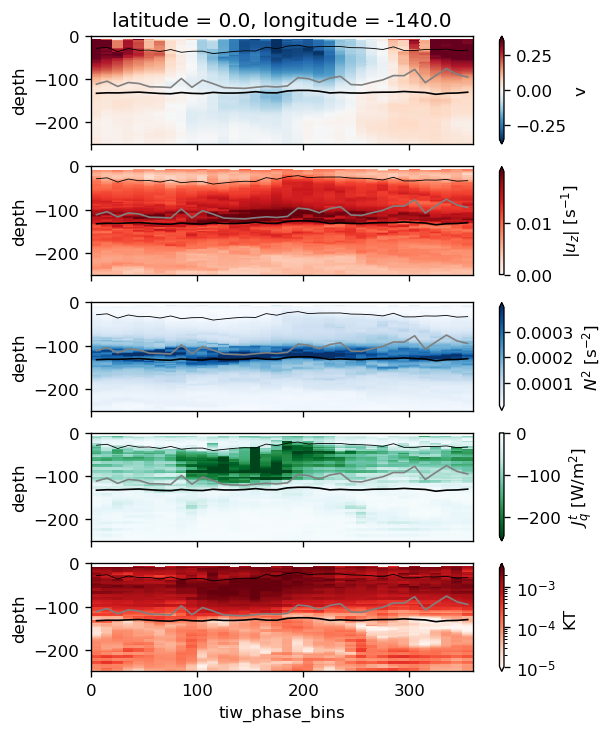

In [ ]:
def plot_tiw_composite(self, region=dict(latitude=0, longitude=-140)):  

    subset = self.tao.sel(**region)

    tiw_phase = self.get_tiw_phase(subset.v)
    subset = (subset.rename({'KPP_diffusivity': 'KT'})
              .where(subset.depth < subset.mld - 5))

    for vv in ['mld', 'dcl_base', 'euc_max']:
        subset[vv] = subset[vv].max('depth')

    phase_bins = np.arange(0, 365, 10)
    grouped = subset.groupby_bins(tiw_phase, bins=phase_bins)
    mean = grouped.mean('time')

    f, axx = plt.subplots(5, 1, sharex=True, sharey=True, 
                          constrained_layout=True,
                          gridspec_kw={'height_ratios': [1, 1, 1, 1, 1]})


    ax = dict(zip(['v', 'shear', 'N2', 'Jq', 'KT'], axx))

    cmaps = dict(v=mpl.cm.RdBu_r, shear=mpl.cm.Reds, N2=mpl.cm.Blues, Jq=mpl.cm.BuGn_r, KT=mpl.cm.Reds)
    for aa in ax:
        if aa == 'KT':
            kwargs = dict(norm=mpl.colors.LogNorm())
        elif aa == 'shear':
            kwargs=dict(vmin=0)
        elif aa == 'Jq':
            kwargs=dict(vmax=0)
        else:
            kwargs = dict()
        mean[aa].plot(ax=ax[aa], y='depth', 
                      cmap=cmaps[aa], robust=True, ylim=[-250, 0], **kwargs)
        pump.plot.plot_depths(mean, ax=ax[aa])
    
    for aa in axx[:-1]:
        aa.set_xlabel('')
    
    for aa in axx[1:]:
        aa.set_title('')

    f.set_size_inches((5, 6))

    
plot_tiw_composite(gcm1, dict(latitude=0, longitude=-140))

/glade/u/home/dcherian/pump/pump/calc.py:319: UserWarning: Secondary peaks detected!
  warnings.warn('Secondary peaks detected!')
/gpfs/u/home/dcherian/python/xarray/xarray/core/nanops.py:159: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


({'u': <matplotlib.collections.QuadMesh at 0x2aae58299128>,
  'v': <matplotlib.collections.QuadMesh at 0x2aae2d02b278>,
  'w': <matplotlib.collections.QuadMesh at 0x2aae634f7cf8>,
  'theta': <matplotlib.collections.QuadMesh at 0x2aadce763668>,
  'S2': <matplotlib.collections.QuadMesh at 0x2aae904cee48>,
  'N2': <matplotlib.collections.QuadMesh at 0x2aae1675ae48>,
  'Jq': <matplotlib.collections.QuadMesh at 0x2aae1675af98>,
  'Ri': <matplotlib.collections.QuadMesh at 0x2aae57f9e128>},
 {'u': <matplotlib.axes._subplots.AxesSubplot at 0x2aae306cbba8>,
  'v': <matplotlib.axes._subplots.AxesSubplot at 0x2aae164e63c8>,
  'w': <matplotlib.axes._subplots.AxesSubplot at 0x2aaebcc8a7b8>,
  'theta': <matplotlib.axes._subplots.AxesSubplot at 0x2aaf36e99518>,
  'S2': <matplotlib.axes._subplots.AxesSubplot at 0x2aae5e20fe48>,
  'N2': <matplotlib.axes._subplots.AxesSubplot at 0x2aae421acf98>,
  'Jq': <matplotlib.axes._subplots.AxesSubplot at 0x2aadcd56fa58>,
  'Ri': <matplotlib.axes._subplots.AxesSub

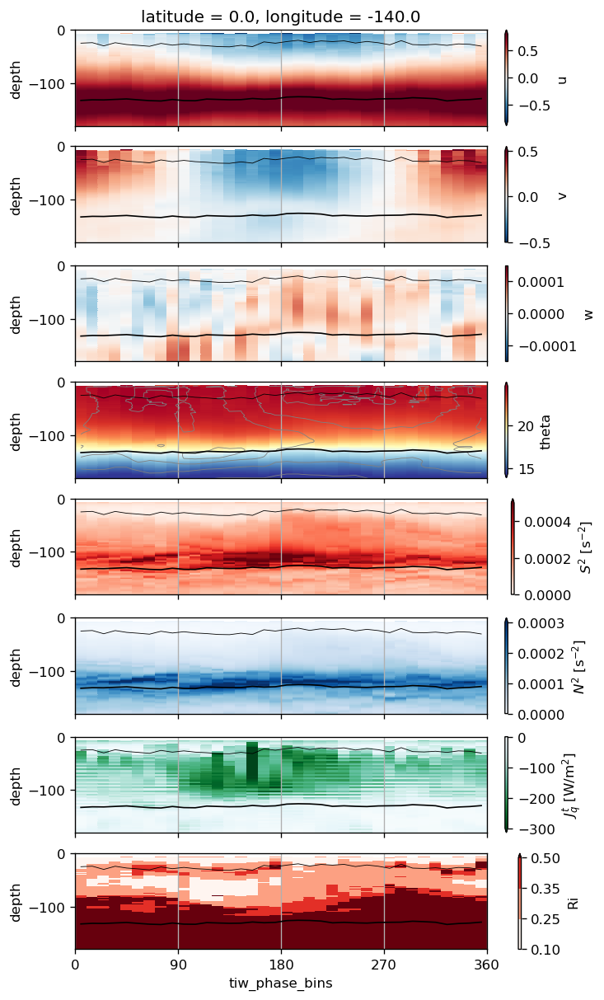

In [ ]:
gcm1.plot_tiw_composite(region=dict(latitude=0, longitude=-140))

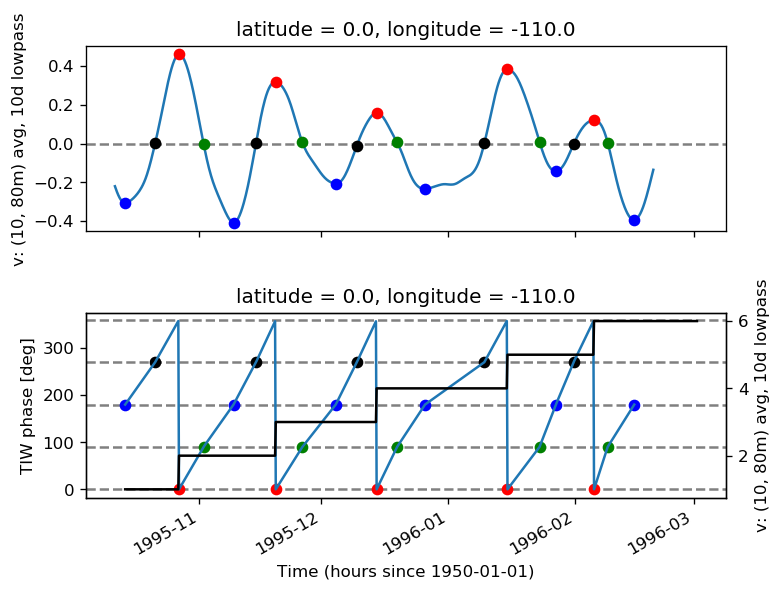

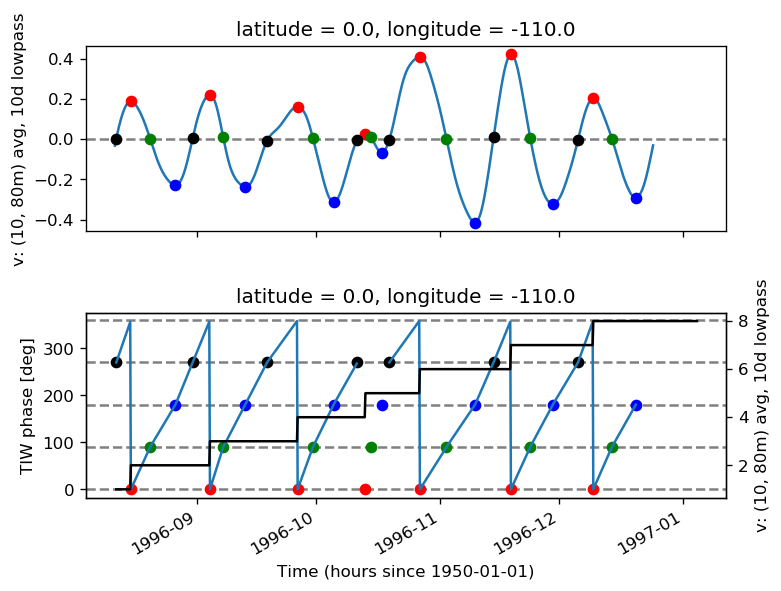

In [ ]:
%matplotlib inline

phase = gcm1.get_tiw_phase(gcm1.tao.sel(latitude=0, longitude=-110).v, debug=True)

## DCL + TIW =)

In [ ]:
gcm1.tao.load()

In [ ]:
subset = gcm1.tao.sel(latitude=0, longitude=-140)
subset

<xarray.Dataset>
Dimensions:          (depth: 284, time: 2947)
Coordinates:
    latitude         float64 0.0
    longitude        float64 -140.0
  * depth            (depth) float32 -0.5 -1.5 -2.5 ... -458.8152 -479.7476
  * time             (time) datetime64[ns] 1995-09-01 ... 1997-01-04T12:00:00
Data variables:
    TOTTTEND         (time, depth) float32 0.030905655 ... -0.084141254
    ADVx_TH          (time, depth) float32 -83881.48 -80416.46 ... 128859.82
    ADVy_TH          (time, depth) float32 77082.02 75620.234 ... -3945.285
    ADVr_TH          (time, depth) float32 nan -2530.304 ... 7004.4014 11718.812
    DFrI_TH          (time, depth) float32 nan -814.7646 ... -6.115341 -5.492482
    KPPg_TH          (time, depth) float32 nan nan nan nan ... nan nan nan nan
    WTHMASS          (time, depth) float32 -0.0001368456 ... 0.00037924113
    oceQnet          (time) float32 280.17267 -104.20074 ... -158.23448
    oceQsw           (time) float32 410.83234 1.1761105 0.0 ... 559.7758

In [ ]:
gcm1.plot_tiw_summary(gcm1.tao.sel(latitude=0, longitude=-125))

<xarray.Dataset>
Dimensions:          (depth: 284, latitude: 7, longitude: 6, time: 2947)
Coordinates:
  * latitude         (latitude) float64 -8.0 -5.0 -2.0 0.0 2.0 5.0 8.0
  * longitude        (longitude) float64 -170.0 -155.0 -140.0 ... -110.0 -95.0
  * depth            (depth) float32 -0.5 -1.5 -2.5 ... -458.8152 -479.7476
  * time             (time) datetime64[ns] 1995-09-01 ... 1997-01-04T12:00:00
Data variables:
    TOTTTEND         (time, depth, latitude, longitude) float32 -0.024368098 ... 0.0025818094
    ADVx_TH          (time, depth, latitude, longitude) float32 -30994.732 ... 50547.816
    ADVy_TH          (time, depth, latitude, longitude) float32 -10328.398 ... 10820.97
    ADVr_TH          (time, depth, latitude, longitude) float32 nan nan ... nan
    DFrI_TH          (time, depth, latitude, longitude) float32 nan ... -4.753581
    KPPg_TH          (time, depth, latitude, longitude) float32 nan nan ... nan
    WTHMASS          (time, depth, latitude, longitude) float32 

## interesting S2, N2 anomaly; TIW period 3 ; 0,140

In [ ]:
extract = (gcm1.full.sel(time=slice('1995-11-15', '1995-12-10'),
                         depth=slice(0, -200),
                         latitude=slice(-3, 3),
                         longitude=slice(-150, -130)))

extract.load()

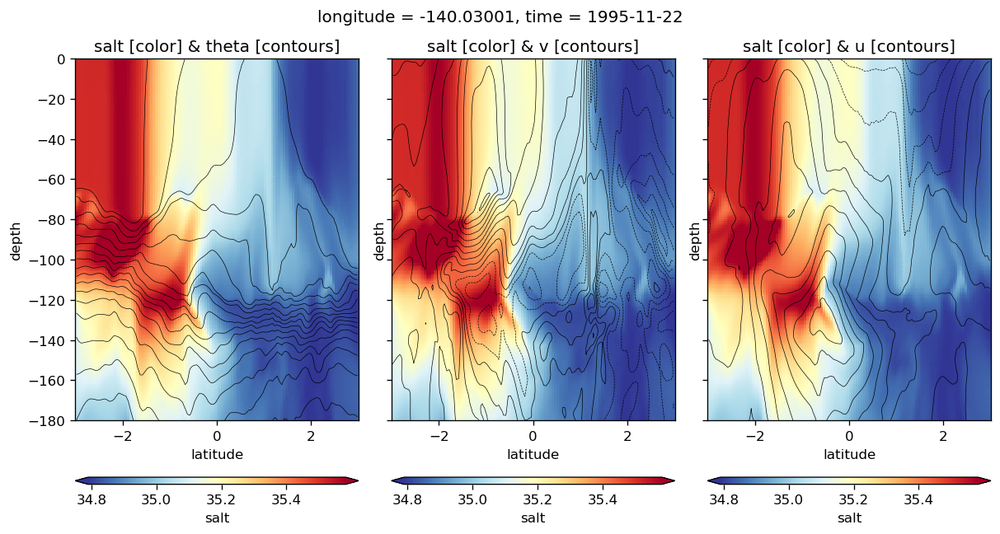

In [ ]:
%matplotlib inline

# extract = subset.where(subset.period == 5, drop=True).sel(depth=slice(-40, -150))

region = dict(time='1995-11-22 00:00', longitude=-140, method='nearest')

f, ax = plt.subplots(1, 3, sharex=True, sharey=True, constrained_layout=True)

for aa, vv in zip(ax, ['theta', 'v', 'u']):
    ((extract.salt
      .sel(**region))
      .plot(ax=aa, y='depth', cmap=mpl.cm.RdYlBu_r, robust=True,
            cbar_kwargs={'orientation': 'horizontal', 'aspect': 20}))

    (extract[vv].sel(**region)
     .plot.contour(ax=aa, levels=22, add_labels=False, y='depth', colors='k', linewidths=0.4))
    
    title = aa.get_title()
    aa.set_title(f'salt [color] & {vv} [contours]')
    aa.set_ylim([-180, 0])
    
f.suptitle(title, y=1.05)
f.set_size_inches((10, 5))

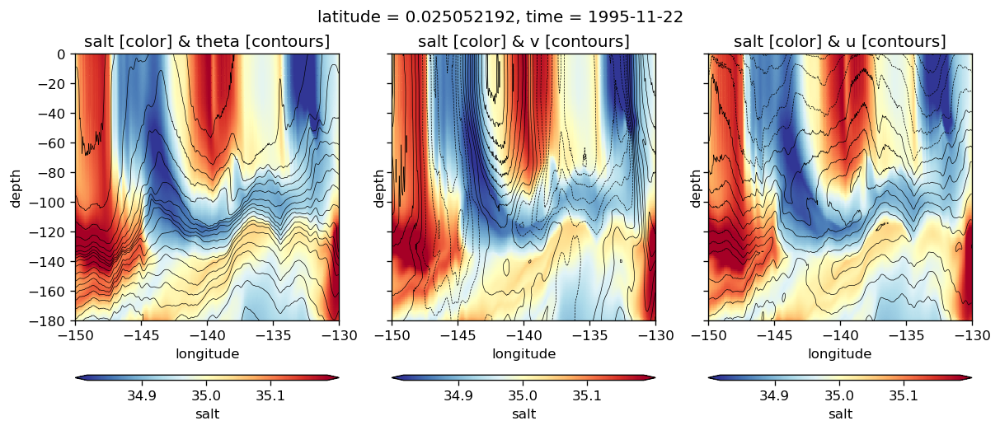

In [ ]:
region = dict(time='1995-11-22 00:00', latitude=0, method='nearest')

f, ax = plt.subplots(1, 3, sharex=True, sharey=True, constrained_layout=True)

for aa, vv in zip(ax, ['theta', 'v', 'u']):
    ((extract.salt
      .sel(**region))
      .plot(ax=aa, y='depth', cmap=mpl.cm.RdYlBu_r, robust=True,
            cbar_kwargs={'orientation': 'horizontal', 'aspect': 20}))

    (extract[vv].sel(**region)
     .plot.contour(ax=aa, levels=22, add_labels=False, y='depth', colors='k', linewidths=0.4))
    
    title = aa.get_title()
    aa.set_title(f'salt [color] & {vv} [contours]')
    aa.set_ylim([-180, 0])
    
f.suptitle(title, y=1.05)
f.set_size_inches((10, 4))

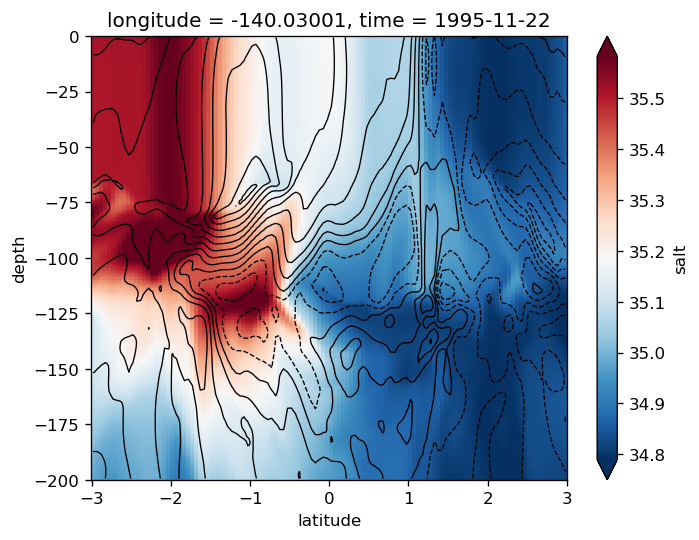

In [ ]:
region = dict(time='1995-11-22 00:00', longitude=-140, method='nearest')
((extract.salt
  .sel(**region))
 .plot(y='depth', cmap=mpl.cm.RdBu_r, robust=True))

(extract.v.sel(**region)
 .plot.contour(levels=20, y='depth', colors='k', linewidths=0.8))

In [ ]:
daily = (gcm1.surface.sel(time=slice('1995-11-20', '1995-11-30'))
         .resample(time='D').mean('time')
         .load())
daily

/gpfs/u/home/dcherian/python/xarray/xarray/core/nanops.py:159: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


<xarray.Dataset>
Dimensions:    (latitude: 480, longitude: 1500, time: 11)
Coordinates:
  * time       (time) datetime64[ns] 1995-11-20 1995-11-21 ... 1995-11-30
  * latitude   (latitude) float64 -12.0 -11.95 -11.9 -11.85 ... 11.9 11.95 12.0
  * longitude  (longitude) float64 -170.0 -169.9 -169.9 ... -95.1 -95.05 -95.0
    depth      float32 -0.5
Data variables:
    theta      (time, latitude, longitude) float32 28.984201 ... 27.569458
    u          (time, latitude, longitude) float32 -0.21500325 ... -0.0904541
    v          (time, latitude, longitude) float32 -0.062241707 ... 0.22636873
    w          (time, latitude, longitude) float32 nan nan nan ... nan nan nan
    salt       (time, latitude, longitude) float32 34.606567 ... 33.70195
Attributes:
    title:              daily snapshot from 1/20 degree Equatorial Pacific MI...
    easting:            longitude
    northing:           latitude
    field_julian_date:  400296
    julian_day_unit:    days since 1950-01-01 00:00:00

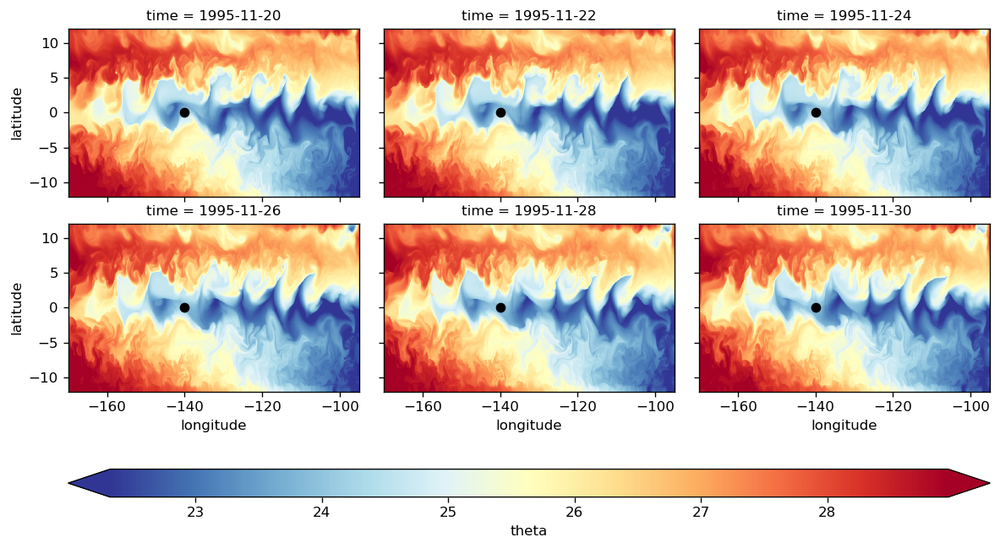

In [ ]:
fg = (daily.theta.isel(time=slice(None,None,2))
      .plot(x='longitude', col='time', col_wrap=3, robust=True, cmap=mpl.cm.RdYlBu_r,
            cbar_kwargs=dict(orientation='horizontal', aspect=30)))

fg.map(lambda: plt.gca().plot(-140, 0, 'ko', ms=6))

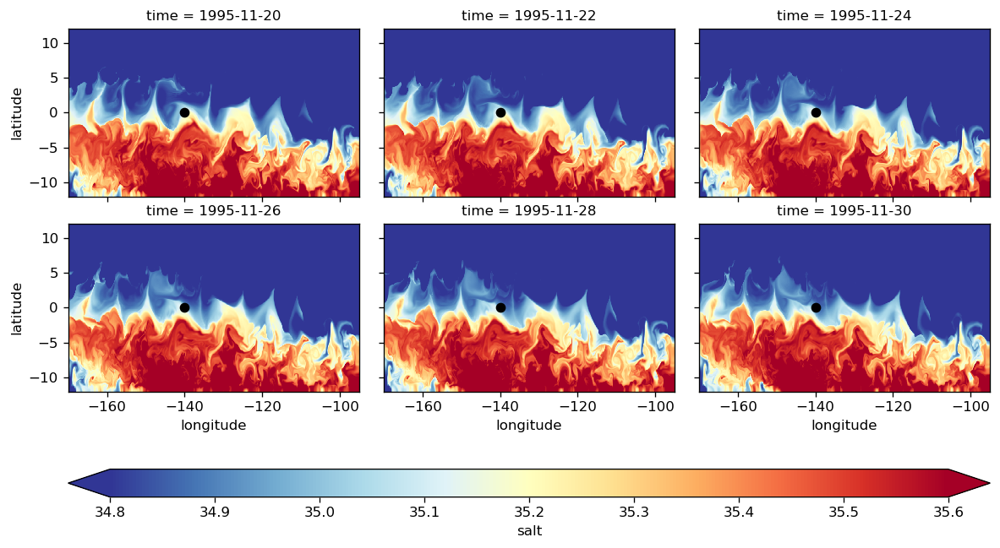

In [ ]:
fg = (daily.salt.isel(time=slice(None,None,2))
      .plot(x='longitude', col='time', col_wrap=3, vmin=34.8, vmax=35.6, cmap=mpl.cm.RdYlBu_r,
            cbar_kwargs=dict(orientation='horizontal', aspect=30)))

fg.map(lambda: plt.gca().plot(-140, 0, 'ko', ms=6))

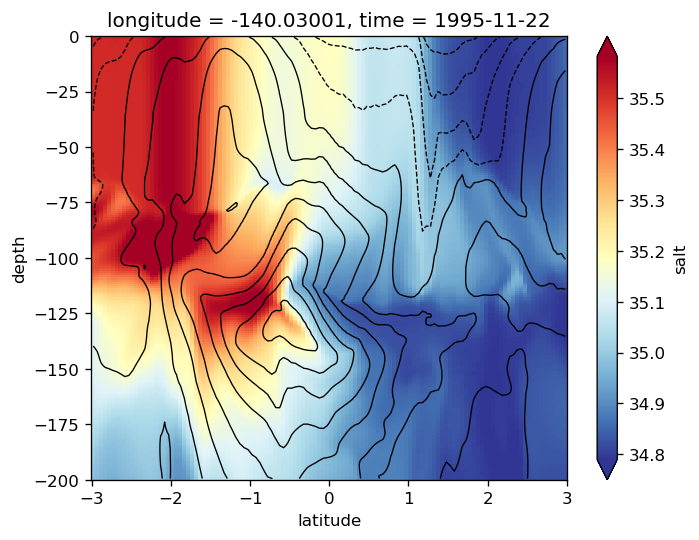

In [ ]:
region = dict(time='1995-11-22 00:00', longitude=-140, method='nearest')
((extract.salt
  .sel(**region))
 .plot(y='depth', cmap=mpl.cm.RdYlBu_r, robust=True))

(extract.u.sel(**region)
 .plot.contour(levels=20, y='depth', colors='k', linewidths=0.8))

## TIW periods: 0, -110


/gpfs/u/home/dcherian/python/xarray/xarray/core/nanops.py:159: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


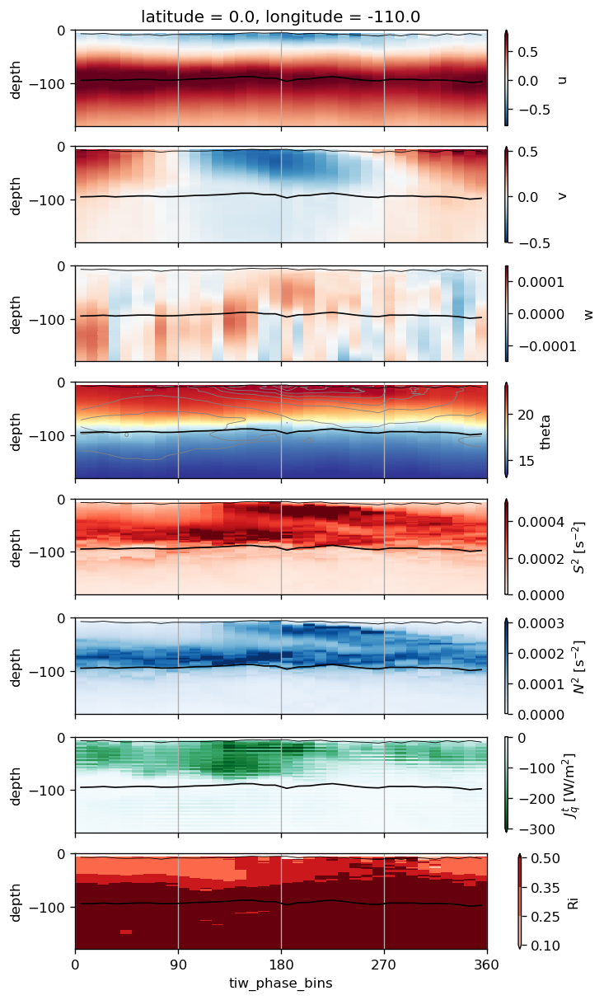

In [ ]:
gcm1.plot_tiw_composite(ds='tao', region=dict(latitude=0, longitude=-110),
                        x='phase')
plt.gcf().savefig('../images/gcm1-tiw-composite-0-110.png')

KeyboardInterrupt: 

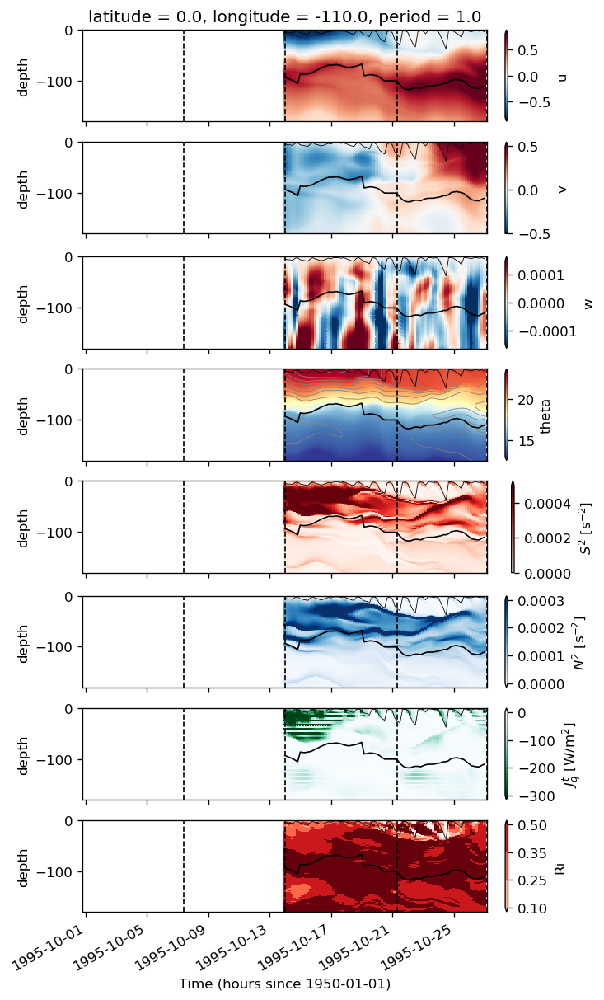

In [ ]:
gcm1.summarize_tiw_periods(gcm1.tao.sel(latitude=0, longitude=-110))

## TIW periods: 0, -125

In [ ]:
gcm1.plot_tiw_composite(ds='tao', region=dict(latitude=0, longitude=-125),
                        x='phase')
plt.gcf().savefig('../images/gcm1-tiw-composite-0-125.png')

## TIW periods: 0, -140

/glade/u/home/dcherian/pump/pump/calc.py:319: UserWarning: Secondary peaks detected!
  warnings.warn('Secondary peaks detected!')
/gpfs/u/home/dcherian/python/xarray/xarray/core/nanops.py:159: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


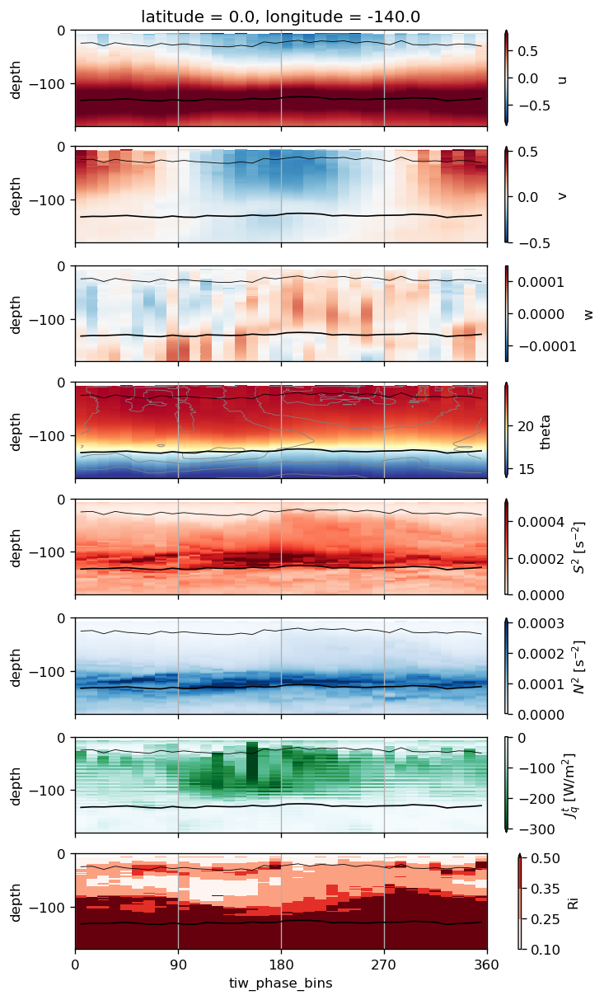

In [ ]:
gcm1.plot_tiw_composite(ds='tao', region=dict(latitude=0, longitude=-140),
                        x='phase')
plt.gcf().savefig('../images/gcm1-tiw-composite-0-140.png')

In [ ]:
subset = xr.merge([subset, pump.get_tiw_phase(subset.v)])

/glade/u/home/dcherian/pump/pump/calc.py:319: UserWarning: Secondary peaks detected!
  warnings.warn('Secondary peaks detected!')


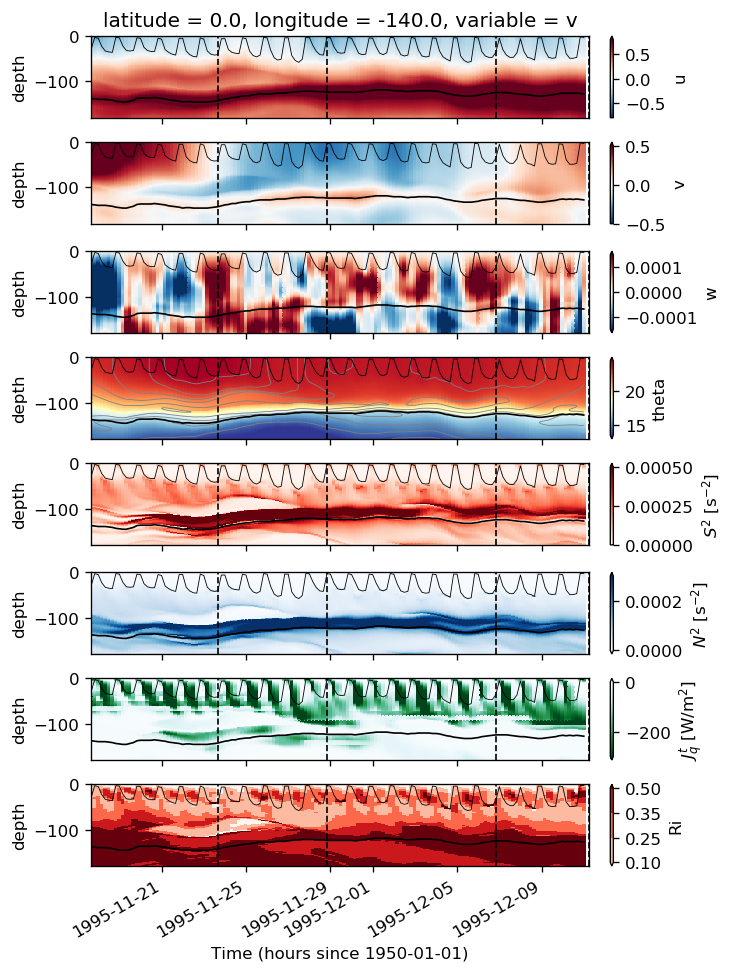

In [ ]:
gcm1.plot_tiw_summary(subset.where(subset.period == 5, drop=True),
                      normalize_period=True);

/glade/u/home/dcherian/pump/pump/calc.py:319: UserWarning: Secondary peaks detected!
  warnings.warn('Secondary peaks detected!')


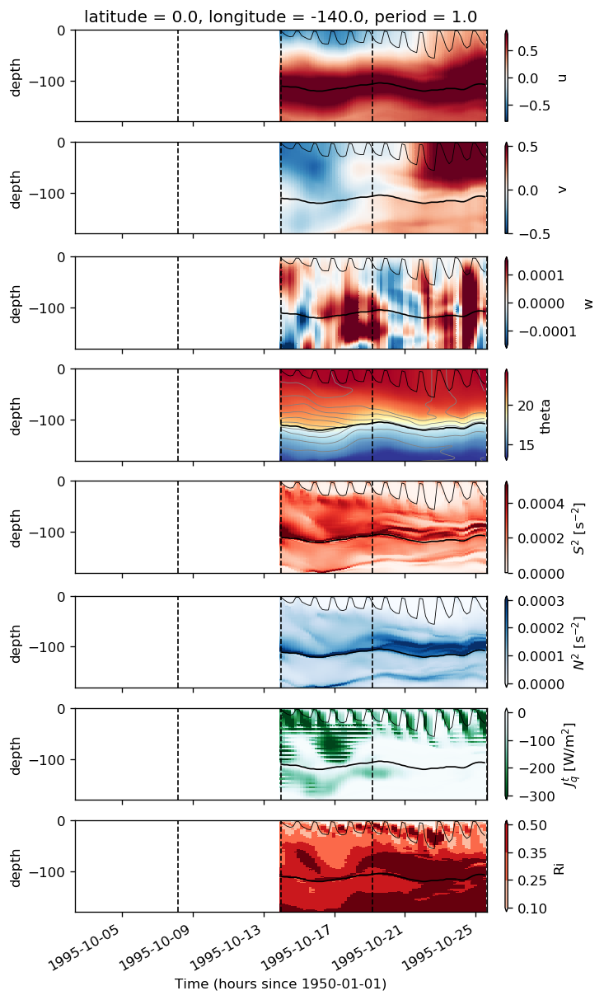

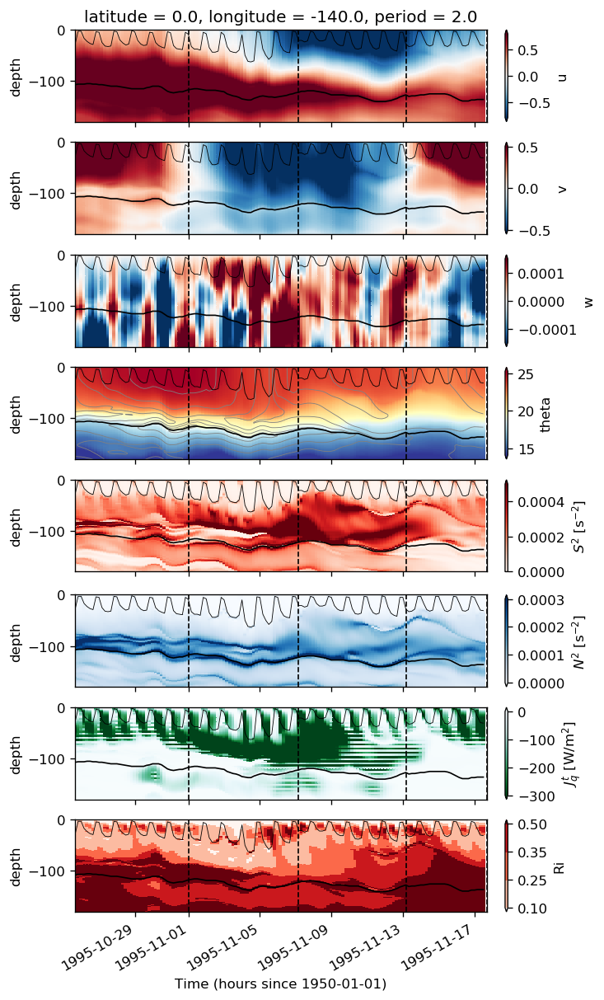

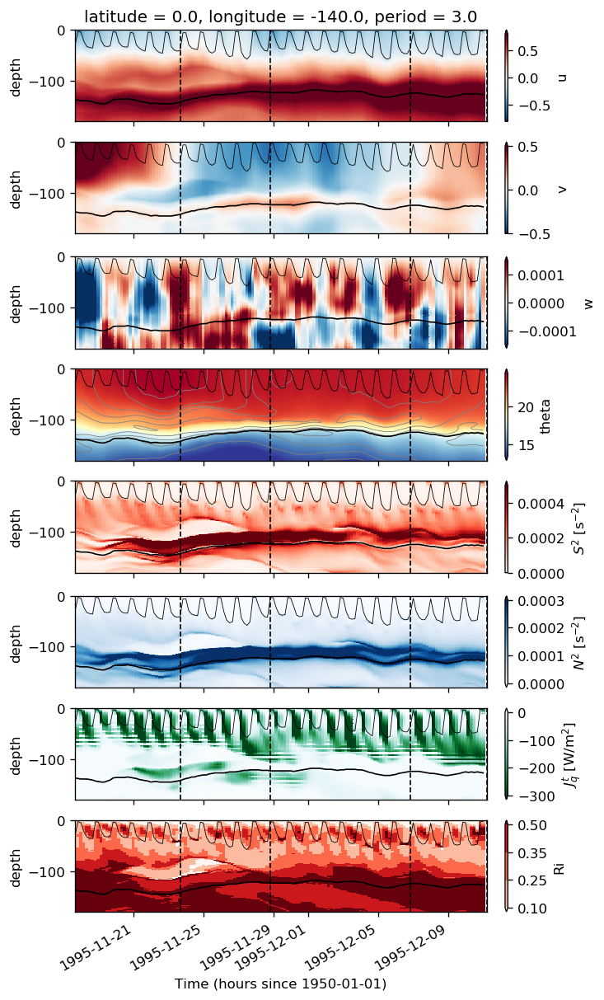

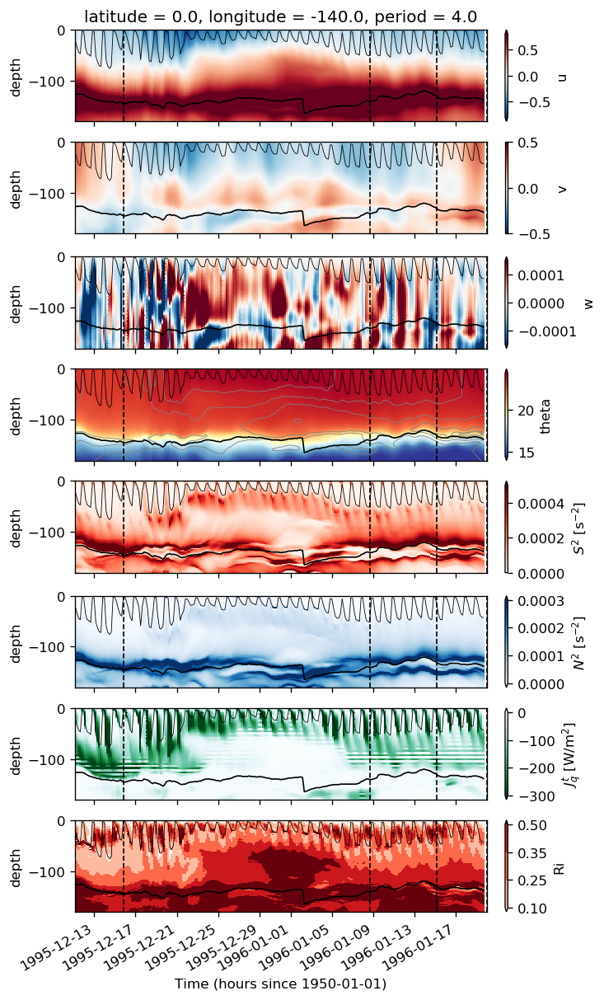

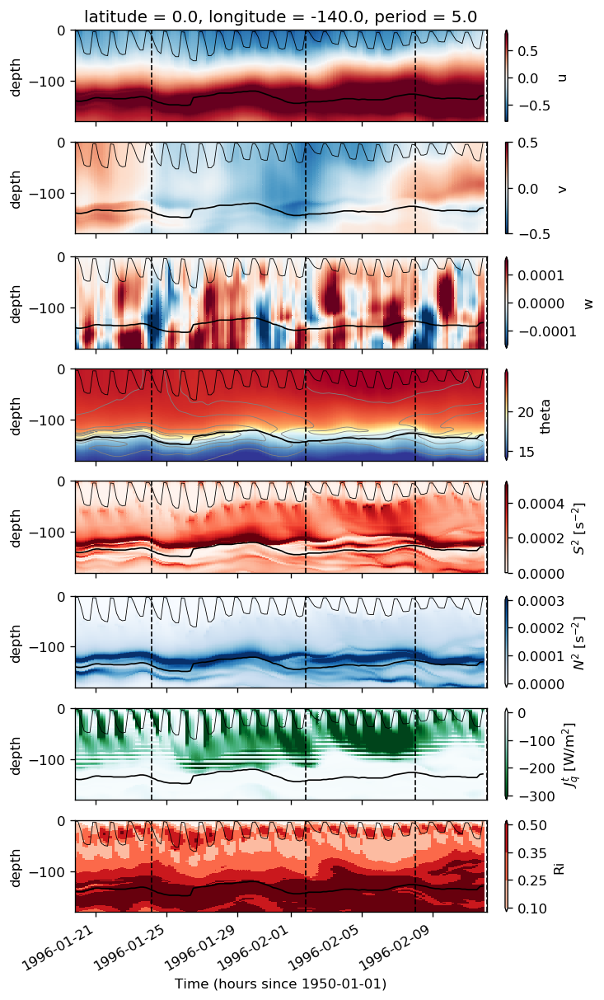

...

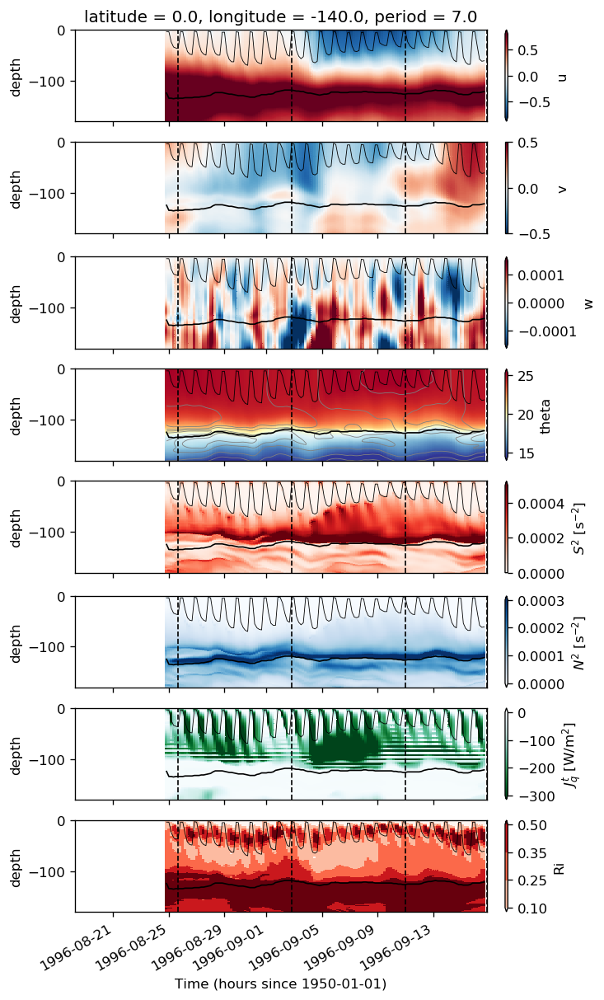

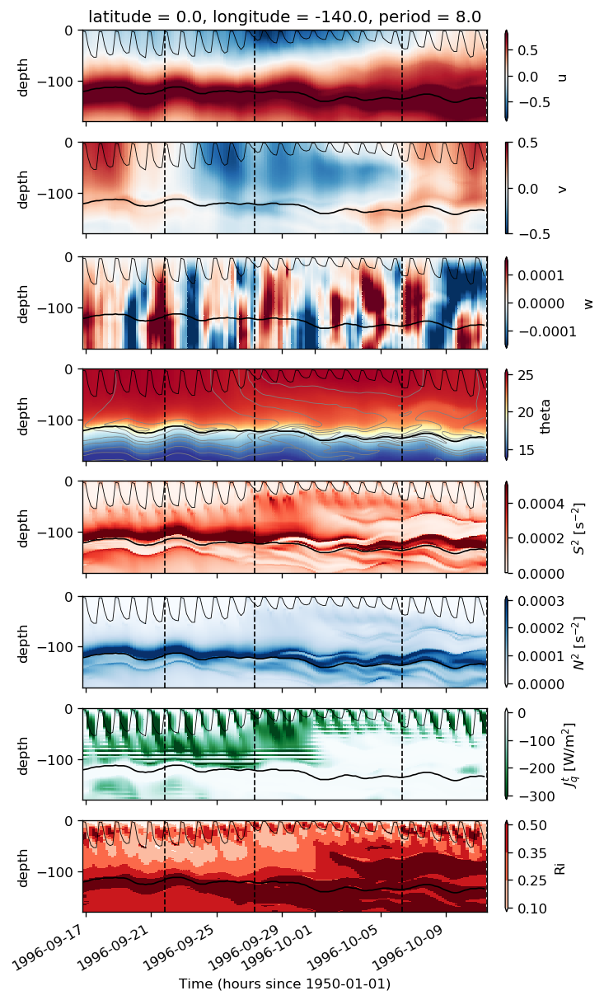

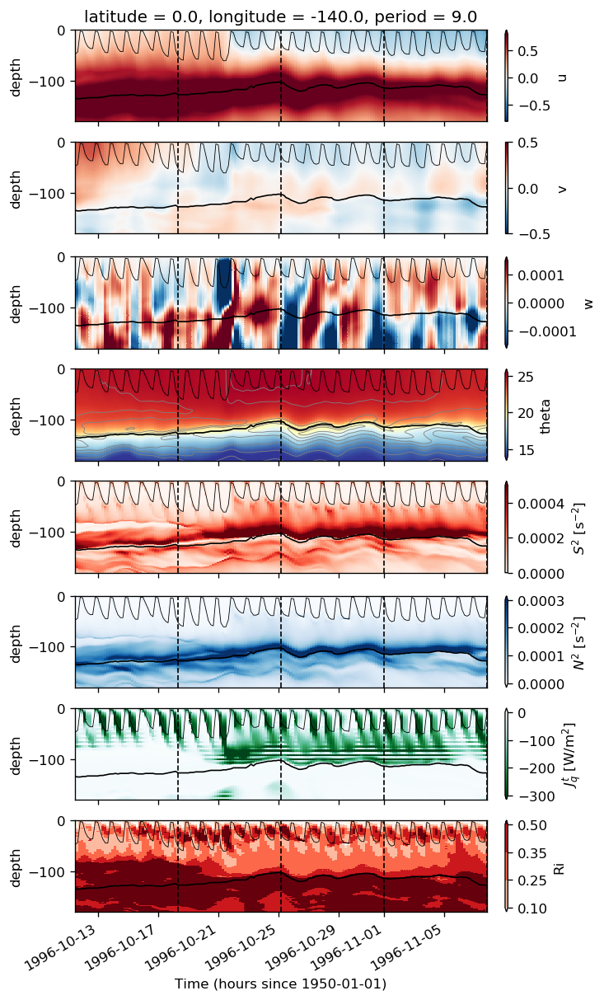

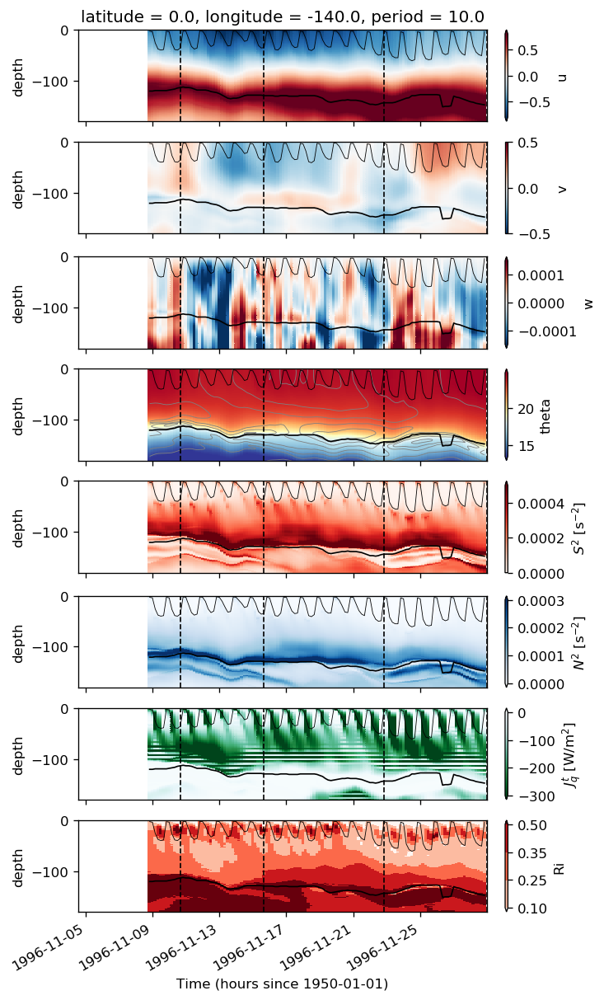

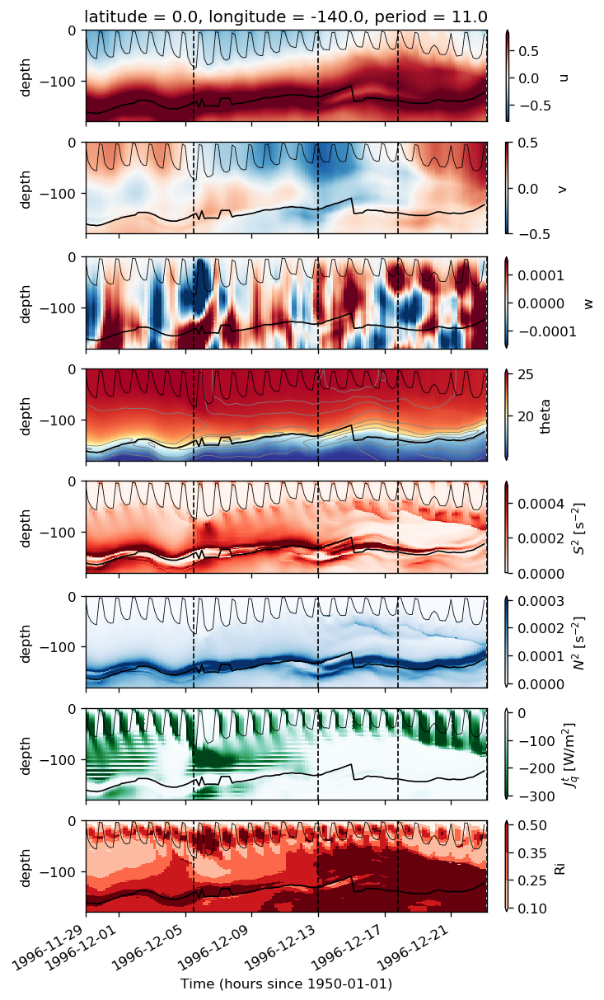

In [ ]:
gcm1.summarize_tiw_periods(gcm1.tao.sel(latitude=0, longitude=-140))

In [ ]:
(np.log10(subset.where(subset.period == 2, drop=True).KPP_diffusivity)
.sel(depth=slice(0, -100))
.plot(x='time', robust=True, cmap=mpl.cm.RdBu_r, 
     cbar_kwargs={'orientation': 'horizontal'}))

plt.gcf().set_size_inches((8,5))

dcl_base.interpolate_na('time').plot(color='k')

<IPython.core.display.Javascript object>


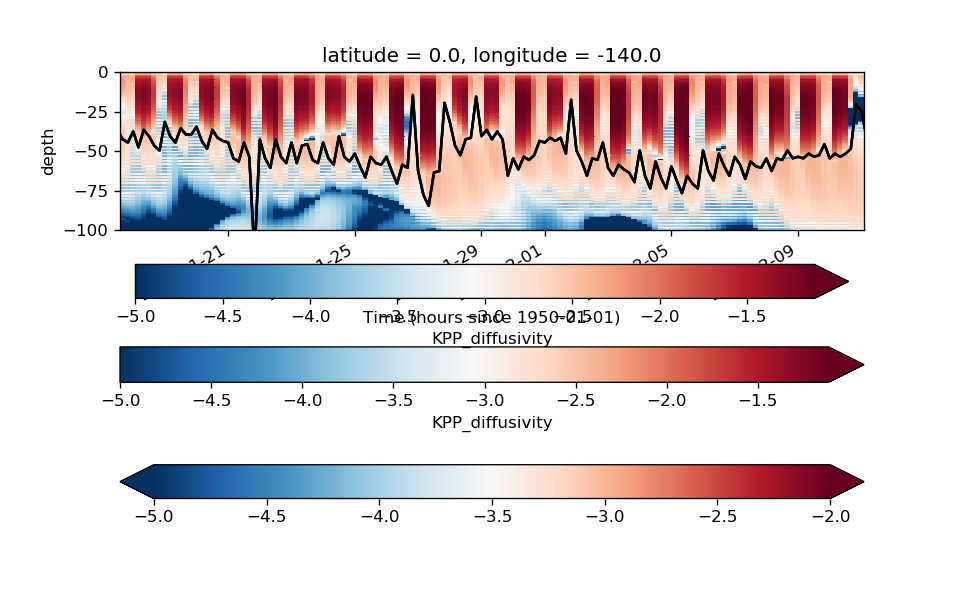

In [ ]:
%matplotlib notebook

dKdt = np.abs(subset.KPP_diffusivity
              .rolling(depth=2, min_periods=1).mean()
              .differentiate('time'))

dcl_base = (dKdt.depth
            .where(~np.isnan(dKdt
                            .where((dKdt.depth < dKdt.depth[dKdt.argmax('depth')]))
                            .where(dKdt > 5e-17)))
            .min('depth'))

period = subset.where(subset.period == 2, drop=True)
k = (np.log10(period.KPP_diffusivity)
     .rolling(depth=2, min_periods=1).mean()
    .sel(depth=slice(0, -150)))

(k
 .plot(x='time', robust=True, cmap=mpl.cm.RdBu_r, vmax=-2,
       cbar_kwargs={'orientation': 'horizontal'}))

d = (dcl_base
     .interpolate_na('time'))
(d.plot(x='time'))

#(np.log10(subset.KPP_diffusivity)
# .sel(depth=slice(0, -100))
# .plot.contour(x='time', levels=10, colors='k')
#)

<IPython.core.display.Javascript object>


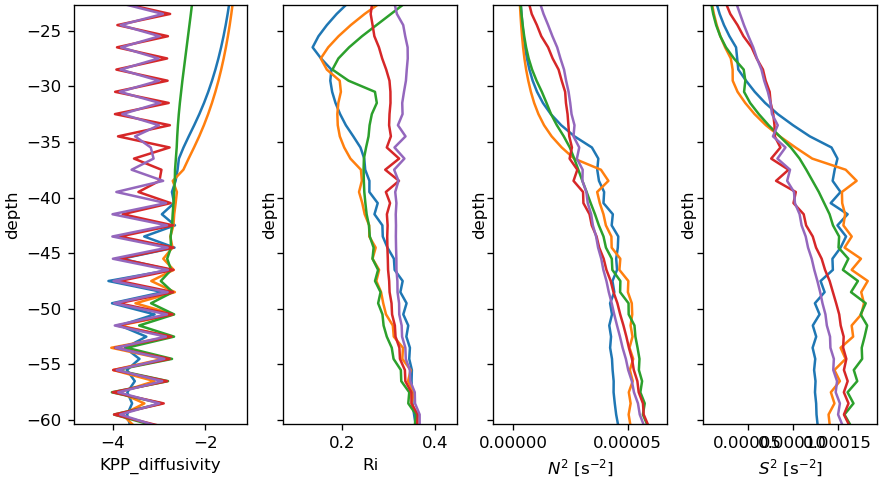

[Text(0.5, 1.0, ''),
 Text(0.5, 1.0, ''),
 Text(0.5, 1.0, ''),
 Text(0.5, 1.0, '')]

In [ ]:
f, ax = plt.subplots(1, 4, constrained_layout=True, sharey=True)

(np.log10(period.KPP_diffusivity)
.isel(time=slice(10, 15))
.plot.line(ax=ax[0], y='depth', hue='time', add_legend=False))

(period.Ri
.isel(time=slice(10, 15))
.plot.line(ax=ax[1], y='depth', hue='time', add_legend=False))

(period.N2
.isel(time=slice(10, 15))
.plot.line(ax=ax[2], y='depth', hue='time', add_legend=False))

(period.shear2
.isel(time=slice(10, 15))
.plot.line(ax=ax[3], y='depth', hue='time', add_legend=False))

ax[1].set_xlim([0, 1])
[aa.set_title('') for aa in ax]

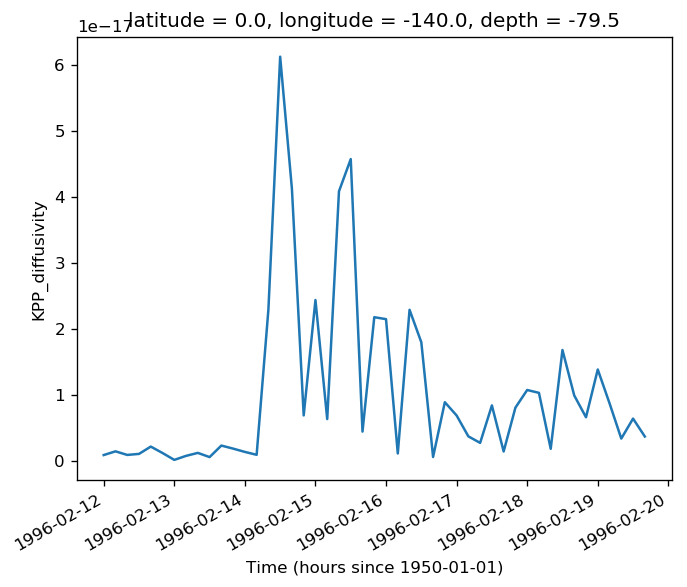

In [ ]:
dKdt.where(subset.period == 5, drop=True).sel(depth=-80, method='nearest').plot()

/gpfs/u/home/dcherian/python/xarray/xarray/core/computation.py:565: RuntimeWarning: divide by zero encountered in log10
  result_data = func(*input_data)


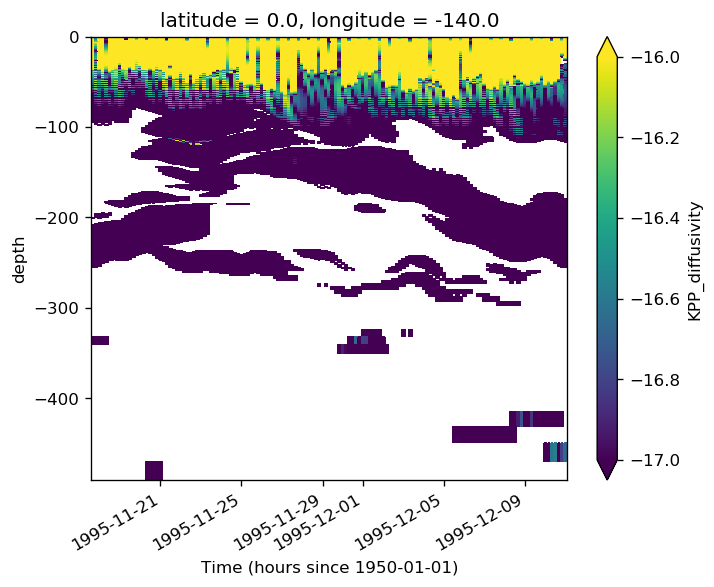

In [ ]:
np.log10(dKdt).where(subset.period == 2, drop=True).plot(x='time', vmax=-16, vmin=-17)

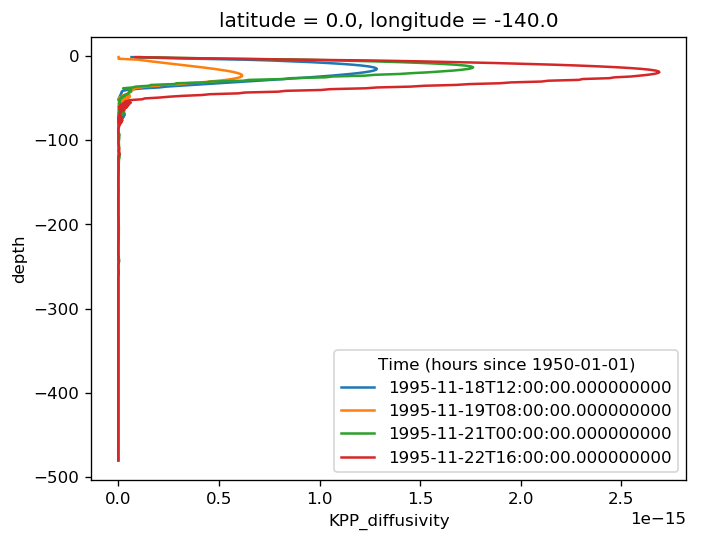

In [ ]:
(np.abs(subset.KPP_diffusivity
 .where(subset.period == 2, drop=True)
 .differentiate('time'))
 .isel(time=[5, 10 ,20 ,30])
 .plot.line(y='depth'))

dKdt = np.abs(subset.KPP_diffusivity.differentiate('time'))

dcl_base = (dKdt.depth
            .where(~np.isnan(dKdt
                            .where((dKdt.depth < dKdt.depth[dKdt.argmax('depth')]))
                            .where(dKdt > 1e-16)))
            .min('depth'))


#(dKdt.depth
# .where(~np.isnan(dKdt.where(dKdt > dKdtmax)
#                  .where(dKdt > 2e-16)))
# .max('depth')


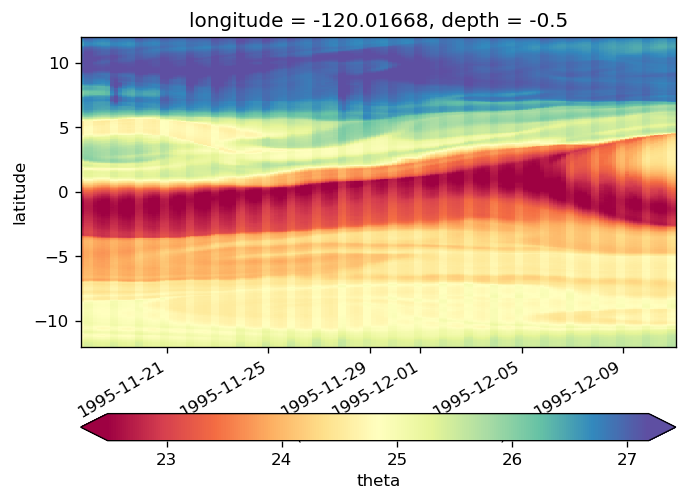

In [ ]:
%matplotlib inline

surf.theta.plot(x='time', robust=True, cmap=mpl.cm.Spectral,
                cbar_kwargs={'orientation': 'horizontal'})

In [ ]:
cluster.scale(2)

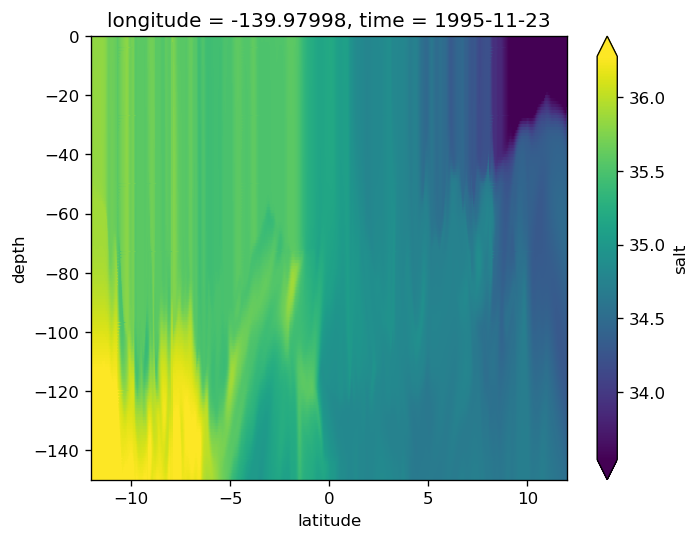

In [ ]:
(gcm1.full.sel(time='1995-11-23 00:00').salt
.sel(longitude=-140, method='nearest')
.sel(depth=slice(0, -150))
.plot(y='depth', robust=True))

## DCL?

In [ ]:
gcm1.tao['mld'] = pump.get_mld(gcm1.tao.dens)
gcm10.tao['mld'] = pump.get_mld(gcm10.tao.dens)

<IPython.core.display.Javascript object>


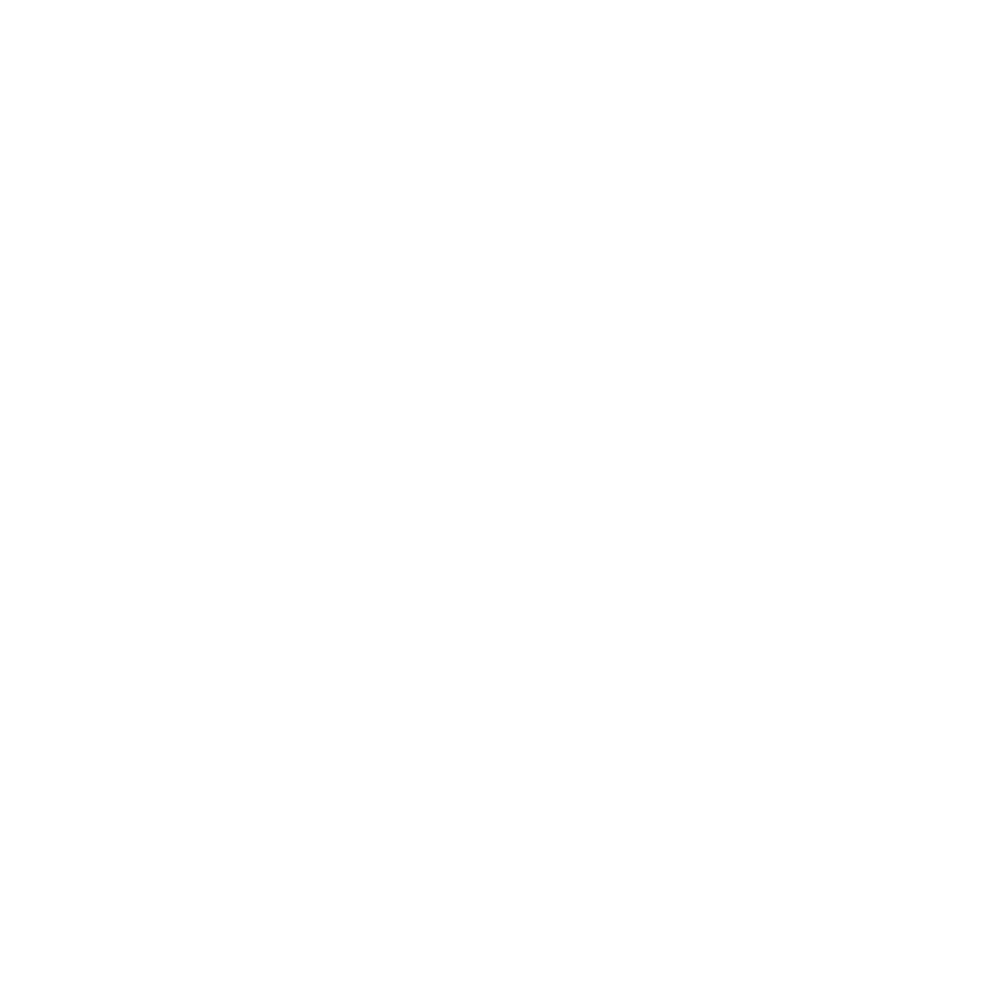

In [ ]:
gcm1.plot_dcl(region=dict(latitude=0, longitude=-140))

## TIW periods: 0, -155W

/glade/u/home/dcherian/pump/pump/calc.py:320: UserWarning: Secondary peaks detected!
  warnings.warn('Secondary peaks detected!')
/glade/u/home/dcherian/pump/pump/calc.py:320: UserWarning: Secondary peaks detected!
  warnings.warn('Secondary peaks detected!')
/gpfs/u/home/dcherian/python/xarray/xarray/core/nanops.py:159: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


<IPython.core.display.Javascript object>


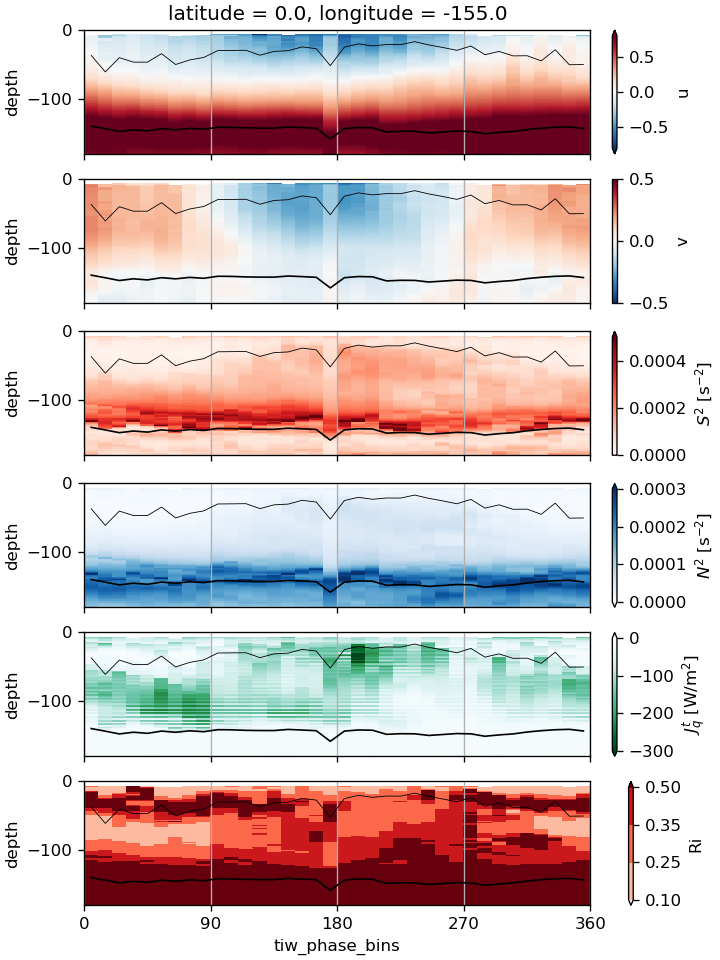

In [ ]:
gcm1.plot_tiw_composite(ds='tao', region=dict(latitude=0, longitude=-155),
                        x='phase')
plt.gcf().savefig('../images/gcm1-tiw-composite-0-155.png')

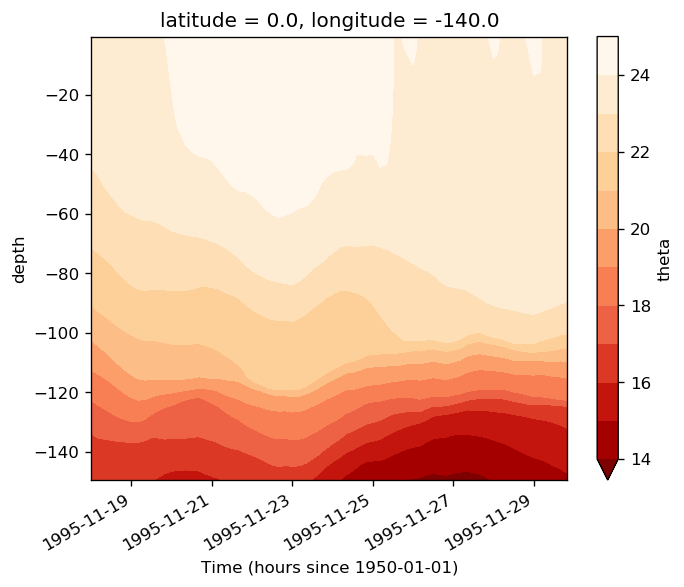

In [ ]:
%matplotlib inline

(gcm1.tao
 .sel(latitude=0, longitude=-140, time=slice('1995-11-18', '1995-11-29'),
     depth=slice(0, -150))
.theta.plot.contourf(levels=12, cmap=mpl.cm.OrRd_r, x='time', robust=True))

<IPython.core.display.Javascript object>


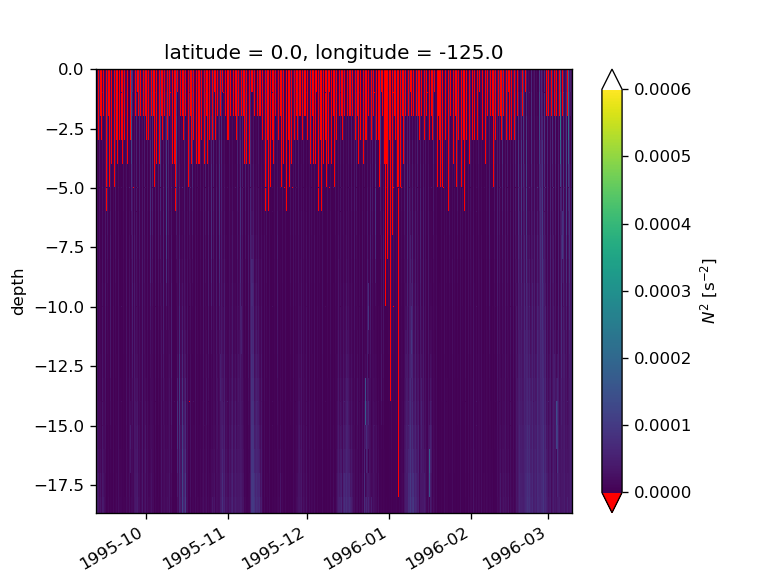

In [ ]:
cmap = mpl.cm.viridis
cmap.set_under('r')
cmap.set_over('w')
gcm1.tao.sel(latitude=0, longitude=-125).N2.plot(x='time', cmap=cmap, vmin=0, vmax=6e-4)

<IPython.core.display.Javascript object>


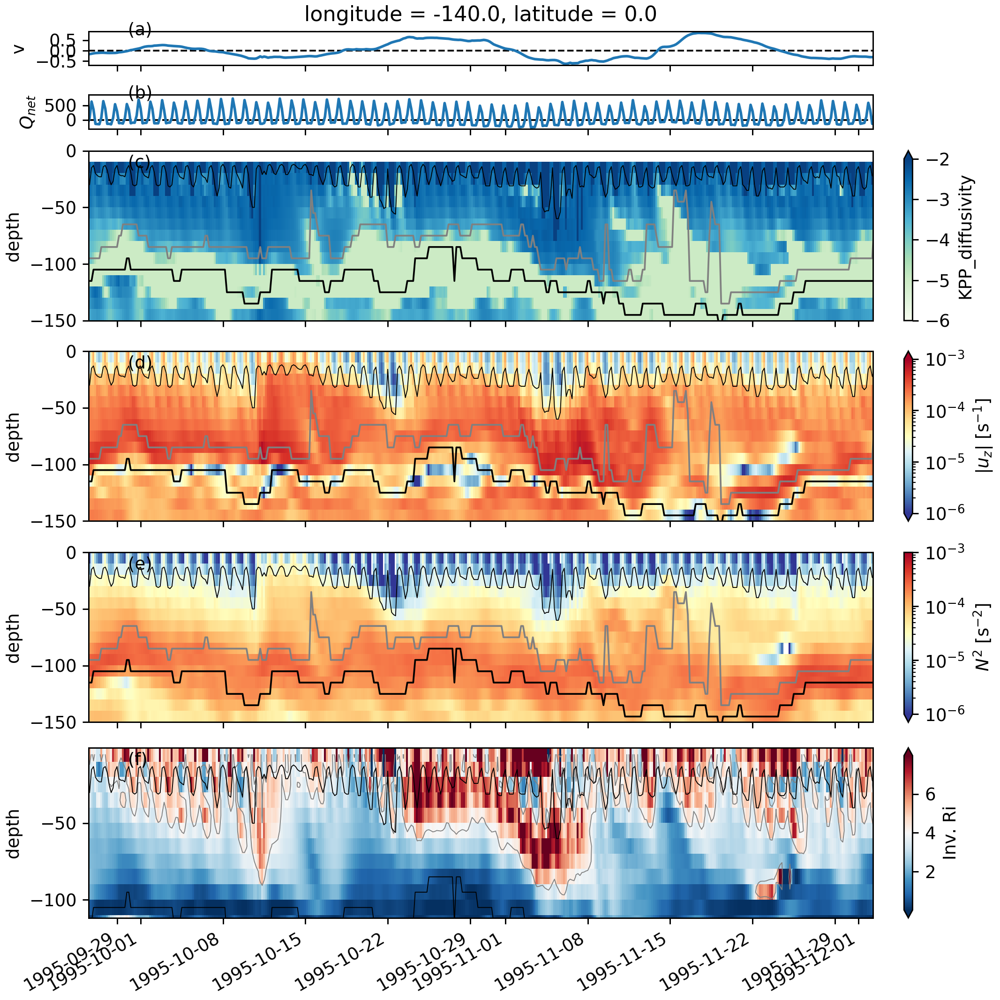

In [ ]:
gcm10.plot_dcl(region=dict(latitude=0, longitude=-140))

/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/matplotlib/__init__.py:855: MatplotlibDeprecationWarning: 
examples.directory is deprecated; in the future, examples will be found relative to the 'datapath' directory.
  "found relative to the 'datapath' directory.".format(key))
/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/matplotlib/__init__.py:846: MatplotlibDeprecationWarning: 
The text.latex.unicode rcparam was deprecated in Matplotlib 2.2 and will be removed in 3.1.
  "2.2", name=key, obj_type="rcparam", addendum=addendum)
/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/seaborn/apionly.py:9: UserWarning: As seaborn no longer sets a default style on import, the seaborn.apionly module is deprecated. It will be removed in a future version.
  warnings.warn(msg, UserWarning)


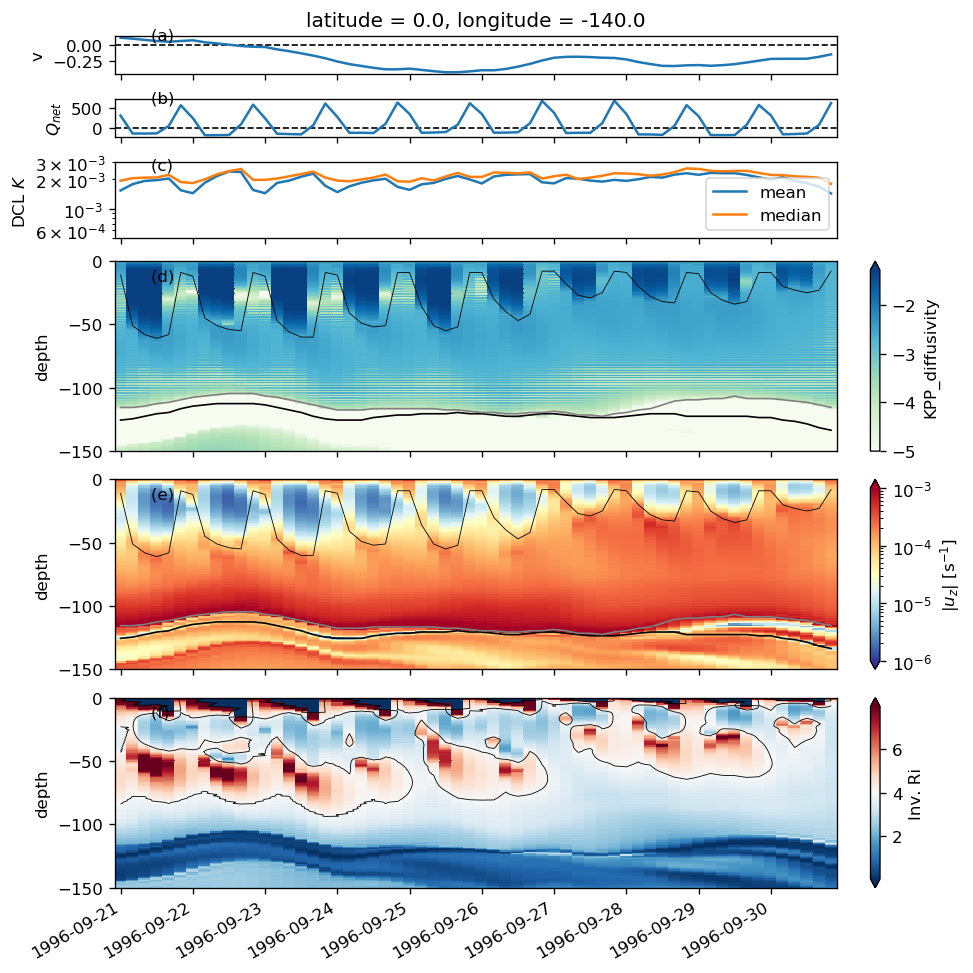

In [ ]:
gcm1.plot_dcl(region=dict(latitude=0, longitude=-140,
                time=slice('1996-09-21', '1996-09-30')))
plt.gcf().savefig('../images/dcl-1m.png')

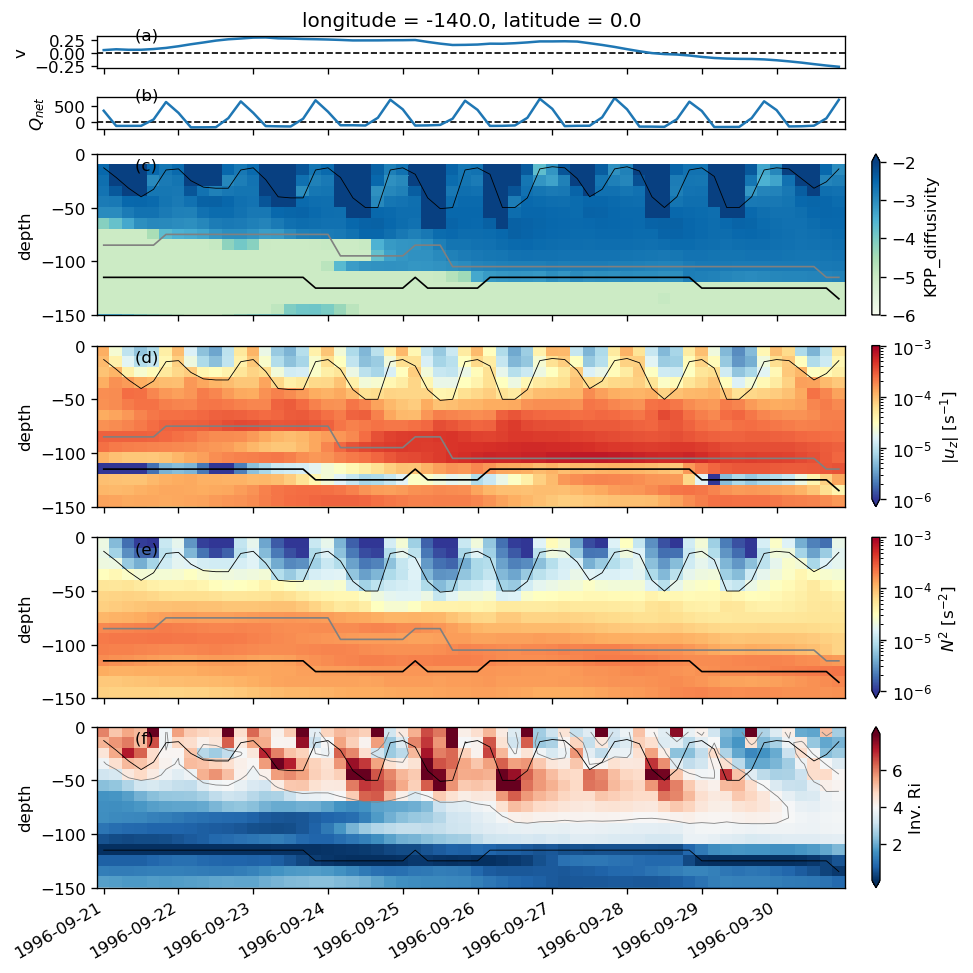

In [ ]:
gcm10.plot_dcl(region=dict(latitude=0, longitude=-140,
                time=slice('1996-09-21', '1996-09-30')))

# slice('1996-05-21', '1996-05-31')

plt.gcf().savefig('../images/maybe-dcl-10m.png')

## Regional marginal instability

Let's see what the seasonal cycle of median Ri is for the top 100m in the entire domain.

In [ ]:
cluster.adapt(minimum=0, maximum=48)

In [ ]:
self = gcm1

subset = pump.calc_reduced_shear(self.full.sel(time=str(self.mid_year), depth=slice(-20, -80)))
subset['Ri'] = subset.N2/subset.shear**2
subset

<xarray.Dataset>
Dimensions:          (depth: 60, latitude: 480, longitude: 1500, time: 2195)
Coordinates:
  * latitude         (latitude) float32 -12.0 -11.949896 ... 11.949896 12.0
  * longitude        (longitude) float32 -170.0 -169.94997 ... -95.05003 -95.0
  * depth            (depth) float32 -20.5 -21.5 -22.5 ... -77.5 -78.5 -79.5
  * time             (time) datetime64[ns] 1996-01-01 ... 1996-12-31T20:00:00
Data variables:
    theta            (time, depth, latitude, longitude) float32 dask.array<shape=(2195, 60, 480, 1500), chunksize=(1, 60, 480, 1500)>
    u                (time, depth, latitude, longitude) float32 dask.array<shape=(2195, 60, 480, 1500), chunksize=(1, 60, 480, 1500)>
    v                (time, depth, latitude, longitude) float32 dask.array<shape=(2195, 60, 480, 1500), chunksize=(1, 60, 480, 1500)>
    w                (time, depth, latitude, longitude) float32 dask.array<shape=(2195, 60, 480, 1500), chunksize=(1, 60, 480, 1500)>
    salt             (time, dep

In [ ]:
cluster.adapt(minimum=2)

In [ ]:
check = subset.isel(time=500).load()

In [ ]:
seasonal_Ri = subset.Ri.groupby(subset.time.dt.season).mean('time')

In [ ]:
Ri_seas = Ri_seas_backup

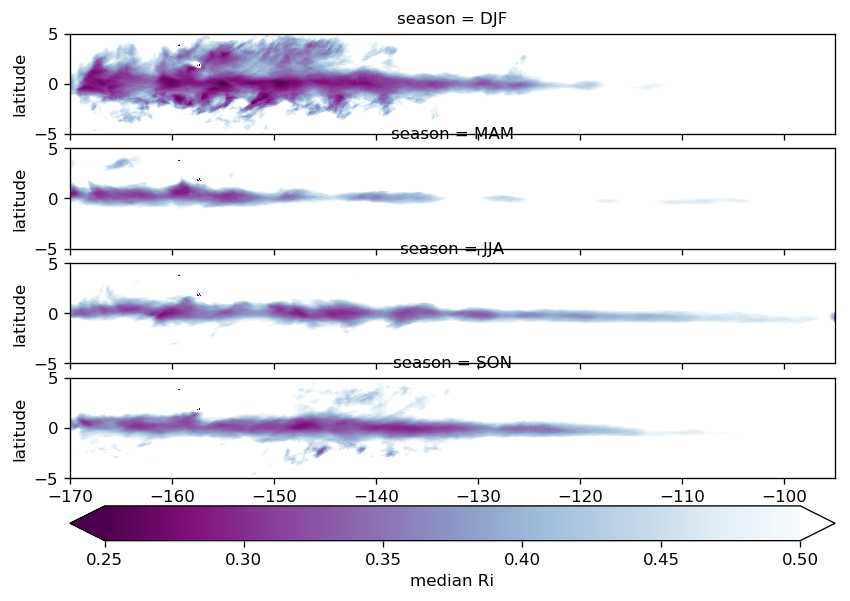

In [ ]:
cm = mpl.cm.BuPu_r
cm.set_over('w')
Ri_seasonal.plot(row='season', vmin=0.25, vmax=0.5, ylim=(-5, 5),
                 cmap=cm, cbar_kwargs=dict(orientation='horizontal', pad=0.05))
plt.gcf().set_size_inches((8, 5))

In [ ]:
grouped = subset.Ri.groupby('time.season')

Ri_seas = dict()
for label, gg in grouped:
    Ri = gg.load()
    Ri = Ri.where(Ri > 0)
    Ri_seas[label] = Ri.median(['time', 'depth'])
    
Ri_seasonal = xr.concat([rr.expand_dims('season') for rr in Ri_seas.values()], 
                        'season')
Ri_seasonal['season'] = np.array(list(Ri_seas.keys()))
Ri_seasonal = Ri_seasonal.reindex(season=['DJF', 'MAM', 'JJA', 'SON'])
Ri_seasonal.attrs['long_name'] = 'median Ri'
Ri_seasonal.attrs['units'] = ''
Ri_seasonal

## animation expts

In [ ]:
(hb.surface.theta
 .hvplot(colorbar=True, groupby='time', colormap=mpl.cm.RdYlBu_r))

:DynamicMap   [time]
   :Image   [longitude,latitude]   (theta)

In [ ]:
kwargs = dict(parallel=True, engine='h5netcdf', 
              chunks={'depth': 24, 'latitude': 96, 'longitude': 300})

%time model10 = xr.open_mfdataset('../glade/TPOS_MITgcm_10_hb/HOLD/Day_[0-9][0-9][0-9][0-9].nc', **kwargs)
#%time hb10 = xr.open_mfdataset('../glade/TPOS_MITgcm_10_hb/HOLD/Day_*_hb.nc', **kwargs)
#%time sf10 = xr.open_mfdataset('../glade/TPOS_MITgcm_10_hb/HOLD/Day_*_sf.nc', **kwargs)

#full = xr.merge([model10, hb10, sf10])

CPU times: user 31.9 s, sys: 3.09 s, total: 35 s
Wall time: 49.7 s


In [ ]:
full = xr.merge([model10, hb10, sf10])

In [ ]:
out = full.isel(depth=0).to_zarr('../glade/hb_surf.zarr', mode='w', consolidated=True, compute=False)

In [ ]:
model10.to_zarr(store='../glade/10_hb.zarr/',
                mode='w',
                consolidated=True)

In [ ]:
tao = (model10.sel(longitude=pump.section_lons, method='nearest')
       .sel(depth=slice(0, -500)))

In [ ]:
(np.log10(tao0140.KPP_diffusivity).sel(depth=np.arange(-50, -150, -25), method='nearest')
 .hvplot.line(x='time'))

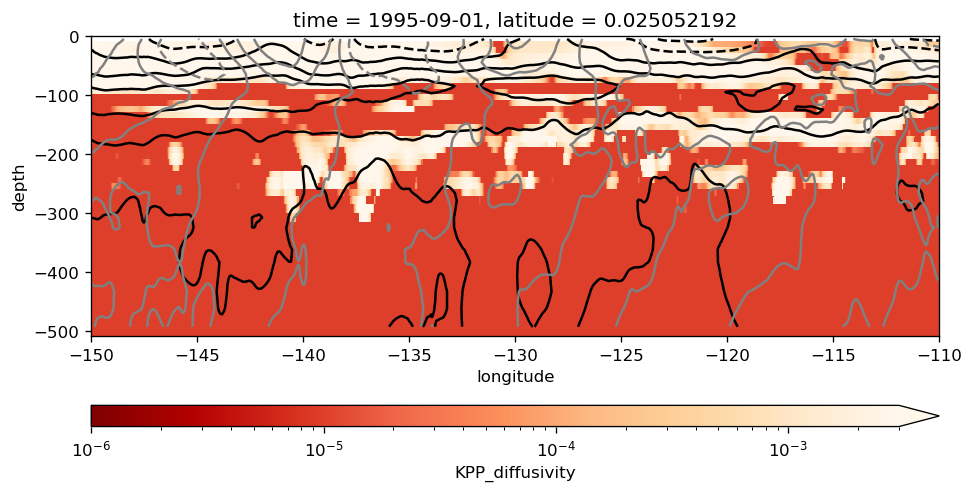

In [ ]:
%matplotlib inline 

mpl.rcParams['figure.dpi'] = 120

subset = (model10[['KPP_diffusivity', 'u', 'v']]
          .sel(latitude=0, method='nearest')
          .sel(depth=slice(0, -500), longitude=slice(-150, -110)))

def _plot(subset, tt):
    f, ax = plt.subplots(1, 1, constrained_layout=True)
    f.set_size_inches((8, 4))
    
    # subset = subset.isel(time=tt).compute()
    
    (subset.KPP_diffusivity
     .plot(y='depth', ax=ax, norm=mpl.colors.LogNorm(1e-6, 3e-3), 
           cmap=mpl.cm.OrRd_r, cbar_kwargs={'orientation': 'horizontal'}))

    (subset.u
     .plot.contour(y='depth', colors='k', ax=ax))
    (subset.v
     .plot.contour(y='depth', colors='gray', ax=ax))
    
    tt = subset.time.values

    f.savefig('../movies/diff_u/diff_u_' + str(tt) + '.png', dpi=300, bbox_inches='tight')
    
    del subset
    

_plot(subset.isel(time=0), 0)

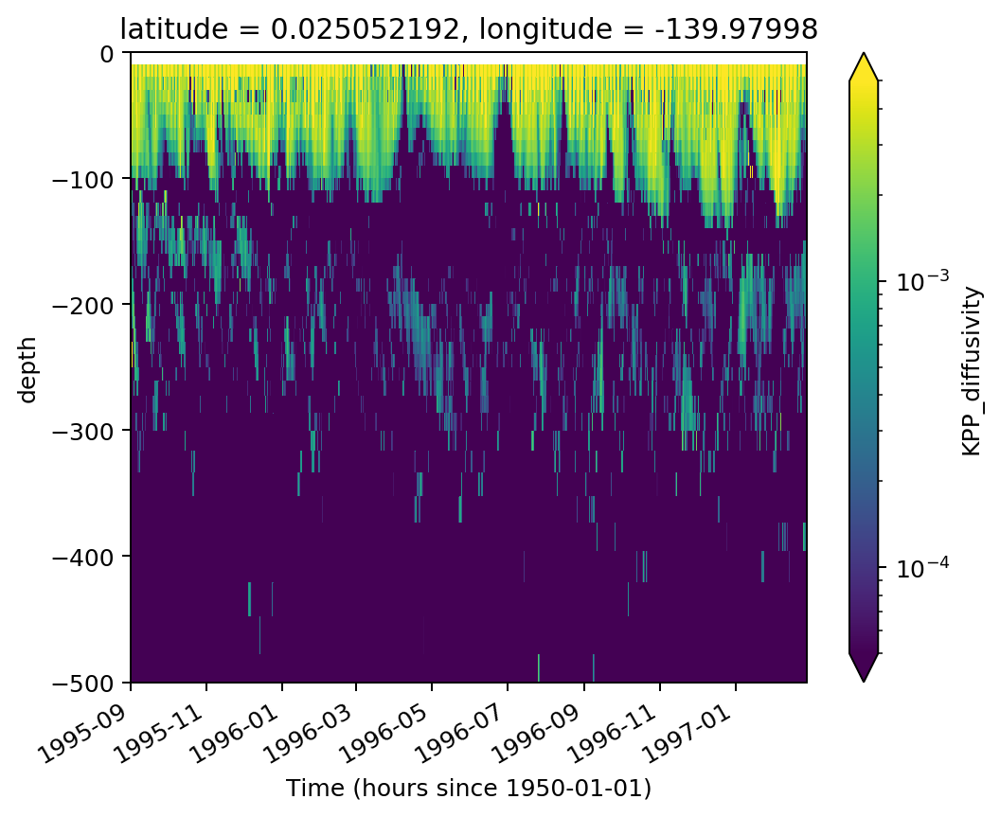

In [ ]:
%matplotlib inline

(model10.KPP_diffusivity.sel(latitude=0, longitude=-140, method='nearest')
 .plot(y='depth', ylim=[-500, 0], norm=mpl.colors.LogNorm(5e-5, 5e-3)))

# Old stuff

In [ ]:
%time mitgcm = pump.model.model('../glade/TPOS_MITgcm/HOLD/', name='MITgcm 1/20', kind='mitgcm', full=True)
%time roms = pump.model.model('../glade/tpos20/OUT/', name='ROMS', kind='roms')

# %time mitgcm.surface.load()

Reading all files took 10.84913420677185 seconds
CPU times: user 3.63 s, sys: 546 ms, total: 4.17 s
Wall time: 11.9 s
CPU times: user 156 ms, sys: 32.8 ms, total: 189 ms
Wall time: 774 ms


In [ ]:
mitgcm.tao

<xarray.Dataset>
Dimensions:    (depth: 43, latitude: 7, longitude: 6, time: 546)
Coordinates:
  * latitude   (latitude) float32 -8.0 -5.0 -2.0 0.0 2.0 5.0 8.0
  * longitude  (longitude) float32 -170.0 -155.0 -140.0 -125.0 -110.0 -95.0
  * depth      (depth) float32 -2.5 -7.5 -12.5 ... -448.35446 -486.9231
  * time       (time) datetime64[ns] 1995-09-01 1995-09-02 ... 1997-02-27
Data variables:
    theta      (time, depth, latitude, longitude) float32 ...
    u          (time, depth, latitude, longitude) float32 ...
    v          (time, depth, latitude, longitude) float32 ...
    w          (time, depth, latitude, longitude) float32 ...
    salt       (time, depth, latitude, longitude) float32 ...
Attributes:
    title:              daily snapshot from 1/100 degree Tasman Sea MITgcm si...
    easting:            longitude
    northing:           latitude
    field_julian_date:  400296
    julian_day_unit:    days since 1950-01-01 00:00:00

In [ ]:
mitgcm.full.sel(longitude=pump.section_lons, method='nearest')

<xarray.Dataset>
Dimensions:    (depth: 100, latitude: 480, longitude: 6, time: 546)
Coordinates:
  * depth      (depth) float32 -2.5 -7.5 -12.5 ... -5644.034 -5744.034 -5844.034
  * latitude   (latitude) float32 -12.0 -11.949896 -11.899791 ... 11.949896 12.0
  * longitude  (longitude) float32 -95.0 -110.01001 ... -154.98999 -170.0
  * time       (time) datetime64[ns] 1995-09-01 1995-09-02 ... 1997-02-27
Data variables:
    salt       (time, depth, latitude, longitude) float32 dask.array<shape=(546, 100, 480, 6), chunksize=(1, 100, 480, 6)>
    theta      (time, depth, latitude, longitude) float32 dask.array<shape=(546, 100, 480, 6), chunksize=(1, 100, 480, 6)>
    u          (time, depth, latitude, longitude) float32 dask.array<shape=(546, 100, 480, 6), chunksize=(1, 100, 480, 6)>
    v          (time, depth, latitude, longitude) float32 dask.array<shape=(546, 100, 480, 6), chunksize=(1, 100, 480, 6)>
    w          (time, depth, latitude, longitude) float32 dask.array<shape=(546, 100

In [ ]:
mitgcm.surface.sel(time='1996').mean('time').to_netcdf(mitgcm.dirname + '/obs_subset/surface-1996.nc')

In [ ]:
%time mitgcm.johnson.load()
%time mitgcm.surface.load()

CPU times: user 3.9 ms, sys: 2.01 ms, total: 5.91 ms
Wall time: 30.1 ms
CPU times: user 1.26 s, sys: 3.37 s, total: 4.64 s
Wall time: 6.07 s


<xarray.Dataset>
Dimensions:     (latitude: 480, longitude: 1500, time: 546)
Coordinates:
    depth       float32 -2.5
  * latitude    (latitude) float32 -12.0 -11.949896 ... 11.949896 12.0
  * longitude   (longitude) float32 -170.0 -169.94997 ... -95.05003 -95.0
  * time        (time) datetime64[ns] 1995-09-01 1995-09-02 ... 1997-02-27
Data variables:
    salt        (time, latitude, longitude) float32 34.792625 ... 34.019794
    theta       (time, latitude, longitude) float32 28.840086 ... 26.698692
    u           (time, latitude, longitude) float32 -0.21761183 ... 0.15395378
    v           (time, latitude, longitude) float32 -0.070100464 ... 0.09245764
    w           (time, latitude, longitude) float32 nan nan nan ... nan nan nan
    theta_anom  (time, latitude, longitude) float32 2.192709 ... -0.3950863
Attributes:
    title:                     daily snapshot from 1/100 degree Tasman Sea MI...
    easting:                   longitude
    northing:                  latitude
    

# Multiple gcm runs

## load data

In [ ]:
cluster.scale(2)

In [ ]:
# %time gcm0 = pump.model('../glade/TPOS_MITgcm/HOLD/', 'gcm20 orig')
%time gcm1 = pump.model('../glade/TPOS_MITgcm_1/HOLD/', 'gcm20 1m')
%time gcm25 = pump.model('../glade/TPOS_MITgcm_2.5/HOLD/', 'gcm20 2.5m')
%time gcm5 = pump.model('../glade/TPOS_MITgcm_5/HOLD/', 'gcm20 5m')
%time gcm10 = pump.model('../glade/TPOS_MITgcm_10/HOLD/', 'gcm20 10m')

models = dict(zip(['1m', '2.5m', '5m', '10m'],
                  [gcm1, gcm25, gcm5, gcm10]))

metrics files not available.


/gpfs/u/home/dcherian/python/xarray/xarray/backends/api.py:783: FutureWarning: In xarray version 0.13 `auto_combine` will be deprecated.
  coords=coords)
/gpfs/u/home/dcherian/python/xarray/xarray/backends/api.py:783: FutureWarning: Also `open_mfdataset` will no longer accept a `concat_dim` argument.
To get equivalent behaviour from now on please use the new
`combine_nested` function instead (or the `combine='nested'` option to
`open_mfdataset`).The datasets supplied have global dimension coordinates. You may want
to use the new `combine_by_coords` function (or the
`combine='by_coords'` option to `open_mfdataset` to order the datasets
before concatenation. Alternatively, to continue concatenating based
on the order the datasets are supplied in in future, please use the
new `combine_nested` function (or the `combine='nested'` option to
open_mfdataset).
  coords=coords)


CPU times: user 1.81 s, sys: 560 ms, total: 2.37 s
Wall time: 2.73 s
metrics files not available.


/gpfs/u/home/dcherian/python/xarray/xarray/backends/api.py:783: FutureWarning: In xarray version 0.13 `auto_combine` will be deprecated.
  coords=coords)
/gpfs/u/home/dcherian/python/xarray/xarray/backends/api.py:783: FutureWarning: Also `open_mfdataset` will no longer accept a `concat_dim` argument.
To get equivalent behaviour from now on please use the new
`combine_nested` function instead (or the `combine='nested'` option to
`open_mfdataset`).The datasets supplied have global dimension coordinates. You may want
to use the new `combine_by_coords` function (or the
`combine='by_coords'` option to `open_mfdataset` to order the datasets
before concatenation. Alternatively, to continue concatenating based
on the order the datasets are supplied in in future, please use the
new `combine_nested` function (or the `combine='nested'` option to
open_mfdataset).
  coords=coords)


CPU times: user 1.1 s, sys: 106 ms, total: 1.21 s
Wall time: 1.52 s
metrics files not available.


/gpfs/u/home/dcherian/python/xarray/xarray/backends/api.py:783: FutureWarning: In xarray version 0.13 `auto_combine` will be deprecated.
  coords=coords)
/gpfs/u/home/dcherian/python/xarray/xarray/backends/api.py:783: FutureWarning: Also `open_mfdataset` will no longer accept a `concat_dim` argument.
To get equivalent behaviour from now on please use the new
`combine_nested` function instead (or the `combine='nested'` option to
`open_mfdataset`).The datasets supplied have global dimension coordinates. You may want
to use the new `combine_by_coords` function (or the
`combine='by_coords'` option to `open_mfdataset` to order the datasets
before concatenation. Alternatively, to continue concatenating based
on the order the datasets are supplied in in future, please use the
new `combine_nested` function (or the `combine='nested'` option to
open_mfdataset).
  coords=coords)


CPU times: user 786 ms, sys: 46.6 ms, total: 832 ms
Wall time: 1.01 s
metrics files not available.


/gpfs/u/home/dcherian/python/xarray/xarray/backends/api.py:783: FutureWarning: In xarray version 0.13 `auto_combine` will be deprecated.
  coords=coords)
/gpfs/u/home/dcherian/python/xarray/xarray/backends/api.py:783: FutureWarning: Also `open_mfdataset` will no longer accept a `concat_dim` argument.
To get equivalent behaviour from now on please use the new
`combine_nested` function instead (or the `combine='nested'` option to
`open_mfdataset`).The datasets supplied have global dimension coordinates. You may want
to use the new `combine_by_coords` function (or the
`combine='by_coords'` option to `open_mfdataset` to order the datasets
before concatenation. Alternatively, to continue concatenating based
on the order the datasets are supplied in in future, please use the
new `combine_nested` function (or the `combine='nested'` option to
open_mfdataset).
  coords=coords)


CPU times: user 501 ms, sys: 30.4 ms, total: 532 ms
Wall time: 609 ms


In [ ]:
[johnson, tao, sst, oscar] = pump.read_all(gcm1.domain['xyt'])
tao.persist()
sst.sst.persist()

/gpfs/u/home/dcherian/python/xarray/xarray/backends/api.py:783: FutureWarning: In xarray version 0.13 `auto_combine` will be deprecated.
  coords=coords)
/gpfs/u/home/dcherian/python/xarray/xarray/backends/api.py:783: FutureWarning: The datasets supplied have global dimension coordinates. You may want
to use the new `combine_by_coords` function (or the
`combine='by_coords'` option to `open_mfdataset` to order the datasets
before concatenation. Alternatively, to continue concatenating based
on the order the datasets are supplied in in future, please use the
new `combine_nested` function (or the `combine='nested'` option to
open_mfdataset).The datasets supplied require both concatenation and merging. From
xarray version 0.14 this will operation will require either using the
new `combine_nested` function (or the `combine='nested'` option to
open_mfdataset), with a nested list structure such that you can combine
along the dimensions None. Alternatively if your datasets have global
dimensio

<xarray.DataArray 'sst' (time: 488, latitude: 96, longitude: 300)>
dask.array<shape=(488, 96, 300), dtype=float32, chunksize=(122, 96, 300)>
Coordinates:
  * latitude   (latitude) float32 -11.875 -11.625 -11.375 ... 11.625 11.875
  * longitude  (longitude) float32 -169.875 -169.625 ... -95.375 -95.125
  * time       (time) datetime64[ns] 1995-09-01 1995-09-02 ... 1996-12-31
Attributes:
    long_name:    Daily Sea Surface Temperature
    units:        degC
    valid_range:  [-3. 45.]
    precision:    2.0
    dataset:      NOAA High-resolution Blended Analysis
    var_desc:     Sea Surface Temperature
    level_desc:   Surface
    statistic:    Mean
    parent_stat:  Individual Observations

In [ ]:
for mm in models:
    print(mm)
    models[mm].tao.load()
    pump.calc_reduced_shear(models[mm].tao)

gcm
1m
2.5m
5m
10m


## Annual mean EUC

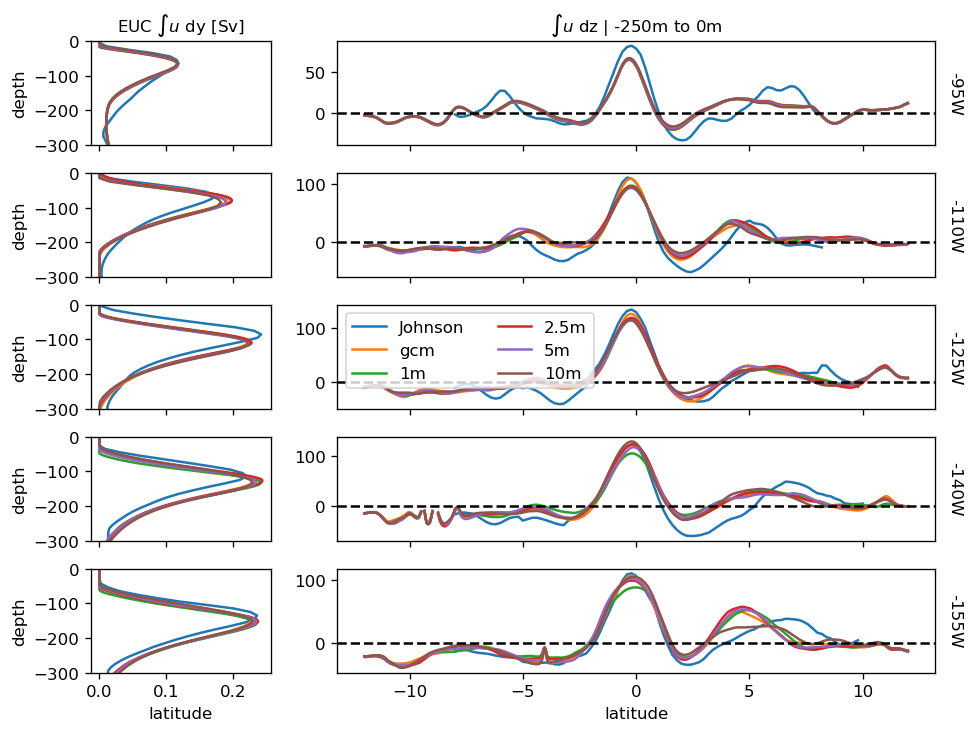

In [ ]:
all = [johnson] + [models[mm].johnson for mm in models]

fg = facetgrid.facetgrid(
    col=['inty', 'intz'],
    row=np.round(all[1].longitude).astype(np.int),
    sharex='col', sharey='none',
    gridspec_kw={'width_ratios': [0.3, 1]},
    plot_kwargs=dict(xlim=[-10, 10], ylim=[-300, 0],
                     levels=20, vmin=-0.8, vmax=0.8, cmap=mpl.cm.RdBu_r))

for sim in all:
    fg.map_col('inty', 
               pump.calc.get_euc_transport(sim.u), 
               xr.plot.line,
               x=None, y='depth', defaults=False, _labels=False, ylim=[-300, 0])

for sim in all:
    fg.map_col('intz', 
               -1*sim.u.sel(depth=slice(0, -250)).integrate('depth'), 
               xr.plot.line,
               x='latitude', y=None, defaults=False, _labels=False)

fg.map_col('intz', None, plt.axhline, y=0, color='k', ls='--')

fg.set_col_labels(col_names=[r'EUC $\int u$ dy [Sv]', 
                             r'$\int u$ dz | -250m to 0m'], 
                  template='{value}')
fg.set_row_labels(template='{value}W')

fg.set_xlabels('latitude')
fg.set_ylabels('depth')

fg.fig.set_constrained_layout_pads()
fg.fig.set_size_inches(8, 6)

fg.axes[2, 1].legend(['Johnson'] + list(models.keys()),
                     ncol=2)

fg.fig.savefig('../images/current-profiles-all-gcm.png', dpi=300)

## OISST vs SST

In [ ]:
tasks = [dask.delayed(models[mm].surface.theta.load)() for mm in models]
computed = dask.compute(tasks)

In [ ]:
for cc, mm in zip(computed[0], models):
    models[mm].surface['theta'] = cc

<IPython.core.display.Javascript object>


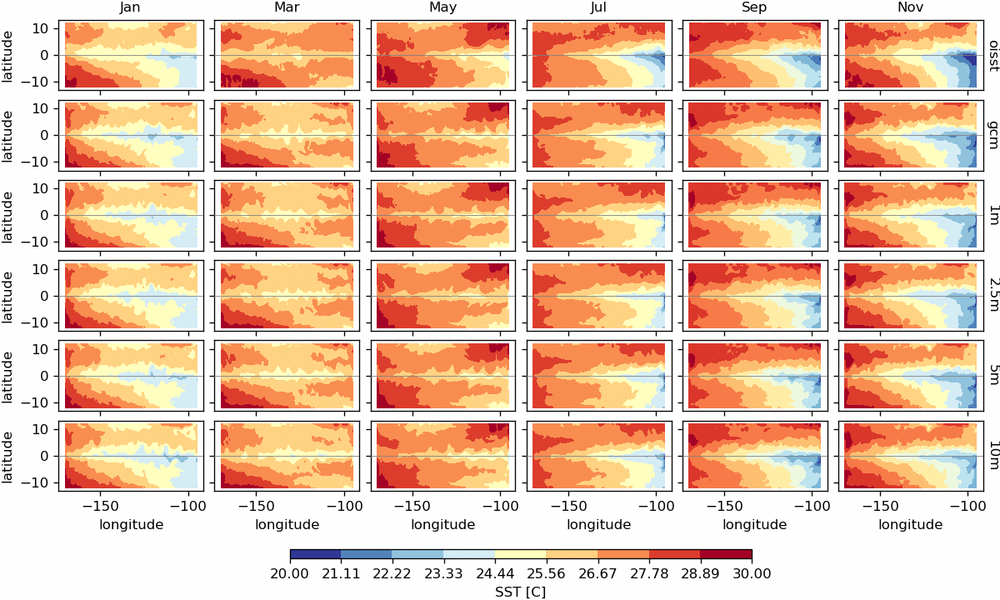

gcm
1m
2.5m
5m
10m


In [ ]:
months = (models['1m'].surface.time
          .sel(time='1996')
          .resample(time='M').mean('time')
          .isel(time=slice(0,-1,2)))

fg = facetgrid.facetgrid(row=['oisst'] + list(models.keys()), 
                         col=months,
                         sharex=True, sharey=True,
                         plot_kwargs=dict(levels=10, vmin=20, vmax=30, cmap=mpl.cm.RdYlBu_r))

for mm in models:
    print(mm)
    mean = models[mm].surface.theta.sel(time='1996').resample(time='M').mean('time')
    fg.map_row(mm, mean, xr.plot.contourf, x='longitude', y='latitude')
          
fg.map_row('oisst', sst.sst.sel(time='1996').resample(time='M').mean('time'), xr.plot.contourf)

fg.set_titles(col_names=['Jan', 'Mar', 'May', 'Jul', 'Sep', 'Nov'])
fg.set_ylabels('latitude')
fg.set_xlabels('longitude')
fg.map(lambda: plt.axhline(0, color='gray', lw=0.5, zorder=20, ls='-'))
fg.fig.set_size_inches((10, 6))
fg.add_colorbar(orientation='horizontal', shrink=0.5, aspect=15, label='SST [C]')

fg.fig.savefig('../images/sst-all-gcm.png', dpi=300)

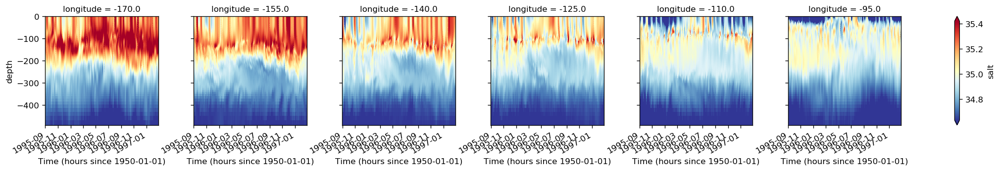

In [ ]:
gcm1.tao.sel(latitude=0).salt.plot(x='time', cmap=mpl.cm.RdYlBu_r, 
                                   col='longitude', robust=True)

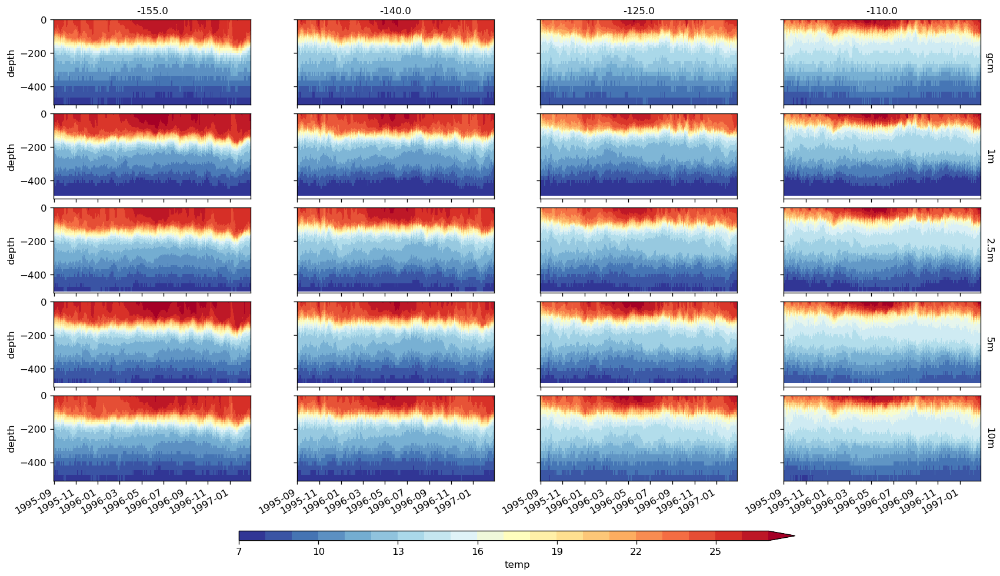

In [ ]:
fg = facetgrid.facetgrid(row=list(models.keys()),
                         col=gcm1.tao.longitude[1:-1],
                         plot_kwargs=dict(robust=True, cmap=mpl.cm.RdYlBu_r, levels=20))

for mm in models:
    fg.map_row(mm, models[mm].tao.sel(latitude=0).theta,
               xr.plot.pcolormesh, x='time')
    
plt.gcf().set_size_inches((14, 8))
fg.set_titles()
fg.set_ylabels('depth')
fg.add_colorbar(orientation='horizontal', shrink=0.6, label='temp')

In [ ]:
argo = pump.read_argo()

In [ ]:
argo_tao = argo.sel(latitude=0, longitude=pump.section_lons, method='nearest')

argo_tao['longitude'].values = pump.section_lons
argo_tao

<xarray.Dataset>
Dimensions:          (depth: 58, longitude: 6, time: 156)
Coordinates:
  * longitude        (longitude) int64 -95 -110 -125 -140 -155 -170
    latitude         float32 0.5
  * depth            (depth) float32 -2.5 -10.0 -20.0 ... -1900.0 -1975.0
  * time             (time) datetime64[ns] 2004-01-16 2004-02-15 ... 2016-10-09
Data variables:
    Tmean            (depth, longitude) float32 dask.array<shape=(58, 6), chunksize=(58, 1)>
    Tanom            (time, depth, longitude) float32 dask.array<shape=(156, 58, 6), chunksize=(156, 58, 1)>
    BATHYMETRY_MASK  (depth, longitude) float32 dask.array<shape=(58, 6), chunksize=(58, 1)>
    MAPPING_MASK     (depth, longitude) float32 dask.array<shape=(58, 6), chunksize=(58, 1)>
    T                (time, depth, longitude) float32 dask.array<shape=(156, 58, 6), chunksize=(156, 58, 1)>
    Smean            (depth, longitude) float32 dask.array<shape=(58, 6), chunksize=(58, 1)>
    Sanom            (time, depth, longitude) float

In [ ]:
oni = xr.open_dataset('../glade/obs/oni.nc').rename({'index': 'oni'})['oni']

<IPython.core.display.Javascript object>


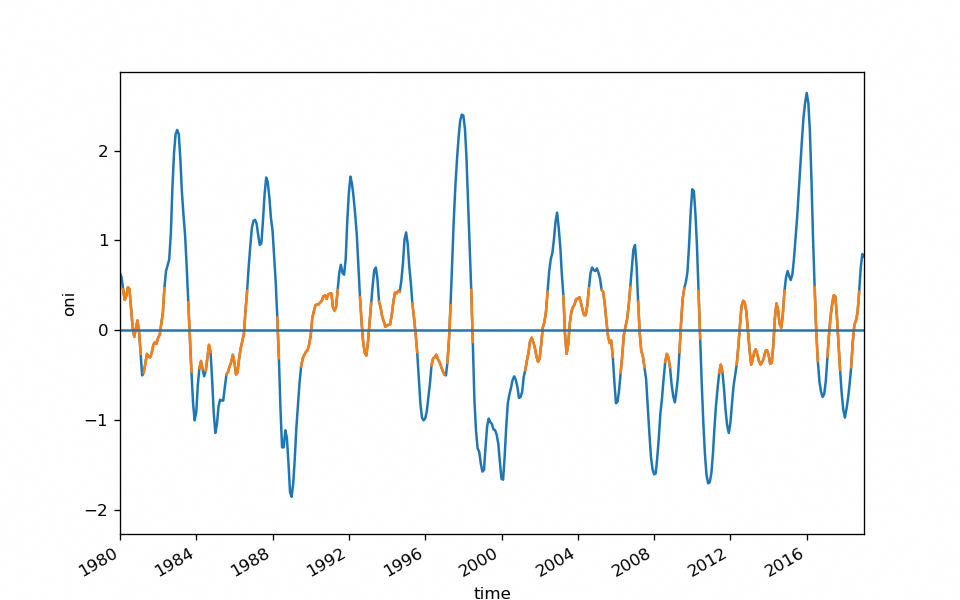

/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/pandas/plotting/_converter.py:129: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)


In [ ]:
oni.plot()
oni.where(np.abs(oni) < 0.5).plot()
plt.xlim('1980-1-1', '2019-01-01')
plt.axhline(0)
plt.gcf().set_size_inches((8, 5))

In [ ]:
%time argo_tao.S.load()

CPU times: user 707 ms, sys: 104 ms, total: 812 ms
Wall time: 1.59 s


<xarray.DataArray 'S' (time: 156, depth: 58, longitude: 6)>
array([[[34.111   , 34.451   , ..., 35.082   , 34.897   ],
        [34.166   , 34.46    , ..., 35.081   , 34.901997],
        ...,
        [34.633   , 34.632   , ..., 34.632   , 34.632   ],
        [34.638   , 34.637   , ..., 34.638   , 34.637   ]],

       [[33.787003, 34.457   , ..., 35.077   , 35.063   ],
        [33.961998, 34.475   , ..., 35.077   , 35.065   ],
        ...,
        [34.632   , 34.634   , ..., 34.632   , 34.634   ],
        [34.637   , 34.639   , ..., 34.638   , 34.639   ]],

       ...,

       [[34.670002, 34.841   , ..., 34.869   , 34.926   ],
        [34.684   , 34.843   , ..., 34.874   , 34.927   ],
        ...,
        [34.637997, 34.635   , ..., 34.635998, 34.633   ],
        [34.64    , 34.639   , ..., 34.639   , 34.636   ]],

       [[34.533   , 34.686   , ..., 34.984   , 34.833   ],
        [34.572998, 34.696   , ..., 34.984   , 34.836   ],
        ...,
        [34.636997, 34.638   , ..., 34.6359

## Compare salinity variations with Argo climatology

In [ ]:
argo

<xarray.Dataset>
Dimensions:    (depth: 58, longitude: 6)
Coordinates:
  * longitude  (longitude) int64 -95 -110 -125 -140 -155 -170
    latitude   float32 0.5
  * depth      (depth) float32 2.5 10.0 20.0 30.0 ... 1800.0 1900.0 1975.0
Data variables:
    mean       (depth, longitude) float32 34.151398 34.572453 ... 34.63742
    std        (depth, longitude) float32 0.24557741 0.16765662 ... 0.0015951529

<IPython.core.display.Javascript object>


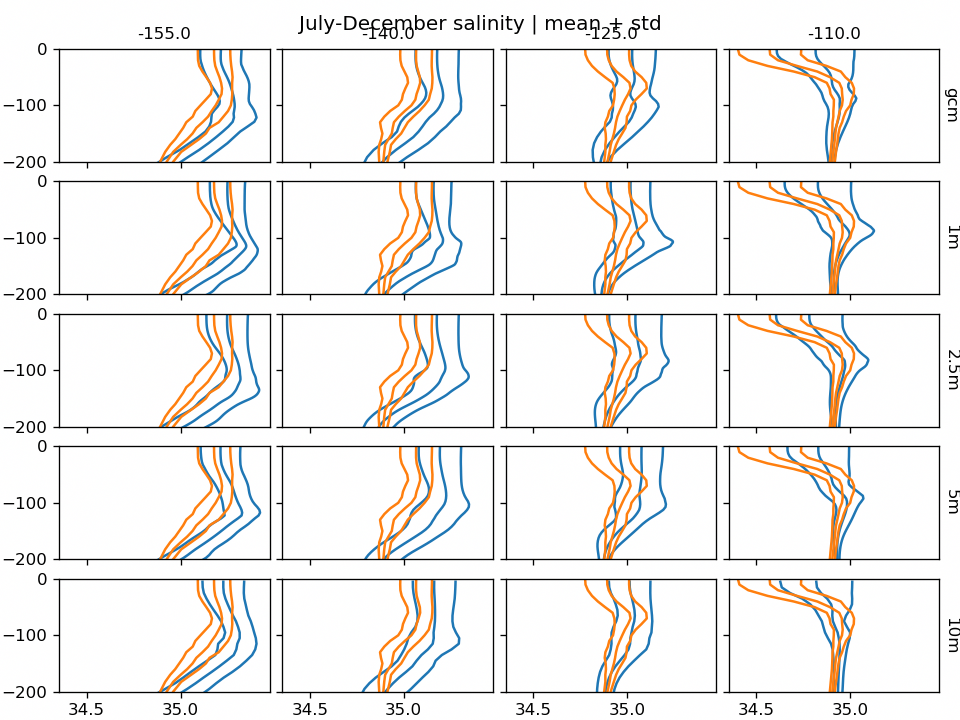

In [ ]:
fg = facetgrid.facetgrid(row=list(models.keys()),
                         col=gcm1.tao.longitude[1:-1])

fg.kwargs = dict(_labels=False, add_legend=False)

subset = (argo_tao.S
          .where(np.abs(oni.interp_like(argo_tao.time)) < 0.5)
          .where(argo_tao.time.dt.month.isin(np.arange(7, 12))))
argoS = xr.Dataset()
argoS['mean'] = subset.mean('time')
argoS['std'] = subset.std('time')
  
for mm in models:
    subset = (models[mm].tao.salt.sel(latitude=0).sel(time=slice('1996-07-01', '1996-12-31')))
    mean = subset.mean('time')
    std = subset.std('time').expand_dims(err=2)
    sign = std.err.copy(data=[-1, 1])
    std = std * sign
    
    fg.map_row(mm, mean, xr.plot.line, y='depth')
    fg.map_row(mm, mean + std, xr.plot.line, y='depth', color='C0')
    
    fg.map_row(mm, argoS['mean'], xr.plot.line, y='depth', color='C1')
    fg.map_row(mm, argoS['mean'] + argoS['std'], xr.plot.line, y='depth', color='C1')
    fg.map_row(mm, argoS['mean'] - argoS['std'], xr.plot.line, y='depth', color='C1')
    
fg.set_titles()
fg.axes[0,0].set_ylim([-200, 0])
fg.fig.suptitle('July-December salinity | mean + std')
fg.fig.set_size_inches(8, 6)

## Marginal stability of the mean state?

/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/numpy/lib/function_base.py:838: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges


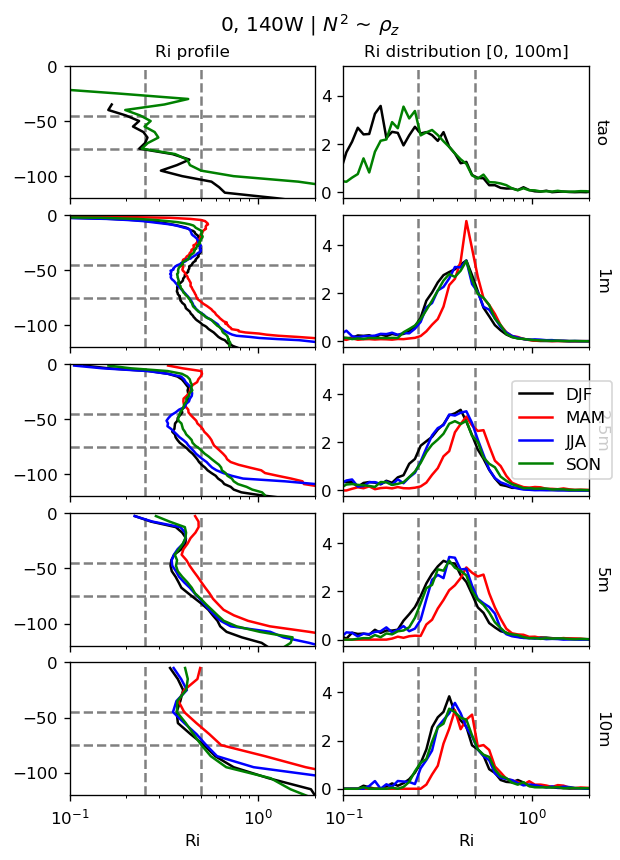

In [ ]:
%matplotlib inline

def hist(da):
    bins = np.logspace(-2, 1, 100)

    hist, edges = np.histogram(da.values[np.isfinite(da.values)], 
                               bins=bins, 
                               density=True)
    histda = xr.DataArray(hist,
                          dims=['bins'],
                          coords={'bins': (bins[:-1] + bins[1:])/2})

    return histda


kwargs = dict(_labels=False, add_legend=False)

fg = facetgrid.facetgrid(row=['tao'] + list(models.keys()),
                         col=['Ri profile', 'Ri PDF'],
                         sharex='col', sharey='col')

fg.kwargs = {'_labels': False, 'add_legend': False}

for ax in fg.axes.flat:
    ax.set_prop_cycle('color', ['k', 'r', 'b', 'g'])

for mm in fg.row:
    if mm == 'tao':
        Ri = (pump.calc_tao_ri(adcp.sel(longitude=-140, time=tao.time), 
                               tao.temp.sel(latitude=0, 
                                            longitude=-140)))

    else:
        subset = models[mm].tao.sel(latitude=0, longitude=-140)
        N2 = -9.81/1025 * subset.dens.differentiate('depth')
        N2Tz = (9.81 * sw.alpha(35, subset.theta, xr.broadcast(subset.theta, subset.depth)[1])
                * subset.theta.differentiate('depth'))
        S2 = subset.u.differentiate('depth')**2 + subset.v.differentiate('depth')**2
        
        Ri = N2Tz/S2; extra_title = '$N^2$ ~ $T_z$'
        Ri = N2/S2; extra_title = '$N^2$ ~ $ρ_z$'
        Ri = Ri.where(Ri > 0).load()

    grouped = Ri.groupby(Ri.time.dt.season)
    seasonal_Ri = grouped.median('time').reindex(season=['DJF', 'MAM', 'JJA', 'SON'])

    handles = seasonal_Ri.plot(y='depth', hue='season', ax=fg.row_axes[mm][0],
                     **fg.kwargs, xscale='log', xlim=[0.1, 2], ylim=[-120, 0])

    (Ri.sel(depth=slice(0, -100)).groupby(Ri.time.dt.season)
     .apply(hist).reindex(season=['DJF', 'MAM', 'JJA', 'SON']).plot(
        ax=fg.row_axes[mm][1], x='bins', hue='season', **fg.kwargs,
        xscale='log', xlim=[0.1, 2]))

    # seasonal_means = subset['shred2'].groupby(subset.time.dt.season).median('time')

    # seasonal_means.plot(ax=fg.row_axes[mm][2], **fg.kwargs, y='depth', hue='season', ylim=[-120, 0])
    # seasonal_means.shear.plot(ax=fg.row_axes[mm][3], **fg.kwargs, y='depth', hue='season', ylim=[-120, 0])


fg.map_col('Ri profile', None, lambda: dcpy.plots.linex([0.25, 0.5]))
fg.map_col('Ri PDF', None, lambda: dcpy.plots.linex([0.25, 0.5]))
fg.map_col('Ri profile', None, lambda: dcpy.plots.liney([-45, -75]))
# fg.map_col('Shred', None, lambda: dcpy.plots.linex(0))
fg.set_titles(col_names=['Ri profile', 'Ri distribution [0, 100m]'])

fg.fig.set_size_inches((5, 7))
fg.fig.legend(handles=handles,
              labels=list(seasonal_Ri.season.values.astype(str)),
              loc='right')

fg.set_xlabels('Ri')

fg.fig.suptitle(f'0, 140W | {extra_title}')
fg.fig.savefig('../images/Ri-all-models-proper-N2.png')

# Movies

## Cross-sections

<IPython.core.display.Javascript object>


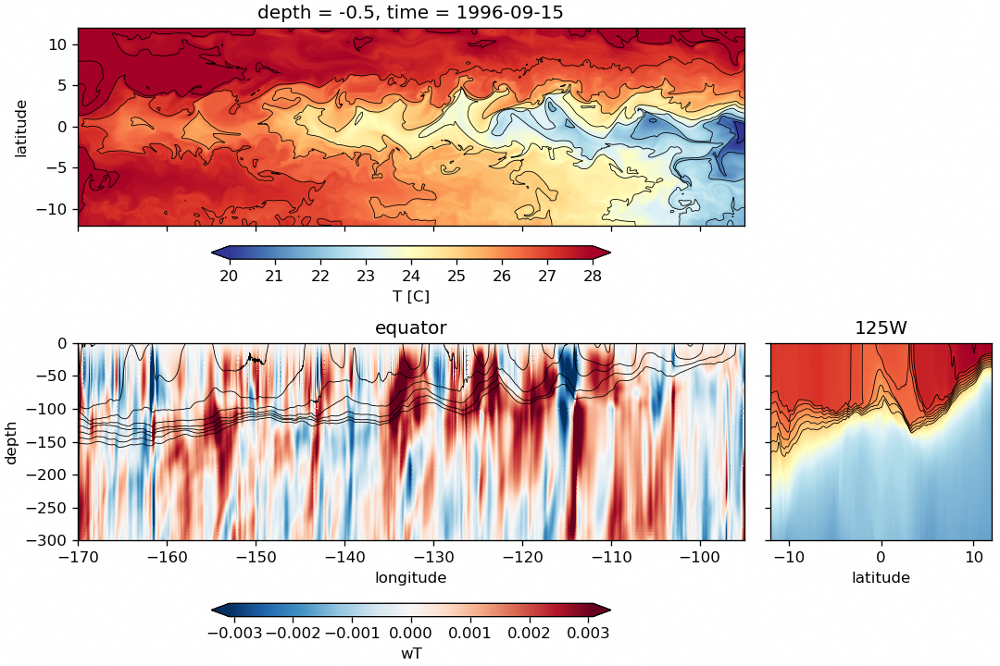

In [ ]:
def plot_timestamp(tt):

    region = dict(time=tt, method='nearest')

    f = plt.figure(constrained_layout=True)
    gs = f.add_gridspec(2, 2, width_ratios=[3, 1])
    ax = dict()
    ax['surf'] = f.add_subplot(gs[0, 0])
    ax['lonz'] = f.add_subplot(gs[1, 0], sharex=ax['surf'])
    ax['latz'] = f.add_subplot(gs[1, 1], sharey=ax['lonz'])

    ((gcm1.full.w * gcm1.full.theta).sel(**region, latitude=0)
     .plot(ax=ax['lonz'], x='longitude', robust=True, 
           cbar_kwargs={'orientation': 'horizontal', 'label': 'wT', 'shrink': 0.6}))
    (gcm1.full.theta.sel(**region, latitude=0)
     .plot.contour(ax=ax['lonz'], x='longitude', colors='k', 
                  levels=np.arange(20, 30, 1), linewidths=0.5))

    (gcm1.full.theta.sel(**region, depth=0)
     .plot(ax=ax['surf'], x='longitude', vmin=20, vmax=28, cmap=mpl.cm.RdYlBu_r,
           cbar_kwargs={'label': 'T [C]', 'orientation': 'horizontal', 'shrink': 0.6}))
    (gcm1.full.theta.sel(**region, depth=0)
     .plot.contour(ax=ax['surf'], x='longitude', colors='k', 
                  levels=np.arange(20, 30, 1), linewidths=0.5))

    (gcm1.full.theta.sel(**region, longitude=-125)
     .plot(ax=ax['latz'], x='latitude', vmin=6, vmax=28, cmap=mpl.cm.RdYlBu_r, add_colorbar=False))
    (gcm1.full.theta.sel(**region, longitude=-125)
     .plot.contour(ax=ax['latz'], x='latitude', colors='k', 
                  levels=np.arange(20, 30, 1), linewidths=0.5))

    ax['latz'].set_ylim((-300, 0))
    plt.gcf().set_size_inches((9, 6))
    ax['latz'].set_title('125W')
    ax['lonz'].set_title('equator')
    ax['latz'].set_ylabel('')
    [tt.set_visible(False) for tt in ax['latz'].get_yticklabels()]
    [tt.set_visible(False) for tt in ax['surf'].get_xticklabels()]
    ax['surf'].set_xlabel('')
    
    f.savefig('../movies/movie_T_wT/' + str(tt) + '.png', dpi=300)
    
plot_timestamp('1996-09-15')

In [ ]:
%matplotlib inline

for mm in models:
    dcpy.ts.PlotSpectrum((models[mm].tao.w * models[mm].tao.theta)
                         .sel(latitude=5, depth=80, time='1996-08-15', method='nearest'),
                         label=mm, ax=plt.gca(), preserve_area=True)
plt.gcf().set_size_inches((10, 5))
plt.gcf().legend()

/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/matplotlib/__init__.py:855: MatplotlibDeprecationWarning: 
examples.directory is deprecated; in the future, examples will be found relative to the 'datapath' directory.
  "found relative to the 'datapath' directory.".format(key))
/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/matplotlib/__init__.py:846: MatplotlibDeprecationWarning: 
The text.latex.unicode rcparam was deprecated in Matplotlib 2.2 and will be removed in 3.1.
  "2.2", name=key, obj_type="rcparam", addendum=addendum)
/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/seaborn/apionly.py:9: UserWarning: As seaborn no longer sets a default style on import, the seaborn.apionly module is deprecated. It will be removed in a future version.
  warnings.warn(msg, UserWarning)


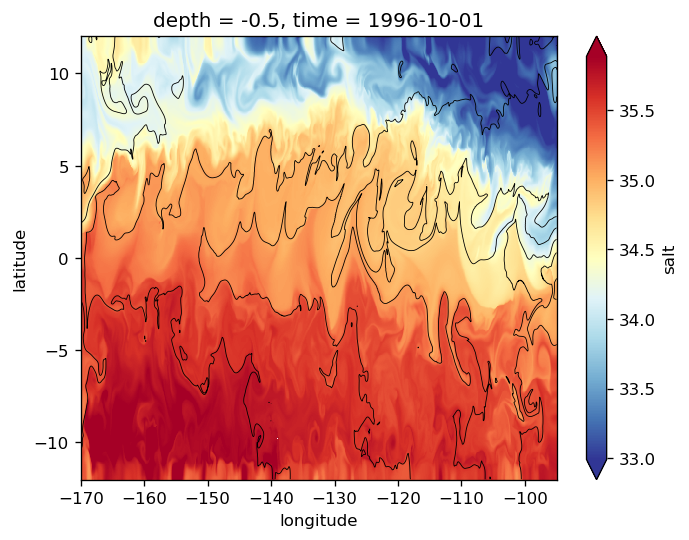

In [ ]:
gcm1.surface.salt.sel(time='1996-oct-01').plot(robust=True, cmap=mpl.cm.RdYlBu_r)
gcm1.surface.theta.sel(time='1996-oct-01').plot.contour(colors='k', levels=10, linewidths=0.5)

# TIW phase average

In [ ]:
h = (hb.surface.theta
     .hvplot(colorbar=True, groupby='time', colormap=mpl.cm.RdYlBu_r))
h.redim.range(theta=(20, 28))

:DynamicMap   [time]
   :Image   [longitude,latitude]   (theta)

## Inoue et al (2019) figure

This is a small function of averaging interval i.e. bin-size for the phase bins

In [ ]:
hb.tao = tao

In [ ]:
%matplotlib inline

ds = hb.tao.copy(deep=True)

tiw_phase = pump.calc.get_tiw_phase(ds.v.sel(latitude=0, time=slice('1996-09-01', '1996-12-22')),
                                    debug=False)

<IPython.core.display.Javascript object>


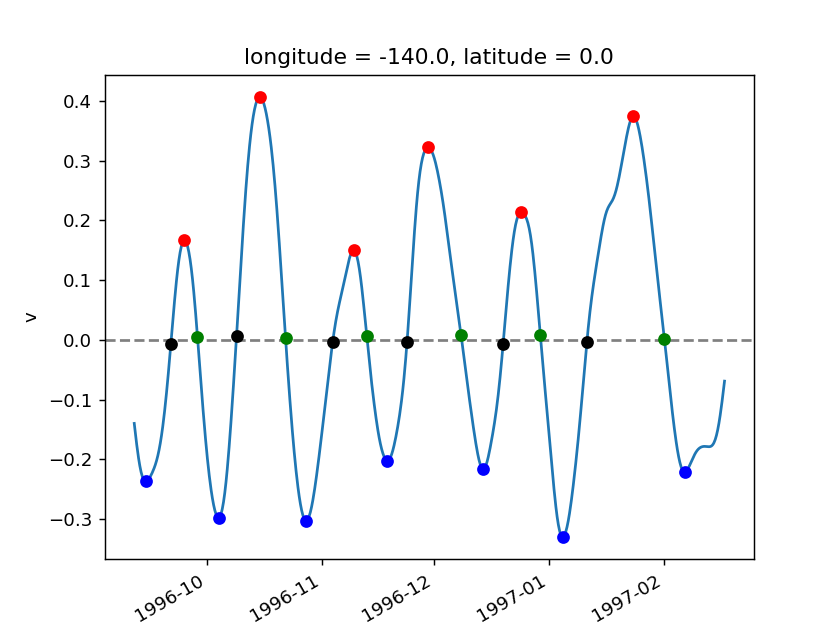

<IPython.core.display.Javascript object>


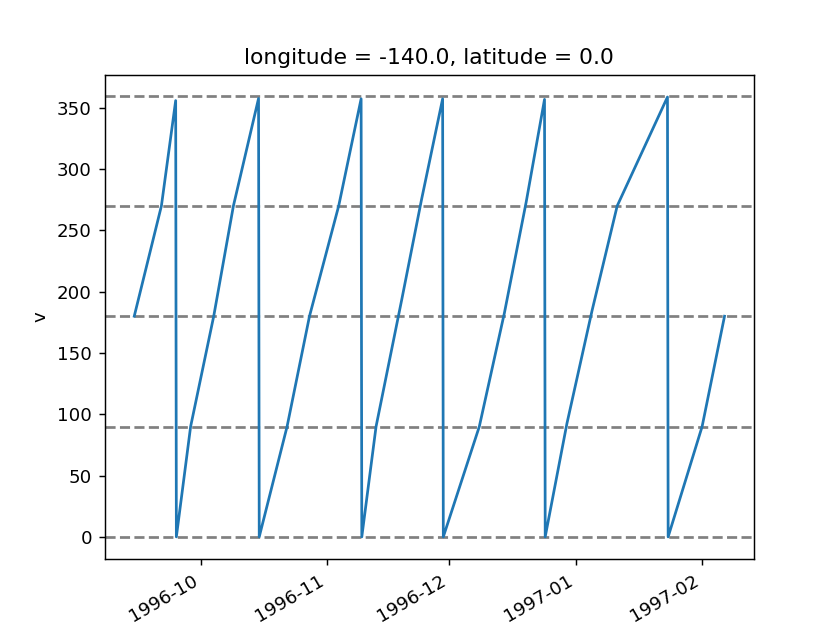

/gpfs/u/home/dcherian/python/xarray/xarray/core/nanops.py:159: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/gpfs/u/home/dcherian/python/xarray/xarray/core/nanops.py:159: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


<IPython.core.display.Javascript object>


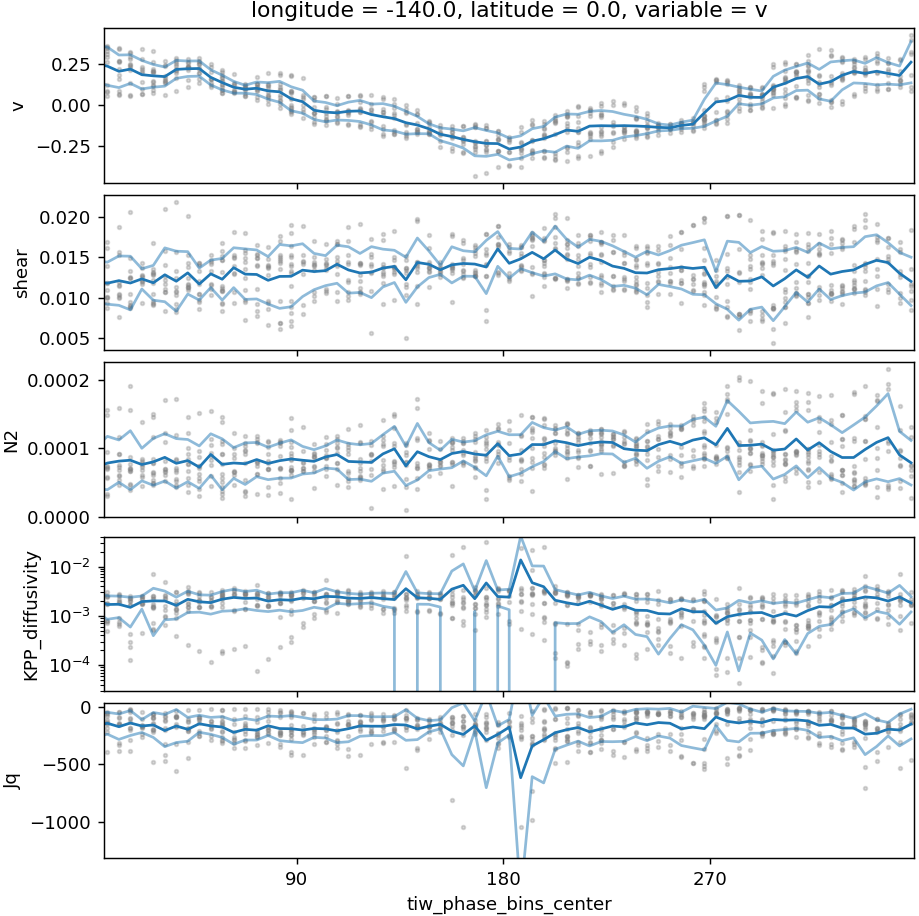

In [ ]:
ds = hb.tao.copy(deep=True)

region = dict(latitude=0, longitude=-140)
ds = ds.sel(**region)

CV = (hb.metrics.cellvol.sel(**region, method='nearest')
      .sel(depth=slice(0, -500)))

tiw_phase = pump.calc.get_tiw_phase(
    ds.v.sel(time=slice('1996-09-01', '1997-02-28')), debug=True)
ds = xr.merge([ds, tiw_phase])

ds['Jq'] = 1035 * 3999 * 10 * ds.DFrI_TH/CV  # FIX!

phase_bins = np.arange(0, 361, 5)

vertical_mean = (ds.where((ds.depth < ds.mld - 10) & (ds.depth > ds.dcl_base))
                 .mean('depth'))
tiw_phase_grouped = (vertical_mean
                     .groupby_bins('tiw_phase', bins=phase_bins))

tiw_avg = tiw_phase_grouped.mean('time')
tiw_std = tiw_phase_grouped.std('time')
tiw_err = xr.concat([(tiw_avg - tiw_std).expand_dims(dict(err=[-1])), 
                     (tiw_avg + tiw_std).expand_dims(dict(err=[1]))],
                    'err')

# tiw_avg = pump.calc.calc_reduced_shear(tiw_avg)

fg = facetgrid.facetgrid(['v', 'shear', 'N2', 'KT', 'Jq'],
                         col=['140W'],
                         sharex=True,
                         sharey=False)

for phase_bin, group in tiw_phase_grouped:
    for vv, aa in zip(['v', 'shear', 'N2', 'KPP_diffusivity', 'Jq'],
                      fg.row):
        fg.row_axes[aa][0].plot(phase_bin.mid * np.ones_like(group[vv].values), 
                                group[vv].values, ls='none',
                                marker='o', alpha=0.3, color='gray', ms=2)

for vv, aa in zip(['v', 'shear', 'N2', 'KPP_diffusivity', 'Jq'],
                  fg.row):
    tiw_avg[vv].plot(ax=fg.row_axes[aa][0], color='C0')
    tiw_err[vv].plot.line(hue='err', add_legend=False,
                          ax=fg.row_axes[aa][0], color='C0', alpha=0.5)

fg.row_axes['KT'][0].set_yscale('log')


fg.fig.set_size_inches(5, 7)

fg.axes[0, 0].set_xticks([0, 90, 180, 270, 360])
fg.clean_labels()

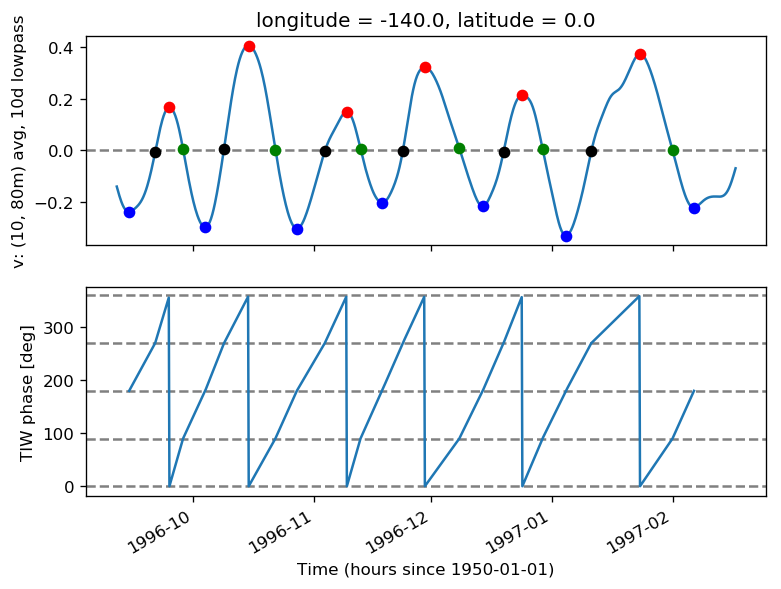

In [ ]:
tiw_phase = pump.calc.get_tiw_phase(
    hb.tao.v.sel(latitude=0, longitude=-140, time=slice('1996-09-01', '1997-02-28')), debug=True)

<IPython.core.display.Javascript object>


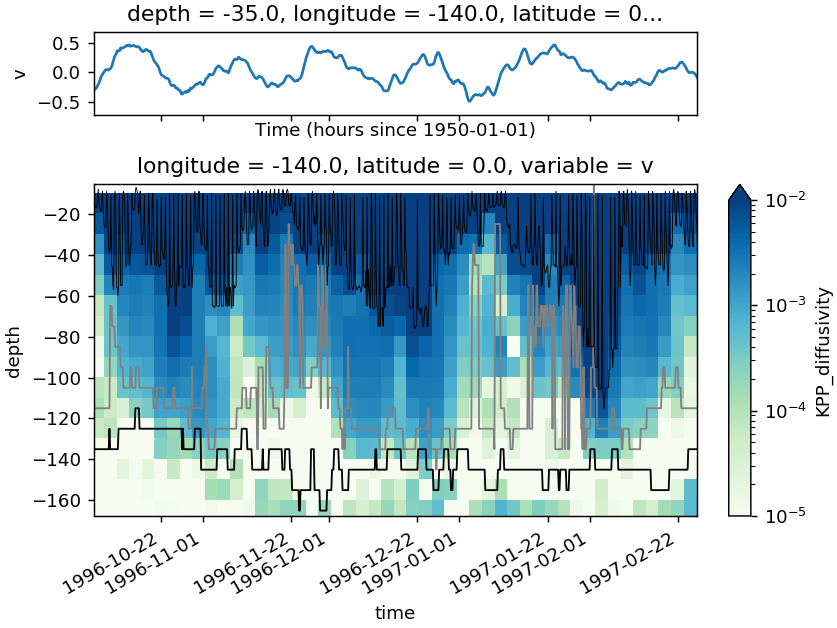

In [ ]:
%matplotlib notebook

f, ax = plt.subplots(2, 1, constrained_layout=True, 
                     sharex=True,
                     gridspec_kw={'height_ratios': [1, 4]})

ds.v.isel(depth=3).plot(ax=ax[0])
(ds.KPP_diffusivity.resample(time='3D').mean('time')
.plot(ax=ax[1], x='time', norm=mpl.colors.LogNorm(1e-5, 1e-2), cmap=mpl.cm.GnBu))

pump.plot.plot_depths(ds, ax=ax[1])

In [ ]:
import xfilter

v = xfilter.lowpass(
    ds.v.sel(depth=slice(-10, -80)).mean('depth'),
    coord='time',
    freq=1 / 10.0,
    cycles_per='D')

dvdt = v.differentiate('time')

phase = xr.zeros_like(v) * np.nan

zeros = (xr.where(
    np.abs(v) < 1e-2,
    xr.DataArray(
        np.arange(v.shape[v.get_axis_num('time')]),
        dims=['time'],
        coords={'time': v.time}),
    np.nan).dropna('time').values.astype(np.int32))

zeros_unique = zeros[np.insert(np.diff(zeros), 0, 100) > 1]

IndexError: boolean index did not match indexed array along dimension 0; dimension is 0 but corresponding boolean dimension is 1

In [ ]:
zeros = xr.where(
    np.abs(v) < 1e-2,
    xr.DataArray(
        np.arange(v.shape[v.get_axis_num('time')]),
        dims=['time'],
        coords={'time': v.time}),
    np.nan)

In [ ]:
v.dims

('time', 'longitude')

# TAO data availability

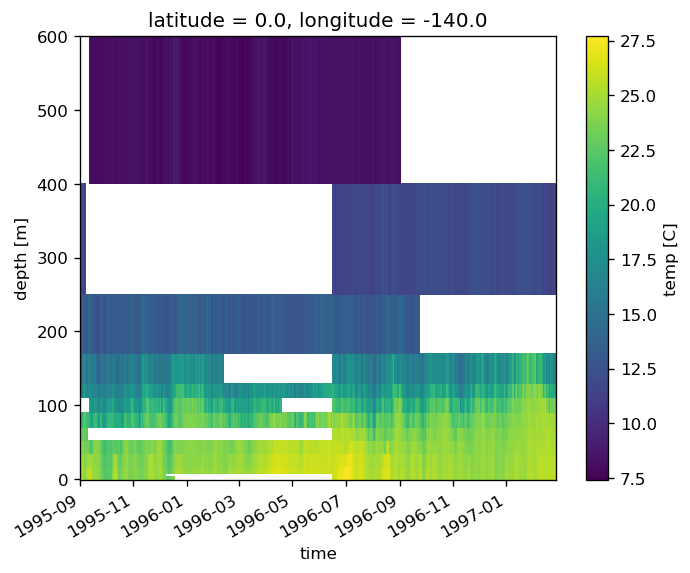

In [ ]:
tao.sel(latitude=0, longitude=-140).temp.dropna('depth', how='all').plot(x='time')

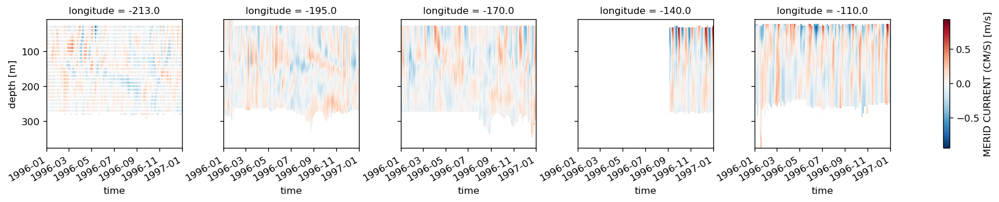

In [ ]:
adcp.v.plot(x='time', col='longitude', yincrease=False)

In [ ]:
adcp = (pump.obs.read_tao_adcp()
        .sel(time='1996')
        .dropna('longitude', how='all')
        .dropna('depth', how='all'))
adcp

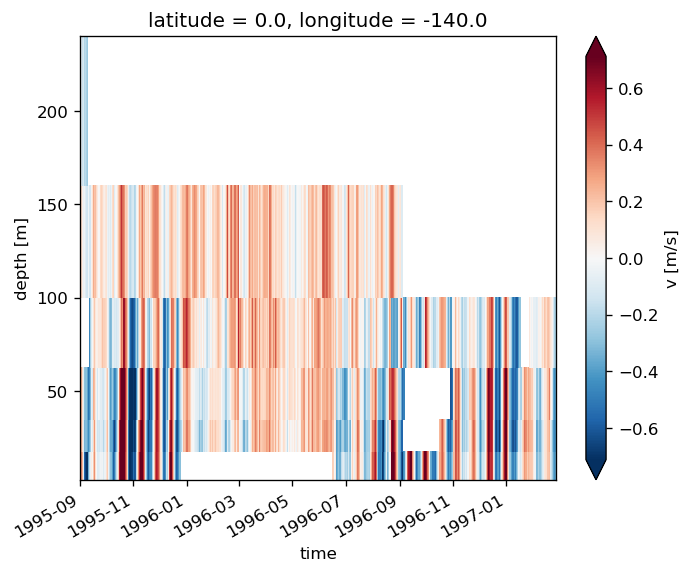

In [ ]:
tao.v.sel(latitude=0, longitude=-140).dropna('depth', how='all').plot(x='time', robust=True)

# SST Spectra

In [ ]:
import xrft.xrft as xrft

# modsst = modsst.interp_like(sst.sst)

sst_subset = sst.sst.sel(latitude=[-0.01, 2, 5, 8], method='nearest').chunk({'latitude': 1}).interpolate_na('longitude')
modsst = run_surface.theta.sel(latitude=sst_subset.latitude, method='nearest').chunk({'latitude': 1}).interpolate_na('longitude')
modsst['latitude'] = sst_subset['latitude']

kwargs = dict(detrend='constant', dim=['time', 'longitude'], window=True)

# psd = xr.Dataset()
modpsd = xrft.power_spectrum((modsst - modsst.mean(['longitude'])).interp({'longitude': sst.longitude}), **kwargs).compute()
oipsd = xrft.power_spectrum((sst_subset - sst_subset.mean(['longitude'])).chunk({'time': 546}), **kwargs).compute()
psd = xr.concat([oipsd, modpsd], dim='type')
psd['type'] = ['OISST', 'MITgcm']

psd['freq_time'] *= 86400
psd['freq_time'].attrs['long_name'] = r'$\omega$'
psd['freq_time'].attrs['units'] = 'cpd'

psd

/glade/u/home/dcherian/miniconda3/envs/analysis/lib/python3.6/site-packages/dask/array/blockwise.py:204: UserWarning: The da.atop function has moved to da.blockwise
  warnings.warn("The da.atop function has moved to da.blockwise")
/glade/u/home/dcherian/miniconda3/envs/analysis/lib/python3.6/site-packages/dask/array/blockwise.py:204: UserWarning: The da.atop function has moved to da.blockwise
  warnings.warn("The da.atop function has moved to da.blockwise")


<xarray.DataArray (type: 2, freq_time: 546, latitude: 4, freq_longitude: 300)>
array([[[[0.01011 , ..., 0.330605],
         ...,
         [0.164401, ..., 0.512871]],

        ...,

        [[0.101374, ..., 0.017101],
         ...,
         [0.122993, ..., 0.265694]]],


       [[[1.619733, ..., 2.081289],
         ...,
         [1.142138, ..., 0.778882]],

        ...,

        [[0.457258, ..., 0.038284],
         ...,
         [0.040606, ..., 0.047552]]]])
Coordinates:
  * freq_time               (freq_time) float64 -0.5 -0.4982 ... 0.4963 0.4982
  * latitude                (latitude) float32 -0.125 2.125 5.125 8.125
  * freq_longitude          (freq_longitude) float64 -2.0 -1.987 ... 1.973 1.987
    freq_time_spacing       float64 2.12e-08
    freq_longitude_spacing  float64 0.01333
  * type                    (type) <U6 'OISST' 'MITgcm'

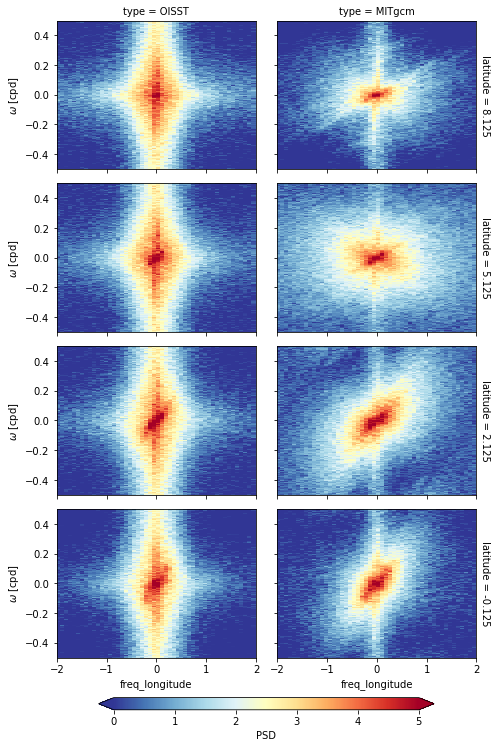

In [ ]:
%matplotlib inline

np.log10(psd.coarsen(freq_time=2, freq_longitude=6).mean()).sortby('latitude', ascending=False).plot(
    col='type', row='latitude', cmap=mpl.cm.RdYlBu_r, vmin=0, vmax=5,
    cbar_kwargs={'orientation': 'horizontal', 'shrink': 0.8, 'aspect': 25, 'pad': 0.05, 'label': 'PSD'})

(<matplotlib.lines.Line2D at 0x2b7121519f28>,
 <matplotlib.axes._subplots.AxesSubplot at 0x2b712158bba8>)

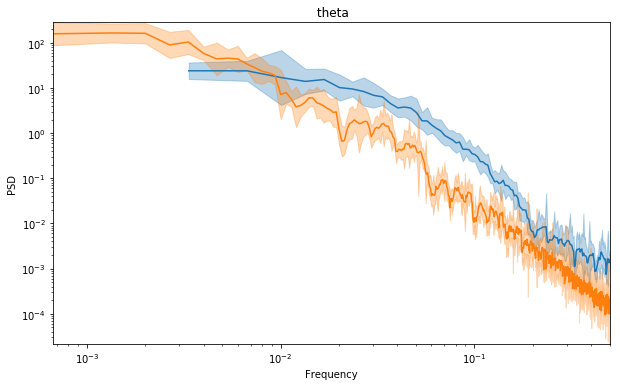

In [ ]:
import dcpy

dcpy.ts.PlotSpectrum(sst_subset.isel(time=100).sel(latitude=5.125, method='nearest'))
dcpy.ts.PlotSpectrum(modsst.isel(time=100).sel(latitude=5.125, method='nearest'), ax=plt.gca())

In [ ]:
import importlib
xr = importlib.reload(xr)

def fgmap(g, func, x=None, y=None, data=None, **kwargs):
    if x is None:
        x = g._x_var
        
    if y is None:
        y = g._y_var
        
    if data is None:
        data = g.data
        
    for d, ax in zip(g.name_dicts.flat, g.axes.flat):
        # None is the sentinel value
        if d is not None:
            subset = data.loc[d]
            func(subset, x=x, y=y, ax=ax, add_labels=False, **kwargs)

# Marginal instability in data

## TAO

In [ ]:
Ri = (pump.calc_tao_ri(adcp, tao.temp.sel(latitude=0, longitude=adcp.longitude))
      .dropna('longitude', how='all'))

eucmax = pump.get_euc_max(adcp.u)

seasonal = xr.Dataset()
seasonal['Ri'] = (Ri.groupby('time.season')
                  .median('time'))
seasonal['eucmax'] = (eucmax.groupby('time.season')
                     .median('time'))

seasonal = seasonal.reindex(season=['DJF', 'MAM', 'JJA', 'SON'])

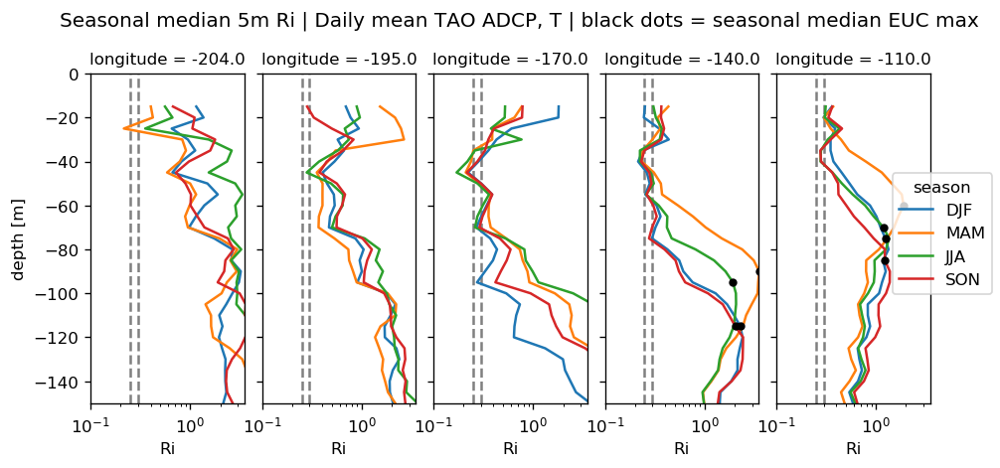

In [ ]:
%matplotlib inline

# eucmax.groupby('time.season').median('time')

fg = (seasonal.Ri
      .plot.line(col='longitude', hue='season', y='depth', 
                 ylim=[-150, 0], xlim=[0.1, 3.5], xscale='log'))
fg.map(lambda: dcpy.plots.linex([0.25, 0.3]))
for ax, gg in zip(fg.axes[0], fg.name_dicts[0]):
    subset = seasonal.sel(**gg)
    ax.plot(subset.Ri.sel(depth=subset.eucmax, method='nearest'),
            subset.eucmax, 'ko', ms=4)
    
fg.set_xlabels('Ri')
plt.gcf().suptitle('Seasonal median 5m Ri | Daily mean TAO ADCP, T | black dots = seasonal median EUC max', y=1.02)

plt.gcf().set_size_inches((8, 4))
# plt.gcf().savefig('../images/seasonal-Ri-tao.png')

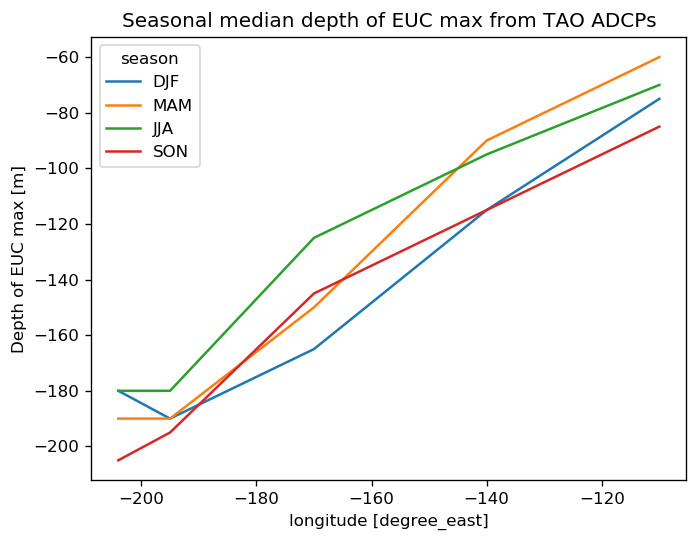

In [ ]:
seasonal.eucmax.plot.line(hue='season')
plt.title('Seasonal median depth of EUC max from TAO ADCPs')
plt.savefig('../images/tao-adcp-euc-max-seasonal-median.png')

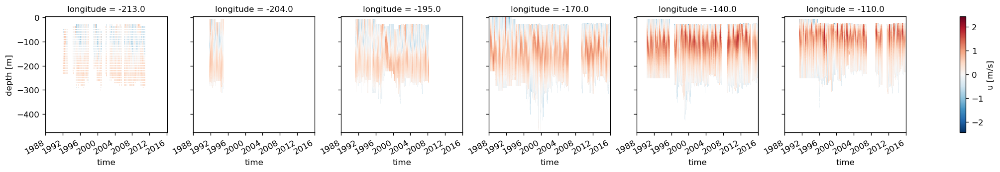

In [ ]:
adcp.u.plot(col='longitude', x='time')

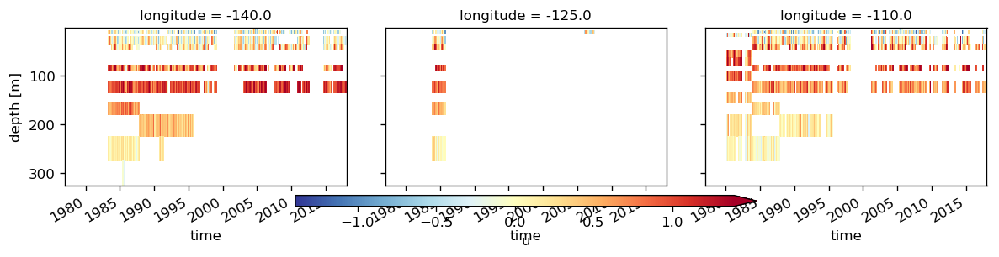

In [ ]:
%matplotlib inline

(u.sel(latitude=0, longitude=[-140, -125, -110])
 .dropna('depth', how='all')
 .resample(time='W').mean('time')
 .plot(col='longitude', y='depth', yincrease=False, robust=True, cmap=mpl.cm.RdYlBu_r,
       cbar_kwargs=dict(orientation='horizontal', pad=0.05, aspect=40, shrink=0.5)))

## Johnson et al (2002)

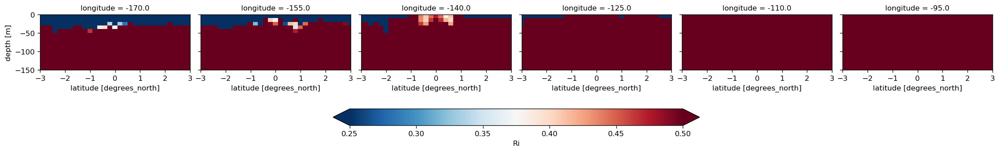

In [ ]:
%matplotlib inline

johnson['N2'] = -9.81 / 1025 * johnson.rho.differentiate('depth')
johnson['shear2'] = johnson['u'].differentiate('depth')**2
johnson['Ri'] = johnson.N2 / johnson['shear2']
cmap = mpl.cm.RdBu_r
(johnson.Ri).sel(longitude=slice(-170, -95)).plot(
    col='longitude',
    cmap=mpl.cm.RdBu_r,
    vmin=0.25,
    vmax=0.5,
    ylim=(-150, 0),
    xlim=(-3, 3),
    cbar_kwargs={
        'orientation': 'horizontal',
        'pad': 0.35
    })

# Velocity field

In [ ]:
if 'monthly_mean_ssu' not in locals():
    oscari = oscar.u.sel(time='1996').interp(latitude=mitgcm.latitude, longitude=mitgcm.longitude)
    monthly_mean_ssu = xr.concat([dd.drop('depth').resample(time='M').mean('time') 
                                  for dd in [oscari, mitgcm.surface.u.sel(time='1996')]], 
                                  dim='type').compute()
monthly_mean_ssu['type'] = ['OSCAR', 'MITgcm 1/20']
    
monthly_mean_ssu

monthly_mean_ssu.to_netcdf(mitgcm.dirname + '/monthly_mean_ssu.nc')

/gpfs/u/home/dcherian/python/xarray/xarray/core/nanops.py:159: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


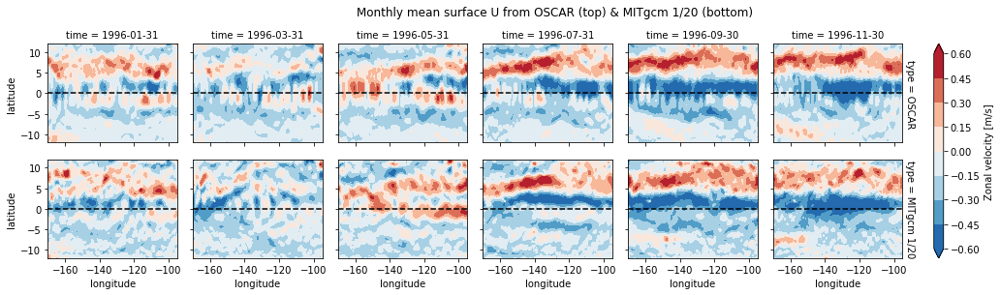

In [ ]:
levels = np.arange(-0.65, 0.65, 0.2)

g = (monthly_mean_ssu.sel(time=slice(None, None, 2))
     .plot.contourf(levels=10, robust=True, row='type', col='time', aspect=2, figsize=(16, 4),
                    cmap=mpl.cm.RdBu_r, cbar_kwargs={'pad': 0.03, 'label': 'Zonal velocity [m/s]'}))
g.cbar.set_ticks(g._mappables[-1].levels)
#g.map_dataarray(xr.plot.contour, x='longitude', y='latitude', levels=levels, linewidths=0.5, colors='k', add_colorbar=False)
#g.cbar.add_lines(g._mappables[-1])

g.map(lambda: plt.axhline(0, color='k', ls='--'))
plt.gcf().suptitle('Monthly mean surface U from OSCAR (top) & MITgcm 1/20 (bottom)', y=1.05)

plt.gcf().savefig('../images/monthly-mean-ssu.png', dpi=200)

# Temperature field

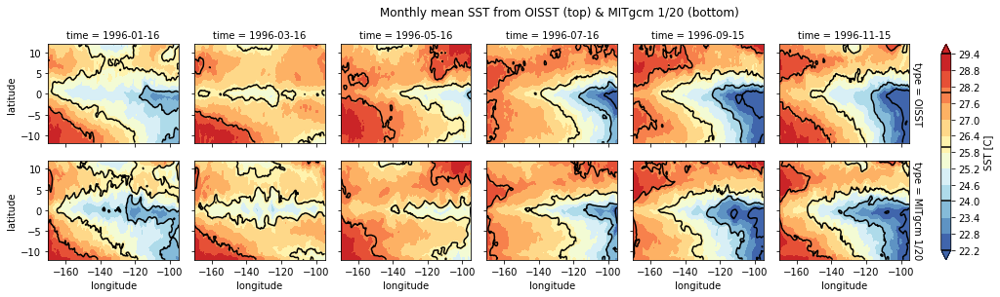

In [ ]:
if 'monthly_mean_sst' not in locals():
    ssti = sst.sst.chunk({'time': 100}).interp(latitude=mitgcm.surface.latitude, 
                                               longitude=mitgcm.surface.longitude).compute()

    merged = xr.concat([ssti, mitgcm.surface.theta], dim='type')
    
    monthly_mean_sst = merged.sel(time='1996').resample(time='M', loffset='-15D').mean('time')
    
monthly_mean_sst['type'] = ['OISST', 'MITgcm 1/20']

levels = np.arange(22, 31, 2)
g = (monthly_mean_sst.sel(time=slice(None, None, 2))
     .plot.contourf(levels=13, robust=True, row='type', col='time', aspect=2, figsize=(16, 4),
                    cmap=mpl.cm.RdYlBu_r, cbar_kwargs={'pad': 0.03, 'label': 'SST [C]'}))
g.cbar.set_ticks(g._mappables[-1].levels)
g.map_dataarray(xr.plot.contour, x='longitude', y='latitude', levels=levels, colors='k', add_colorbar=False)
g.cbar.add_lines(g._mappables[-1])

plt.gcf().suptitle('Monthly mean SST from OISST (top) & MITgcm 1/20 (bottom)', y=1.05)

plt.gcf().savefig('../images/monthly-mean-sst.png', dpi=200)

<xarray.Dataset>
Dimensions:     (latitude: 481, longitude: 1501, time: 516)
Coordinates:
    s_rho       float64 ...
  * time        (time) datetime64[ns] 1984-09-02T12:00:00 ... 1986-01-30T12:00:00
  * latitude    (latitude) float64 -12.0 -11.95 -11.9 -11.85 ... 11.9 11.95 12.0
  * longitude   (longitude) float64 -170.0 -170.0 -169.9 ... -95.1 -95.05 -95.0
Data variables:
    u           (time, latitude, longitude) float64 ...
    v           (time, latitude, longitude) float64 ...
    theta       (time, latitude, longitude) float32 ...
    theta_anom  (time, latitude, longitude) float32 ...
Attributes:
    file:                      /glade/scratch/dwhitt/tpos20/OUT/ocean_avg_tpo...
    format:                    netCDF-3 64bit offset file
    Conventions:               CF-1.4, SGRID-0.3
    type:                      ROMS/TOMS nonlinear model averages file
    title:                     TPOS 1/20deg
    var_info:                  /glade/p/nsc/ncgd0043/tpos_ROMS_runs_setup_scr...
   

In [ ]:
%time mitgcm.oisst = pump.read_sst(mitgcm.domain['xyt']).interp(latitude=mitgcm.latitude, longitude=mitgcm.longitude).compute()
%time roms.oisst = pump.read_sst(roms.domain['xyt']).interp(latitude=roms.latitude, longitude=roms.longitude).compute()

CPU times: user 3.81 s, sys: 9.77 s, total: 13.6 s
Wall time: 26.4 s
CPU times: user 7.15 s, sys: 25.4 s, total: 32.6 s
Wall time: 51.2 s


In [ ]:
roms.validate_sst()

AttributeError: 'model' object has no attribute 'validate_sst'

(<matplotlib.lines.Line2D at 0x2b50858a8f28>,
 <matplotlib.axes._subplots.AxesSubplot at 0x2b508520aa90>)

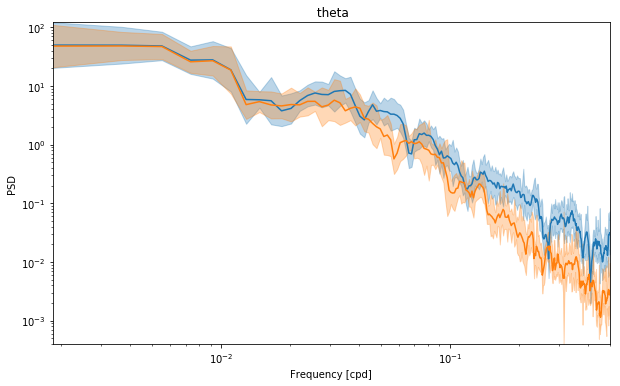

In [ ]:
dcpy.ts.PlotSpectrum(sst.sst.sel(latitude=2, longitude=-140, method='nearest'))
dcpy.ts.PlotSpectrum(mitgcm.surface.theta.sel(latitude=2, longitude=-140, method='nearest'), ax=plt.gca())

(<matplotlib.lines.Line2D at 0x2b50952a0f60>,
 <matplotlib.axes._subplots.AxesSubplot at 0x2b5087349e10>)

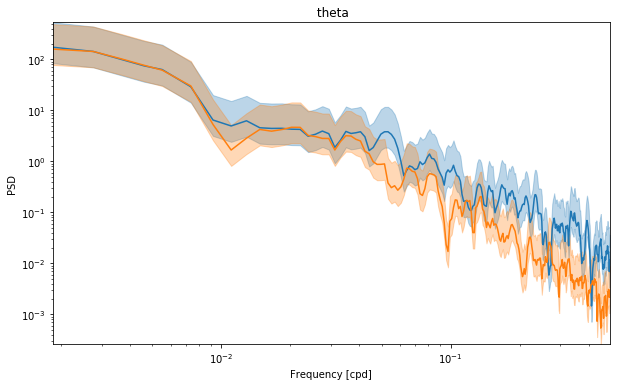

In [ ]:
dcpy.ts.PlotSpectrum(sst.sst.sel(latitude=2, longitude=-140, method='nearest'), multitaper=False, decimate=False)
dcpy.ts.PlotSpectrum(mitgcm.surface.theta.sel(latitude=2, longitude=-140, method='nearest'), ax=plt.gca(), multitaper=False, decimate=False)

NameError: name 'run' is not defined

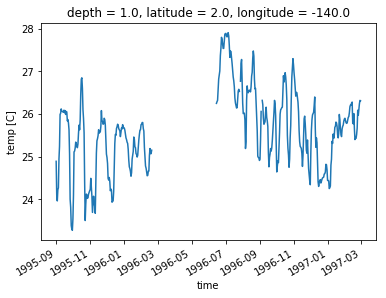

In [ ]:
tao.sel(latitude=2, longitude=-140, depth=0, method='nearest').temp.plot()
run.theta.sel(latitude=2, longitude=-140, depth=0, method='nearest').plot()

# Johnson comparison

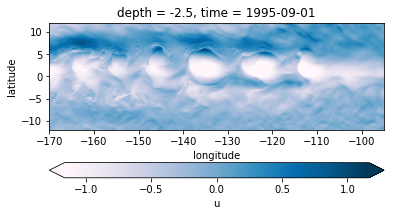

In [ ]:
mitgcm.full.u.isel(depth=0, time=0).plot(robust=True, cmap=mpl.cm.PuBu, cbar_kwargs={'orientation': 'horizontal'})
plt.gca().set_aspect(1)

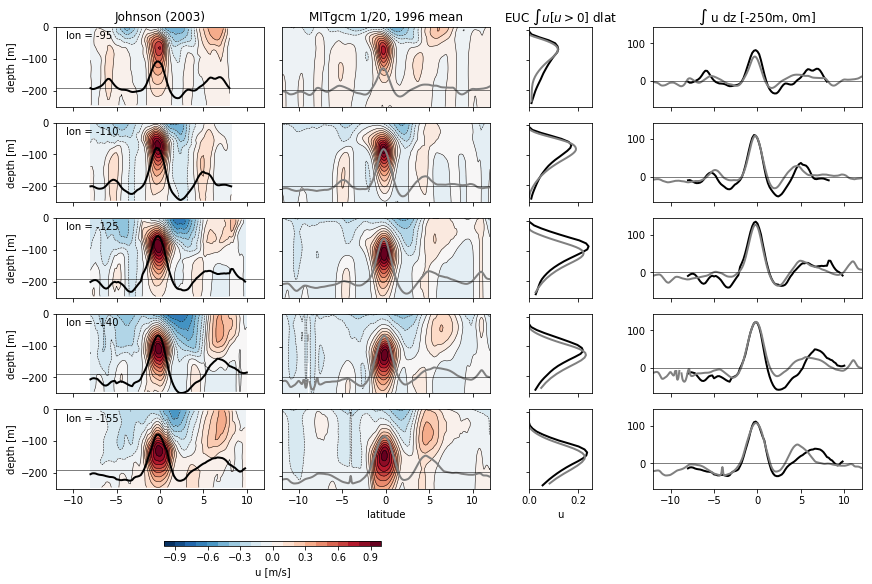

In [ ]:
run_section_mean = mitgcm.johnson.load()

kwargs = dict(vmin=-1, vmax=1, add_colorbar=False, cmap=mpl.cm.RdBu_r, center=0, levels=21)
kwargs2 = kwargs.copy()
kwargs2.pop('cmap')
kwargs2['linewidths'] = 0.5
kwargs2['colors'] = 'k'

cntr_kwargs = dict(levels=np.arange(10, 30, 2), colors='k', linewidths=0.5)
fmt = {'johnson': dict(lw=2, color='k'), 'mit': dict(lw=2, color='gray')}

#interp_mean = run_section_mean.interp(depth=johnson.depth, latitude=johnson.latitude)

f, ax = plt.subplots(5, 4, sharex='col', sharey='col', constrained_layout=True,
                     gridspec_kw={'width_ratios': [1, 1, 0.3, 1]})
f.set_size_inches((12, 8))

def get_euc_transport(u):
    euc = u.where(u > 0).sel(latitude=slice(-3, 3, None))
    euc.values[np.isnan(euc.values)] = 0
    euc = euc.integrate('latitude') * 0.1
    
    return (euc)

for idx, lon in enumerate(section_lons):
    ujohn = johnson.u.sel(longitude=lon, method='nearest').sel(depth=slice(0, -250))
    umit = mitgcm.johnson.u.sel(longitude=lon, method='nearest').sel(depth=slice(0, -250))
    
    (ujohn.plot.contourf(ax=ax[idx, 0], **kwargs)) 
    (ujohn.plot.contour(ax=ax[idx, 0], **kwargs2))
    #(johnson.temp
    # .sel(longitude=lon, method='nearest')
    # .plot.contour(ax=ax[idx, 0], **cntr_kwargs))
    (get_euc_transport(ujohn)
     .plot(y='depth', ax=ax[idx, 2], **fmt['johnson']))
    for ii, aa in enumerate(ax[idx, [3, 0]]):
        aa.plot(ujohn.latitude, -190*ii - (1)*ujohn.integrate('depth'), **fmt['johnson'])
    
    hsec = (umit.plot.contourf(ax=ax[idx, 1], **kwargs))
    (umit.plot.contour(ax=ax[idx, 1], **kwargs2))
    #(run_section_mean.theta.sel(longitude=lon, method='nearest')
    # .plot.contour(ax=ax[idx, 1], **cntr_kwargs))
    
    (get_euc_transport(umit)
     .plot(y='depth', ax=ax[idx, 2], **fmt['mit']))
    for ii, aa in enumerate(ax[idx, [3, 1]]):
        aa.plot(umit.latitude, -190*ii - (1)*umit.integrate('depth'), **fmt['mit'])
        
    #hdiff = (((interp_mean.u.sel(longitude=lon, method='nearest')
    #              - johnson.u.sel(longitude=lon, method='nearest'))/
    #             johnson.u.where(np.abs(johnson.u) > 0.1).sel(longitude=lon, method='nearest') * 100)
    #           .plot(ax=ax[idx, 2], cmap=mpl.cm.RdBu_r, center=0, vmin=-100, vmax=100,
    #                 add_colorbar=False))
    
    ax[idx, 0].text(0.05, 0.85, 'lon = ' + str(lon), transform=ax[idx, 0].transAxes)
    [aa.set_title('') for aa in ax[idx, :]]
    [aa.axhline(-190, color='k', lw=0.5, zorder=10) for aa in ax[idx, :2]]
    ax[idx, 3].axhline(0, color='k', lw=0.5, zorder=10)
    [aa.set_ylabel('') for aa in ax[idx, 1:]]
    
ax[0, 0].set_title('Johnson (2003)')
ax[0, 1].set_title('MITgcm 1/20, 1996 mean')
ax[0, 2].set_title(r'EUC $\int u[u>0]$ dlat')
ax[0, 3].set_title(r'$\int$ u dz [-250m, 0m]')

[aa.set_xlabel('') for aa in ax.flat[:-3]]
ax.flat[0].set_ylim([-250, 0])

[aa.set_xlim([-12, 12]) for aa in ax[0, [0, 1, 3]]]
ax[0,2].set_xlim([0, None])

for aa in np.hstack((ax[:, 1], ax[:,2])):
    aa.set_yticklabels([])
    
cbar_kwargs = dict(aspect=15, extend='both', orientation='horizontal')
f.colorbar(hsec, ax=ax[:, :2], shrink=0.5, label='u [m/s]', **cbar_kwargs)
# f.colorbar(hdiff, ax=ax[:, 2], shrink=0.7, label='%', **cbar_kwargs)

f.savefig('../images/mitgcm-20-johnson-depth-sections.png', dpi=200)

In [ ]:
johnson = pump.read_johnson().load()

Text(0.5, 1.05, 'Time-mean depth-longitude zonal velocity sections | Johnson (top), MITgcm 1/20 (bottom)')

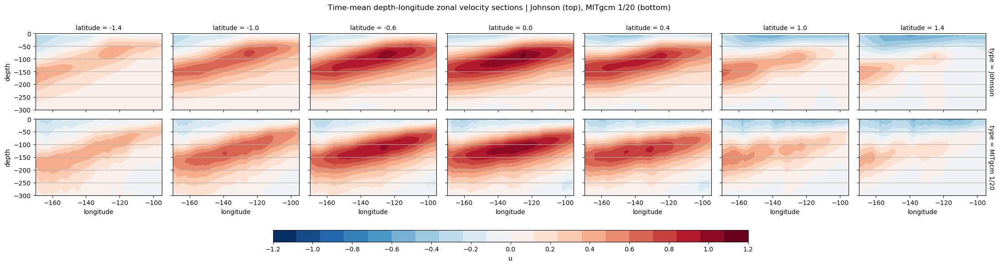

In [ ]:
levels = np.linspace(-1, 1, 17)

j1 = (johnson.u.sel(latitude=np.arange(-1.5, 1.6, 0.5), method='nearest'))
m1 = mitgcm.mean.u.sel(latitude=j1.latitude, method='nearest')
m1['latitude'] = j1.latitude

rm = roms.mean.u.sel(latitude=j1.latitude, method='nearest')
rm['latitude'] = j1.latitude

merged = xr.concat([j1.interp(longitude=m1.longitude, depth=m1.depth), 
                    m1], dim='type')
merged['type'] = ['Johnson', 'MITgcm 1/20']

fg = merged.plot.contourf(x='longitude', col='latitude', row='type', levels=21, vmin=-1.2, vmax=1.2, 
                          ylim=[-300, 0], cmap=mpl.cm.RdBu_r,
                          cbar_kwargs=dict(orientation='horizontal', aspect=40, shrink=0.5))

[aa.grid(True, axis='y') for aa in fg.axes.flat]
fg.cbar.set_ticks(np.arange(-1.2, 1.21, 0.2))


fg.fig.suptitle('Time-mean depth-longitude zonal velocity sections | Johnson (top), MITgcm 1/20 (bottom)', y=1.05)

# plt.gcf().savefig('../images/mitgcm-20-johnson-longitude-depth-section.png')

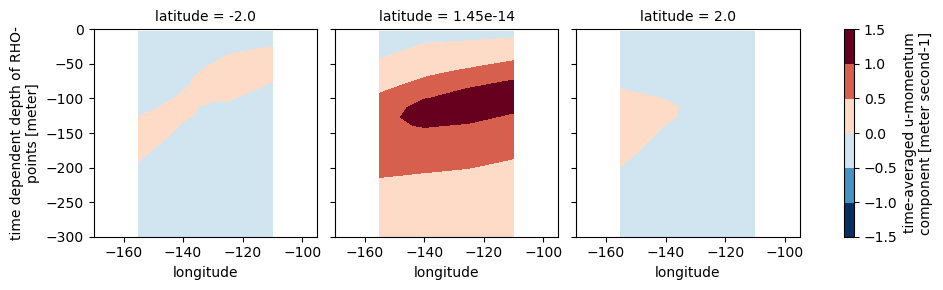

In [ ]:
(roms.johnson.u.isel(time=1).sel(latitude=[-2, 0, 2], method='nearest')
 .plot.contourf(x='longitude', y='depth', ylim=[-300, 0], col='latitude'))

In [ ]:
oscar = dcpy.oceans.read_oscar('../glade/obs/oscar/').rename({'lat': 'latitude', 'lon': 'longitude'})
oscar.sel(time='1996').sel(**mitgcm.domain['xyt'])

<xarray.Dataset>
Dimensions:    (latitude: 73, longitude: 0, time: 72)
Coordinates:
    depth      float32 15.0
  * latitude   (latitude) float64 -12.0 -11.67 -11.33 -11.0 ... 11.33 11.67 12.0
  * longitude  (longitude) float64 
  * time       (time) datetime64[ns] 1996-01-01 1996-01-06 ... 1996-12-26
Data variables:
    u          (time, latitude, longitude) float64 dask.array<shape=(72, 73, 0), chunksize=(72, 73, 0)>
    v          (time, latitude, longitude) float64 dask.array<shape=(72, 73, 0), chunksize=(72, 73, 0)>
Attributes:
    VARIABLE:       Ocean Surface Currents
    DATATYPE:       1/72 YEAR Interval
    DATASUBTYPE:    unfiltered
    GEORANGE:       20 to 420 -80 to 80
    PERIOD:         Jan.01,1995 to Dec.26,1995
    year:           1995
    description:    OSCAR Third Degree Sea Surface Velocity
    CREATION_DATE:  16:00 04-Apr-2017
    version:        2017.0
    source:         Kathleen Dohan, ESR (kdohan@esr.org)
    contact:        Kathleen Dohan (kdohan@esr.org)
  

In [ ]:
gcm

NameError: name 'gcm' is not defined

Text(0.5, 0, '[Sv]')

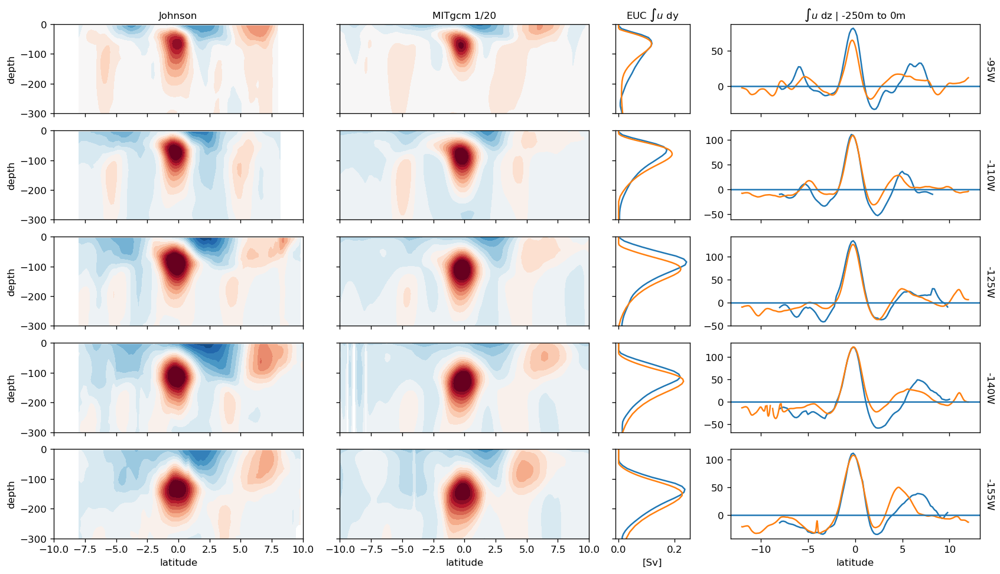

In [ ]:
%matplotlib inline

import facetgrid

mitgcm = models['gcm']

fg = facetgrid.facetgrid(
    col=['john', 'mit', 'inty', 'intz'],
    row=np.round(mitgcm.johnson.longitude).astype(np.int),
    sharex='col', sharey='none',
    gridspec_kw={'width_ratios': [1, 1, 0.3, 1]},
    plot_kwargs=dict(xlim=[-10, 10], ylim=[-300, 0],
                     levels=20, vmin=-0.8, vmax=0.8, cmap=mpl.cm.RdBu_r))
fg.map_col('john', johnson.u, xr.plot.contourf, x='latitude', y='depth')
# fg.map_col('roms', roms.johnson.u)
fg.map_col('mit', mitgcm.johnson.u)

for var in [johnson, mitgcm.johnson]:
    fg.map_col('inty', pump.calc.get_euc_transport(var.u), xr.plot.line,
               x=None, y='depth', defaults=False, _labels=False, ylim=[-300, 0])

for var in [johnson, mitgcm.johnson]:
    fg.map_col('intz', -1*var.u.sel(depth=slice(0, -250)).integrate('depth'), xr.plot.line,
               x='latitude', y=None, defaults=False, _labels=False)

fg.map_col('intz', None, plt.axhline, y=0)
fg.set_col_labels(col_names=['Johnson', 
                             'MITgcm 1/20', 
                             r'EUC $\int u$ dy', 
                             r'$\int u$ dz | -250m to 0m'], 
                  template='{value}')
fg.set_row_labels(template='{value}W')
fg.set_xlabels('latitude')
fg.set_ylabels('depth')
fg.clean_ticklabels(col=['mit', 'inty'])
fg.fig.set_constrained_layout_pads()
fg.fig.set_size_inches(14, 8)
fg.col_axes['inty'][-1].set_xlabel('[Sv]')

Now for all models but only profiles

In [ ]:
cluster.close()

distributed.utils - ERROR - 
Traceback (most recent call last):
  File "/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/distributed/utils.py", line 654, in log_errors
    yield
  File "/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/distributed/client.py", line 873, in _reconnect
    yield self._ensure_connected()
  File "/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/tornado/gen.py", line 1133, in run
    value = future.result()
  File "/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/tornado/gen.py", line 1147, in run
    yielded = self.gen.send(value)
  File "/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/distributed/client.py", line 904, in _ensure_connected
    assert len(msg) == 1
AssertionError
distributed.utils - ERROR - 
Traceback (most recent call last):
  File "/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/distributed/utils.py", l

# TAO Comparison

In [ ]:
tao_temp = tao.temp.load()

In [ ]:
tao.temp.load()

In [ ]:
mitgcm.tao.load()

In [ ]:
import dcpy.ts

f, axx = plt.subplots(len(tao.longitude), len(tao.latitude), sharex=True, sharey=True, constrained_layout=True)

for ilon, lon in enumerate(tao.longitude):
    for ilat, lat in enumerate(tao.latitude):
        
        ax = axx[ilon, ilat]
        
        region = dict(longitude=lon, latitude=lat, depth=0, method='nearest')
        
        # if run.theta.sel(**region).count() > 180:
        #    dcpy.ts.PlotSpectrum(run.theta.sel(**region), ax=ax)
        
        ts = tao.temp.sel(**region).interpolate_na('time')
        
        if ts.count() > 100:            
            dcpy.ts.PlotSpectrum(ts, ax=ax)
        
        if ilon == len(tao.longitude):
            ax.text(1, 0.5, 'lat = ' + str(lat), transform=ax.transAxes, rotation=270, va='center', ha='center')
            
        if ilat == len(tao.latitude):
            ax.set_xlabel('lon = ' + str(lon))

# OISST Comparison

/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/matplotlib/__init__.py:855: MatplotlibDeprecationWarning: 
examples.directory is deprecated; in the future, examples will be found relative to the 'datapath' directory.
  "found relative to the 'datapath' directory.".format(key))
/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/matplotlib/__init__.py:846: MatplotlibDeprecationWarning: 
The text.latex.unicode rcparam was deprecated in Matplotlib 2.2 and will be removed in 3.1.
  "2.2", name=key, obj_type="rcparam", addendum=addendum)
/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/seaborn/apionly.py:9: UserWarning: As seaborn no longer sets a default style on import, the seaborn.apionly module is deprecated. It will be removed in a future version.
  warnings.warn(msg, UserWarning)


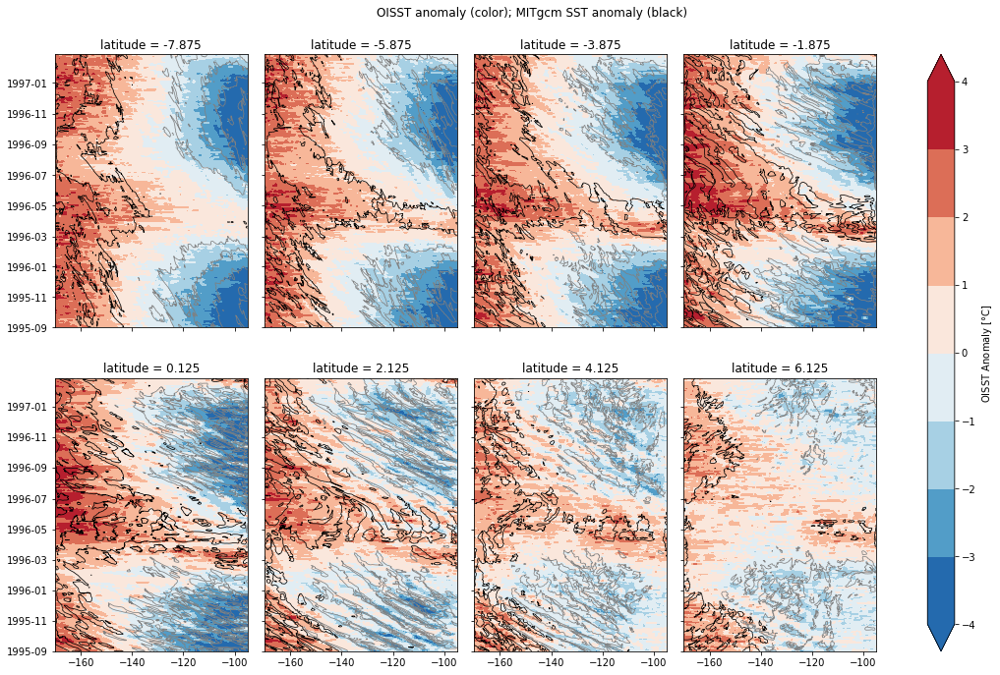

In [ ]:
g = (sst.anom.sel(latitude=np.arange(-8, 8, 2), method='nearest')
     .plot.contourf(col='latitude', col_wrap=4, y='time', levels=9, robust=True, cmap=mpl.cm.RdBu_r))

for axis, region in zip(g.axes.flat, g.name_dicts.flat):
    
    if region is None:
        continue
        
    title = axis.get_title()
        
    (run_surface.theta_anom.where(run_surface.theta_anom > 0).sel(**region, method='nearest')
     .plot.contour(ax=axis, levels=g.cbar.get_ticks(), colors='k', linewidths=0.75))
    (run_surface.theta_anom.where(run_surface.theta_anom <= 0).sel(**region, method='nearest')
     .plot.contour(ax=axis, levels=g.cbar.get_ticks(), colors='gray', linestyles='-', linewidths=0.75))
    
    axis.set_xlabel(''); axis.set_ylabel(''); axis.set_title(title)
    
g.fig.set_size_inches(16, 10)
g.fig.suptitle('OISST anomaly (color); MITgcm SST anomaly (black)', y=1.01)

g.fig.savefig('../images/validation/oisst-comparison.png', dpi=200, bbox_inches='tight')

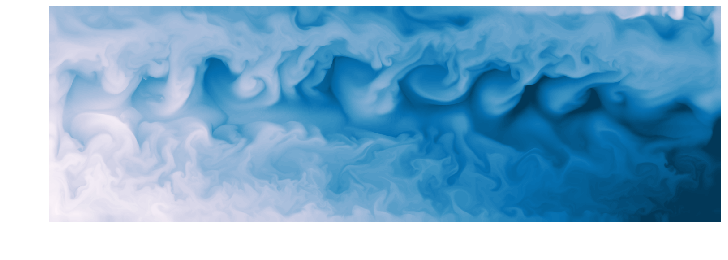

In [ ]:
f, ax = plt.subplots(1, 1, constrained_layout=True)
hdl = run_surface.theta_anom.isel(time=100).plot(levels=90,  cmap=mpl.cm.PuBu_r, robust=True, add_colorbar=False);
# run_surface.theta_anom.isel(time=100).plot.contour(levels=20, colors='gray', alpha=0.5, linestyles='-', linewidths=0.5);
plt.gca().set_aspect(1)
plt.gcf().set_size_inches((10, 6))
plt.gca().set_axis_off()
plt.gca().set_title('')
plt.gcf().canvas.draw()
plt.gcf().savefig('../images/sst.png', dpi=200, bbox_inches='tight', transparent=True)

In [ ]:
tao.u.depth

<xarray.DataArray 'depth' (depth: 75)>
array([1.00e+00, 1.50e+00, 2.00e+00, 3.00e+00, 5.00e+00, 8.00e+00, 9.00e+00,
       1.00e+01, 1.10e+01, 1.30e+01, 1.50e+01, 2.00e+01, 2.50e+01, 2.60e+01,
       2.80e+01, 3.00e+01, 3.30e+01, 3.50e+01, 3.70e+01, 4.00e+01, 4.50e+01,
       4.80e+01, 4.90e+01, 5.00e+01, 5.10e+01, 5.30e+01, 5.70e+01, 6.00e+01,
       6.20e+01, 7.00e+01, 7.50e+01, 7.60e+01, 8.00e+01, 8.20e+01, 8.30e+01,
       8.70e+01, 1.00e+02, 1.01e+02, 1.02e+02, 1.03e+02, 1.12e+02, 1.20e+02,
       1.23e+02, 1.25e+02, 1.32e+02, 1.37e+02, 1.40e+02, 1.50e+02, 1.51e+02,
       1.53e+02, 1.60e+02, 1.70e+02, 1.75e+02, 1.80e+02, 1.82e+02, 1.83e+02,
       2.00e+02, 2.01e+02, 2.03e+02, 2.25e+02, 2.45e+02, 2.50e+02, 2.75e+02,
       2.80e+02, 2.85e+02, 3.00e+02, 4.00e+02, 4.20e+02, 4.45e+02, 4.50e+02,
       4.70e+02, 5.00e+02, 7.50e+02, 1.00e+03, 2.00e+03])
Coordinates:
  * depth    (depth) float64 1.0 1.5 2.0 3.0 5.0 ... 500.0 750.0 1e+03 2e+03
Attributes:
    FORTRAN_format:  
    units

In [ ]:
gcm_tao = (mitgcm.full.sel(longitude=[-170, -155, -140, -125, -110, -95], 
                           latitude=[-8, -5, -2, 0, 2, 5, 8], 
                           method='nearest')
           .sel(depth=slice(0, -500)))

gcm_tao['latitude'].values = np.array([-8, -5, -2, 0, 2, 5, 8]) * 1.0
gcm_tao['longitude'].values = np.array([-170, -155, -140, -125, -110, -95]) * 1.0
%time gcm_tao.to_netcdf(mitgcm.dirname + '/obs_subset/tao-extract.nc')

CPU times: user 1min 28s, sys: 5.78 s, total: 1min 33s
Wall time: 18min 50s


In [ ]:
mitgcm.tao = xr.open_dataset(mitgcm.dirname + '/obs_subset/tao-extract.nc')

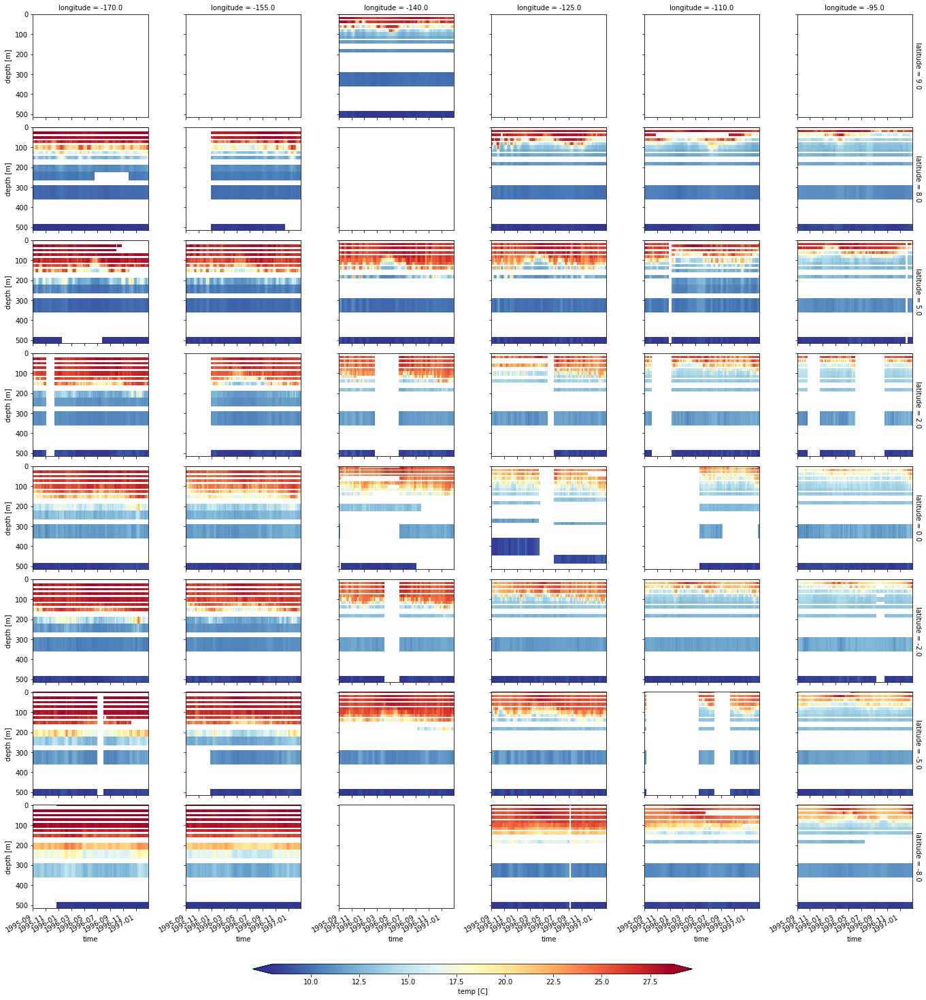

In [ ]:
(tao.temp
 .dropna('depth', how='all').dropna('latitude', how='all').dropna('longitude', how='all')
 .sortby('latitude', ascending=False)
 .plot(row='latitude', col='longitude', y='depth', yincrease=False, robust=True, cmap=mpl.cm.RdYlBu_r,
       cbar_kwargs=dict(orientation='horizontal', pad=0.05, aspect=40, shrink=0.5)))

In [ ]:
(tao.temp
 .dropna('depth', how='all').dropna('latitude', how='all').dropna('longitude', how='all')
 .sortby('latitude', ascending=False)
 .plot(row='latitude', col='longitude', y='depth', yincrease=False, robust=True, cmap=mpl.cm.RdYlBu_r,
       cbar_kwargs=dict(orientation='horizontal', pad=0.05, aspect=40, shrink=0.5)))

In [ ]:
tao = pump.read_tao(mitgcm.domain['xyt'])

tao_subset = (tao.v.drop(9, 'latitude')
              .dropna('depth', how='all').dropna('latitude', how='all').dropna('longitude', how='all')
              .sortby('latitude', ascending=False))

fg = (tao_subset.sel(depth=100, method='nearest').dropna('time', how='all')
      .plot(aspect=2, col='longitude', x='time'))

KeyboardInterrupt: 

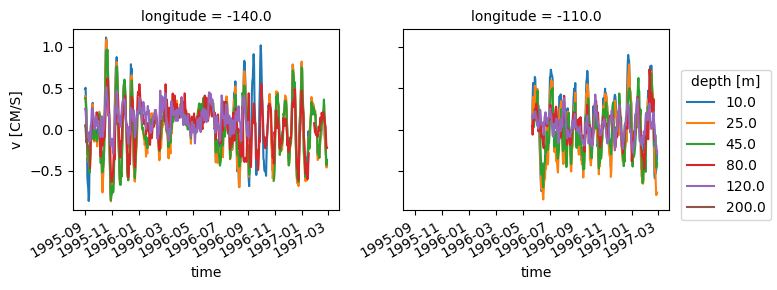

In [ ]:
tao_subset.squeeze().plot.line(hue='depth', col='longitude')

In [ ]:
%time tao.temp.load()
%time mitgcm.tao.load()

CPU times: user 148 ms, sys: 72.3 ms, total: 221 ms
Wall time: 4.44 s
CPU times: user 25 µs, sys: 0 ns, total: 25 µs
Wall time: 29.1 µs


<xarray.Dataset>
Dimensions:  ()
Data variables:
    *empty*

In [ ]:
with mpl.rc_context({'font.size': 12}):
    fg = xr.plot.FacetGrid(tao_subset.sel(depth=100, method='nearest'), sharey='none', row='latitude', col='longitude')

    for ax, name in zip(fg.axes.flat, fg.name_dicts.flat):
        if tao_subset.loc[name].count() > 100:
            taovec = tao_subset.sel(depth=100).loc[name]
            taovec.values = dcpy.ts.FillGaps(taovec, maxlen=30)

            h0 = dcpy.ts.PlotSpectrum(taovec, preserve_area=True, ax=ax)
            h1 = dcpy.ts.PlotSpectrum(mitgcm.tao.theta.sel(depth=-100, method='nearest').loc[name].isel(time=slice(0, -1))
                                      .where(~np.isnan(taovec.values)), ax=ax, preserve_area=True)
            
            ax.set_ylim((0, ax.get_ylim()[1]/2))
            #ax.set_xlim((0.08, None))
        ax.text(0.98, 0.98, '({latitude}, {longitude})'.format(**name), ha='right', va='top', transform=ax.transAxes)

    [aa.set_ylabel('') for aa in fg.axes[:, 1:].flat]
    [aa.set_xlabel('') for aa in fg.axes[:-1, :].flat]
    [aa.set_title('') for aa in fg.axes[1:, :].flat]
    # fg.axes[0, 0].set_ylim([0, 5])

    fg._finalize_grid('frequency [cpd]', 'PSD x freq')

    fg.fig.suptitle('Variance preserving multitaper PSD of 100m temperature | Gaps in the same places | interpolate over 30 day gaps', y=1.05)

    fg.axes[0, 2].legend(handles=[h0[0], h1[0]], labels=['TAO', 'MITgcm 1/20'], loc='center right')

    fg.fig.set_size_inches((16, 9))
    
fg.fig.savefig('../images/validation-mitgcm20-tao-100m-temp-spectra-var-preserve.png', dpi=200)

In [ ]:
import seawater as sw

model = mitgcm

tao140 = model.tao.sel(latitude=0, longitude=-140, method='nearest').load()

tao140 = calc_reduced_shear(tao140)

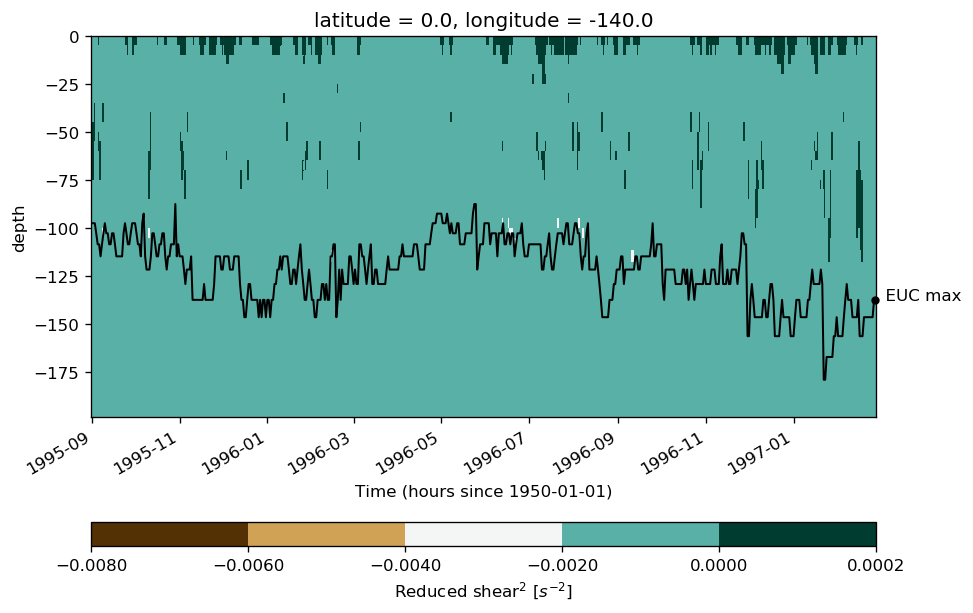

In [ ]:
shrednorm = mpl.colors.BoundaryNorm(boundaries=[-0.008, -0.006, -0.004, -0.002, 0, 0.0002],
                                    ncolors=5, clip=False)

zumax = tao140.depth.isel(depth=tao140.u.argmax('depth'))

plt.figure(constrained_layout=True)
(tao140.shred2).sel(depth=slice(0, -200)).plot(
    x='time',
    cmap=mpl.cm.BrBG,
    norm=shrednorm,
    cbar_kwargs={'orientation': 'horizontal'})

hdl = zumax.plot(x='time', color='k', lw=1.2)
dcpy.plots.annotate_end(hdl[0], 'EUC max')
plt.gcf().set_size_inches((8, 5))

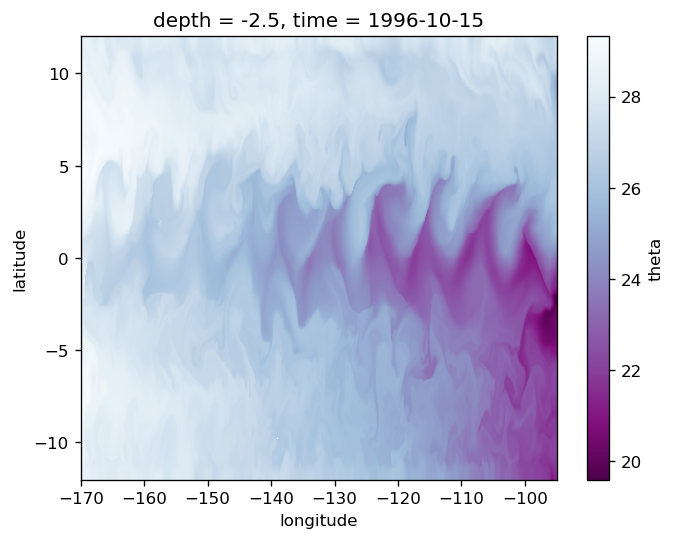

In [ ]:
mitgcm.surface.theta.sel(time='15-Oct-1996').plot(cmap=mpl.cm.BuPu_r)

oct15 = mitgcm.full.sel(time='15-Oct-1996', method='nearest')

In [ ]:
%time oct15.load()

CPU times: user 816 ms, sys: 2.52 s, total: 3.34 s
Wall time: 3.55 s


<xarray.Dataset>
Dimensions:    (depth: 100, latitude: 480, longitude: 1500)
Coordinates:
  * depth      (depth) float32 -2.5 -7.5 -12.5 ... -5644.034 -5744.034 -5844.034
  * latitude   (latitude) float32 -12.0 -11.949896 -11.899791 ... 11.949896 12.0
  * longitude  (longitude) float32 -170.0 -169.94997 ... -95.05003 -95.0
    time       datetime64[ns] 1996-10-15
Data variables:
    salt       (depth, latitude, longitude) float32 35.187782 ... 34.681046
    theta      (depth, latitude, longitude) float32 28.41874 ... 1.2917594
    u          (depth, latitude, longitude) float32 -0.17678952 ... nan
    v          (depth, latitude, longitude) float32 0.018486695 ... nan
    w          (depth, latitude, longitude) float32 nan nan nan ... nan nan nan
Attributes:
    title:              daily snapshot from 1/100 degree Tasman Sea MITgcm si...
    easting:            longitude
    northing:           latitude
    field_julian_date:  400296
    julian_day_unit:    days since 1950-01-01 00:00:

In [ ]:
oct15 = pump.calc_reduced_shear(oct15)
oct15

<xarray.Dataset>
Dimensions:    (depth: 100, latitude: 480, longitude: 1500)
Coordinates:
  * depth      (depth) float32 -2.5 -7.5 -12.5 ... -5644.034 -5744.034 -5844.034
  * latitude   (latitude) float32 -12.0 -11.949896 -11.899791 ... 11.949896 12.0
  * longitude  (longitude) float32 -170.0 -169.94997 ... -95.05003 -95.0
    time       datetime64[ns] 1996-10-15
Data variables:
    salt       (depth, latitude, longitude) float32 35.187782 ... 34.681046
    theta      (depth, latitude, longitude) float32 28.41874 ... 1.2917594
    u          (depth, latitude, longitude) float32 -0.17678952 ... nan
    v          (depth, latitude, longitude) float32 0.018486695 ... nan
    w          (depth, latitude, longitude) float32 nan nan nan ... nan nan nan
    shear      (depth, latitude, longitude) float32 0.003018351 ... nan
    dens       (depth, latitude, longitude) float32 1022.398 ... 1027.774
    N2         (depth, latitude, longitude) float32 1.6940383e-05 ... 2.3366043e-08
    shred2   

Text(0.5, 0.98, 'MITgcm 1/20 Reduced shear$^2$ + $\\rho$ contours (daily average)')

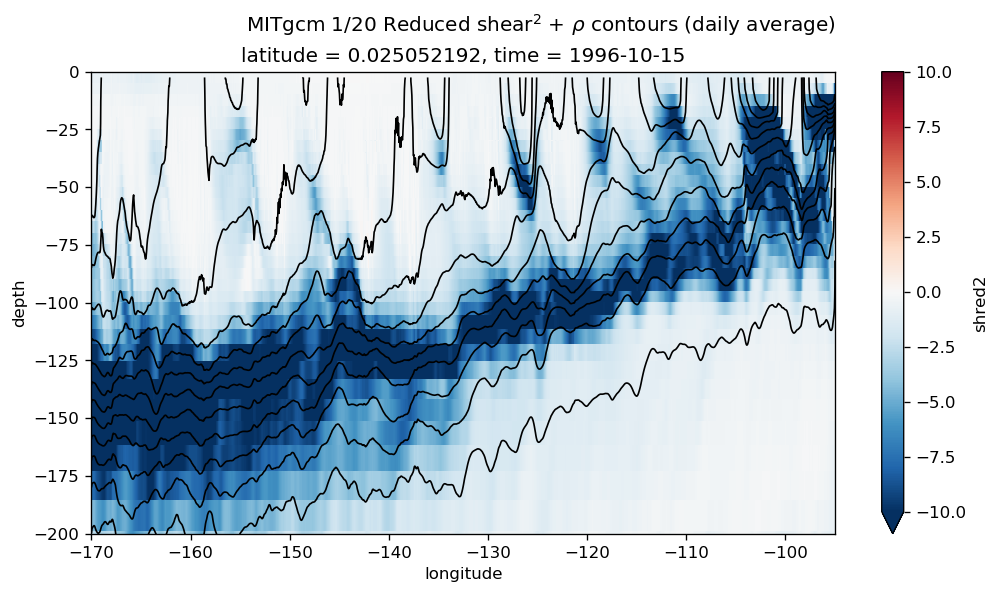

In [ ]:
shrednorm = mpl.colors.BoundaryNorm(boundaries=[-0.006, -0.004, -0.002, 0, 0.0002],
                                    ncolors=5, clip=False)

(oct15.shred2*1e4).sel(latitude=0, method='nearest').plot(cmap=mpl.cm.RdBu_r, y='depth', ylim=[-200, 0], 
                                                          vmin=-10, vmax=10)
oct15.dens.sel(latitude=0, method='nearest').plot.contour(colors='k', linewidths=1, levels=20)
plt.gcf().set_size_inches((10, 5))
plt.gcf().suptitle(r'MITgcm 1/20 Reduced shear$^2$ + $\rho$ contours (daily average)')

In [ ]:
new = pump.model.model('../glade/TPOS_MITgcm_1/HOLD/', 'gcm', full=True)

Reading all files took 20.626479864120483 seconds


In [ ]:
new.full

<xarray.Dataset>
Dimensions:    (depth: 345, latitude: 480, longitude: 1500, time: 546)
Coordinates:
  * latitude   (latitude) float32 -12.0 -11.949896 -11.899791 ... 11.949896 12.0
  * longitude  (longitude) float32 -170.0 -169.94997 ... -95.05003 -95.0
  * depth      (depth) float32 -0.5 -1.5 -2.5 ... -5565.922 -5665.922 -5765.922
  * time       (time) datetime64[ns] 1995-09-01 1995-09-02 ... 1997-02-27
Data variables:
    theta      (time, depth, latitude, longitude) float32 dask.array<shape=(546, 345, 480, 1500), chunksize=(1, 345, 480, 1500)>
    u          (time, depth, latitude, longitude) float32 dask.array<shape=(546, 345, 480, 1500), chunksize=(1, 345, 480, 1500)>
    v          (time, depth, latitude, longitude) float32 dask.array<shape=(546, 345, 480, 1500), chunksize=(1, 345, 480, 1500)>
    w          (time, depth, latitude, longitude) float32 dask.array<shape=(546, 345, 480, 1500), chunksize=(1, 345, 480, 1500)>
    salt       (time, depth, latitude, longitude) float32 d

In [ ]:
new.full = new.full.chunk({'longitude': 1})
new.full

<xarray.Dataset>
Dimensions:    (depth: 345, latitude: 480, longitude: 1500, time: 546)
Coordinates:
  * latitude   (latitude) float32 -12.0 -11.949896 -11.899791 ... 11.949896 12.0
  * longitude  (longitude) float32 -170.0 -169.94997 ... -95.05003 -95.0
  * depth      (depth) float32 -0.5 -1.5 -2.5 ... -5565.922 -5665.922 -5765.922
  * time       (time) datetime64[ns] 1995-09-01 1995-09-02 ... 1997-02-27
Data variables:
    theta      (time, depth, latitude, longitude) float32 dask.array<shape=(546, 345, 480, 1500), chunksize=(1, 345, 480, 1)>
    u          (time, depth, latitude, longitude) float32 dask.array<shape=(546, 345, 480, 1500), chunksize=(1, 345, 480, 1)>
    v          (time, depth, latitude, longitude) float32 dask.array<shape=(546, 345, 480, 1500), chunksize=(1, 345, 480, 1)>
    w          (time, depth, latitude, longitude) float32 dask.array<shape=(546, 345, 480, 1500), chunksize=(1, 345, 480, 1)>
    salt       (time, depth, latitude, longitude) float32 dask.array<sh

In [ ]:
mean = new.full.sel(time='1996').mean('time')
mean

<xarray.Dataset>
Dimensions:    (depth: 345, latitude: 480, longitude: 1500)
Coordinates:
  * latitude   (latitude) float32 -12.0 -11.949896 -11.899791 ... 11.949896 12.0
  * longitude  (longitude) float32 -170.0 -169.94997 ... -95.05003 -95.0
  * depth      (depth) float32 -0.5 -1.5 -2.5 ... -5565.922 -5665.922 -5765.922
Data variables:
    theta      (depth, latitude, longitude) float32 dask.array<shape=(345, 480, 1500), chunksize=(345, 480, 1)>
    u          (depth, latitude, longitude) float32 dask.array<shape=(345, 480, 1500), chunksize=(345, 480, 1)>
    v          (depth, latitude, longitude) float32 dask.array<shape=(345, 480, 1500), chunksize=(345, 480, 1)>
    w          (depth, latitude, longitude) float32 dask.array<shape=(345, 480, 1500), chunksize=(345, 480, 1)>
    salt       (depth, latitude, longitude) float32 dask.array<shape=(345, 480, 1500), chunksize=(345, 480, 1)>

In [ ]:
mean.u.data.visualize()

RuntimeError: Drawing dask graphs requires the `graphviz` python library and the `graphviz` system library to be installed.

In [ ]:
mean.nbytes/1e9

4.9680093

In [ ]:
mean = mean.load()

In [ ]:
mean.to_netcdf(new.dirname + '/obs_subset/new-mean.nc')

distributed.utils_perf - WARNING - full garbage collections took 26% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 28% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 29% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took